In [ ]:
#| default_exp process

# process

>Image processing submodule

In [ ]:
# %pylab inline
%load_ext autoreload
%autoreload 2

In [ ]:
#| hide
from nbdev.showdoc import *
from nbdev import *

In [ ]:
#| local
import configparser
from fastcore.basics import patch
from os.path import expanduser
from astroquery.astrometry_net import AstrometryNet
from astroquery.exceptions import TimeoutError as ASTTimeoutError
from osob.core import Telescope
from osob.solver import Solver

from IPython import display

import time
from datetime import datetime
import os
from requests import session
from bs4 import BeautifulSoup
from io import StringIO, BytesIO
from zipfile import ZipFile
from astropy.io import fits
from astropy.coordinates import SkyCoord, Longitude, Latitude
import astropy.units as u
from astropy.wcs import WCS
from astropy.io import fits
from astropy.visualization import simple_norm
from astroquery.vizier import Vizier
from tqdm.auto import tqdm
import matplotlib as mpl
from matplotlib import pyplot as plt
from matplotlib.path import Path
import numpy as np
from photutils.detection import DAOStarFinder
from astropy.stats import sigma_clipped_stats

from sqlitedict import SqliteDict

from astropy.visualization import make_lupton_rgb

import astroalign as aa
from collections import namedtuple
from osob.aavso import get_VS_sequence

In [ ]:
plt.rcParams['image.cmap'] = 'gray'

In [ ]:
#| local
config = configparser.ConfigParser()
config.read(expanduser('~/.config/telescope.ini'))

['/home/jochym/.config/telescope.ini']

In [ ]:
#| local
OSO=Telescope(config['telescope.org']['user'], 
              config['telescope.org']['password'])

In [ ]:
#| local
ast = AstrometryNet()
ast.api_key = config['astrometry.net']['apikey']
solver = Solver(config['astrometry.net']['apikey'])

In [ ]:
Job = namedtuple('Job', 'jid rid done')

In [ ]:
DB = SqliteDict('telescope.sqlite', autocommit=True)
VSdb = SqliteDict('vstars.sqlite', autocommit=True)

In [ ]:
VSdb['BE Vul']

{'jobs': {382519, 383109}, 'seq': (None, None)}

In [ ]:
#| local
for vs in VSdb.items():
    if 'seq' in vs[1] and vs[1]['seq'] and vs[1]['seq'][0] and vs[1]['seq'][1]:
        print(vs[0], len(vs[1]['jobs']) )
    else :
        # print(vs)
        pass

AS Lac 1
GO Lac 1
V661 Lac 1
S Ori 30
V921 Ori 30
V2844 Ori 30
EU Cyg 22
V1997 Cyg 22
V2092 Cyg 22
khi Cyg 22
IN Cyg 16
V1278 Cyg 16
V1280 Cyg 37
V1990 Cyg 16
LV Cyg 30
LX Cyg 30
LY Cyg 19
V681 Cyg 30
V2657 Cyg 27
V686 Cyg 38
V1288 Cyg 25
V1993 Cyg 38
SS Cyg 51
CH Cyg 52
V2365 Cyg 52
V1223 Sgr 13
EQ Lyr 50
V588 Lyr 50
ST Vul 24
CF Vul 24
V605 Ori 5
V607 Ori 5
V608 Ori 5
V2754 Ori 5
SW Vul 45
DQ Vul 45
V433 Vul 45
V434 Vul 45
V452 Vul 45
V498 Vul 45
V571 Vul 45
DX Vul 49
BI Her 62


In [ ]:
def make_color_image(layers, black=1.0, Q=5, stretch=200, mults=(0.95, 1.0, 1.0)):
    r, g, b = (m*l for m,l in zip(mults,layers))
    
    try :
        r_r, r_f = aa.register(r, g, detection_sigma=10)
    except TypeError:
        r_r = r
        
    try :
        b_r, b_f = aa.register(b, g, detection_sigma=10)
    except TypeError:
        b_r = b
        
    minlev = np.array([sigma_clipped_stats(l, sigma=3.0)[1] for l in (r,g,b)])
    return make_lupton_rgb(0.9*r_r, g, b_r, minimum=black*minlev, Q=Q, stretch=stretch)

In [ ]:
verts = [
    (0, 0.5),
    (0.3, 0.5),
    (0.7, 0.5),
    (1, 0.5),
]
verts = verts + [(y, x) for x, y in verts]
verts = [(y-0.5, x-0.5) for x, y in verts]
codes = 4*[Path.MOVETO, Path.LINETO]
marker = Path(verts, codes)

In [ ]:
#| export
def plot_sequence(vs):
    if vs in VSdb:
        seq = VSdb[vs]['seq']
        if not seq[0]:
            return
    ax = plt.gca()
    ax.text(0, 0, seq[0], color='C1')
    for s in seq[1]:
        print(s)
        dx = 20/3600
        ax.plot(s[3], s[5], marker=marker, lw=1, color='C2', ms=30, transform=ax.get_transform('world'))
        ax.text(s[3]+dx, s[5]-dx, s[1], color='white', transform=ax.get_transform('world'))

In [ ]:
def process_job(jid, reprocess=False, cls=True, layer=None):
    job = OSO.get_job(jid)
    ctime = job['completion']
    req = OSO.get_request(int(job['rid'].split()[0][1:]))
    target = req['name'].lstrip().rstrip()
    print(f'jid {jid}: ({target})')
    print(f'{" ".join(ctime)}')
    z = OSO.get_obs(job, cube=False, verbose=False)    
    hdul=[fits.open(BytesIO(z.read(name)))[0] for name in z.namelist()]
    if layer is not None:
        hdul=[hdul[layer]]
    # hdul = fits.open(OSO.get_obs(job, cube=True, verbose=False))
    print(f'Filters: {tuple(hdu.header["FILTER"] for hdu in hdul)}')
    if not reprocess and jid in DB :
        print('Done')
        if cls:
            display.clear_output(wait=True);
        return
    hi = min(1, len(hdul)-1)
    # hi = 0
    wcs_head = solver.solve(hdul[hi], tout=120)
    if not wcs_head:
        print('Cannot solve image')
        OSO.get_obs(job, cube=True, verbose=False)
        data = hdul[hi].data[:-32,:-32]
        plt.imshow(data, norm=simple_norm(data, 'asinh', asinh_a=0.01))
        plt.show();
        return
    w = WCS(wcs_head)
    box = w.calc_footprint()
    c = box.mean(axis=0)
    s = box.max(axis=0) - box.min(axis=0)
    result = Vizier.query_region(catalog='B/gcvs', 
                                 coordinates=SkyCoord(*c, unit='deg', frame='fk5'), 
                                 width=f'{s[0]}deg', height=f'{s[1]}deg')
#     for g in result:
#         for n, o in enumerate(g):
#             if 'Name' in o.keys():
#                 name = o['Name']
#             elif 'GCVS' in o.keys():
#                 name = ' '.join(o['GCVS'].split())
#             elif 'NSV' in o.keys():
#                 name = f'NSV_{o["NSV"]}'

#             print(f'{name:12} {o["magMax"]:6.2f}', o)
    ax = plt.subplot(projection=w)
    plt.grid(color='white', ls='solid')
    for g in result:
        print(g)
        for n, o in enumerate(g):
            if 'Name' in o.keys():
                name = o['Name']
            elif 'GCVS' in o.keys():
                name = ' '.join(o['GCVS'].split())
            elif 'NSV' in o.keys():
                name = f'NSV_{o["NSV"]}'
            else :
                name = f'VS_{n}'
            if name.startswith('V0'):
                name = 'V'+name[2:]
            if name in VSdb:
                jobl = VSdb[name]
            else :
                jobl = {}
                jobl['jobs']=set()
            jobl['jobs'] |= {jid}
            VSdb[name]=jobl
            try :
                frame='icrs'
                try :
                    radec = SkyCoord(o['RAJ2000'] + o['DEJ2000'], 
                                     frame=frame, unit=(u.hourangle, u.deg))
                except ValueError:
                    radec = SkyCoord(o['RAJ2000'], o['DEJ2000'], 
                                     frame=frame, unit=(u.deg, u.deg))                    
            except KeyError:
                    radec =  SkyCoord(o['_RA.icrs'] + o['_DE.icrs'], 
                                     frame='icrs', unit=(u.hourangle, u.deg))
                    frame='icrs'
#                     radec =  SkyCoord(o['RAB1950'] + o['DEB1950'], 
#                                      frame='fk4', unit=(u.hourangle, u.deg))
            ax.plot(radec.ra.deg, radec.dec.deg, marker=marker, color='C1', ms=30,
                    transform=ax.get_transform('world'), )#edgecolor='yellow', facecolor='none')
            ax.text(radec.ra.deg+0.012, radec.dec.deg-0.012, f'{name} ({o["magMax"]:.1f})', 
                    transform=ax.get_transform('world'), color='white')
            if name.lstrip().rstrip().lower() == target.lower():
                plot_sequence(target)
                
    if cls :
        display.clear_output(wait=True)
        print(f'jid {jid}: ({target})')
        print(f'{" ".join(ctime)}')
        print(f'Filters: {tuple(hdu.header["FILTER"] for hdu in hdul)}')

    try :
        if len(hdul)==3:
            plt.imshow(make_color_image([hdu.data[:-32,:-32] for hdu in hdul]))
        else :
            data = hdul[hi].data[:-32,:-32]
            plt.imshow(data, norm=simple_norm(data, 'asinh', asinh_a=0.01))
    except aa.MaxIterError:
        data = hdul[hi].data[:-32,:-32]
        plt.imshow(data, norm=simple_norm(data, 'asinh', asinh_a=0.01))
    DB[jid]=Job(jid, [int(rid[1:]) for rid in job['rid'].split()], True)
    plt.show()
    display.display(plt.gcf());    

In [ ]:
def analyse_job(jid, rid=None, reprocess=False):
    job = OSO.get_job(jid)
    ctime = job['completion']
    if rid is None:
        rid=int(job['rid'].split()[0][1:])
    req = OSO.get_request(rid)
    target = req['name'].lstrip().rstrip()
    print(f'J{jid}:R{rid} ({target}) {" ".join(ctime)}')
    z = OSO.get_obs(job, cube=False, verbose=False)
    hdul=[fits.open(BytesIO(z.read(name)))[0] for name in z.namelist()]
    print(f'Filters: {" ".join(hdu.header["FILTER"] for hdu in hdul)}')
    if not reprocess and jid in DB:
        print('Done')
        return
    hi = min(1, len(hdul)-1)
    # hi = 0
    wcs_head = solver.solve(hdul[hi], tout=120)
    if not wcs_head:
        print('Cannot solve image')
        OSO.get_obs(job, cube=True, verbose=False)
        return
    w = WCS(wcs_head)
    box = w.calc_footprint()
    c = box.mean(axis=0)
    s = box.max(axis=0) - box.min(axis=0)
    result = Vizier.query_region(catalog='B/gcvs', 
                                 coordinates=SkyCoord(*c, unit='deg', frame='fk5'), 
                                 width=f'{s[0]}deg', height=f'{s[1]}deg')
    for g in result:
        for n, o in enumerate(g):
            if 'Name' in o.keys():
                name = o['Name']
            elif 'GCVS' in o.keys():
                name = ' '.join(o['GCVS'].split())
            elif 'NSV' in o.keys():
                name = f'NSV_{o["NSV"]}'
            else :
                name = f'VS_{n}'
            if name.startswith('V0'):
                name = 'V'+name[2:]
            if name in VSdb:
                jobl = VSdb[name]
            else :
                jobl = {}
                jobl['jobs']=set()
                jobl['seq']=None
            try :
                jobl['jobs'] |= {jid}
            except TypeError:
                jobl['jobs'] = {jid}
            if not jobl['seq']:
                try :
                    seq = get_VS_sequence(name, 40, 16)
                except ConnectionError:
                    time.sleep(5)
                    seq = get_VS_sequence(name, 40, 16)
                if seq[0] and seq[1]:
                    jobl['seq']=seq
            VSdb[name]=jobl
            print(f'{name}', end=" ")
            if jobl["seq"] and jobl["seq"][0] and jobl["seq"][1]:
                print(f'seq:{jobl["seq"][0]} ({len(jobl["seq"][1])})')
            else :
                print()                      
    DB[jid]=Job(jid, [int(rid[1:]) for rid in job['rid'].split()], True)
    return True

In [ ]:
done = DB['done']
problematic = DB['problematic']

In [ ]:
#| local
reqlst=OSO.get_user_requests(sort='completion')
print(f'Number of users requests: {len(reqlst)}')

complete = [rq for rq in sorted(reqlst, key=lambda r: int(r['requesttime']), reverse=True) 
                    if Telescope.REQUESTSTATUS_TEXTS[int(rq['status'])]=='Complete']
print('Completed:', len(complete))

Number of users requests: 1439
Completed: 1414


In [ ]:
r = complete[5]
r

{'id': '743636',
 'seen': '1',
 'usercomments': 'Mira',
 'objecttype': 'RADEC',
 'objectid': '19:44:40.03 +34:49:37.07',
 'objectname': 'IP Cyg',
 'requesttime': '1660204947',
 'status': '8',
 'row': '16'}

In [ ]:
j = OSO.get_request(int(r['id']))
j

{'rid': 743636,
 'jid': 'J398766',
 'type': 'RADEC',
 'oid': '19:44:40.03 +34:49:37.07',
 'name': 'IP Cyg',
 'exp': '180000 ms',
 'filter': 'BVR',
 'dark': 'Instant',
 'tele_type': 'Galaxy',
 'tele': 'COAST',
 'requested': ['11', 'August', '2022', '08:02:27', 'UTC'],
 'completion': ['29', 'August', '2022', '01:46:26', 'UTC'],
 'status': 'Complete'}

In [ ]:
o = OSO.get_job(int(j['jid'][1:]))
o

{'jid': 398766,
 'rid': 'R743636',
 'type': 'RADEC',
 'oid': '19:44:40.03 +34:49:37.07',
 'exp': '180000 ms',
 'filter': 'BVR',
 'tele': 'Galaxy',
 'completion': ['29', 'August', '2022', '01:46:26', 'UTC'],
 'status': True,
 'flatid': 28}

In [ ]:
f = OSO.get_obs(o, verbose=True)
f.name

'.cache/jobs/3/9/398766.fits'

J337920:R665389 (BI Her) 19 July 2019 23:08:57 UTC
Filters: R V B
Getting 6B5F588C from cache
BI Her seq:X26833BKB (8)


a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


jid 337920: (BI Her)
19 July 2019 23:08:57 UTC
Filters: ('R', 'V', 'B')
Getting 6B5F588C from cache
 GCVS  n_GCVS   RAJ2000     DEJ2000   VarType magMax      Period      SpType Exists  VarName  Simbad
                "h:m:s"     "d:m:s"            mag          d                                       
------ ------ ----------- ----------- ------- ------ ---------------- ------ ------ --------- ------
BI Her      x 17 23 18.13 +14 57 47.9       M 12.000   210.0000000000               BI    Her Simbad
['000-BKL-281', '112', '17:23:02.85', 260.76187134, '14:48:22.9', 14.8063612, '12.782 (—)', '11.193 (—)', '1.589 (—)', '10.347 (0.029)']
['000-BKL-282', '116', '17:22:26.27', 260.60946655, '14:49:24.3', 14.82341671, '12.712 (—)', '11.554 (—)', '1.158 (—)', '11.017 (0.029)']
['000-BKL-283', '121', '17:23:21.33', 260.83886719, '15:06:43.0', 15.1119442, '13.124 (0.025)', '12.094 (0.017)', '1.030 (0.030)', '11.514 (0.025)']
['000-BKL-284', '127', '17:23:34.36', 260.89315796, '14:53:46.1', 14.896

a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


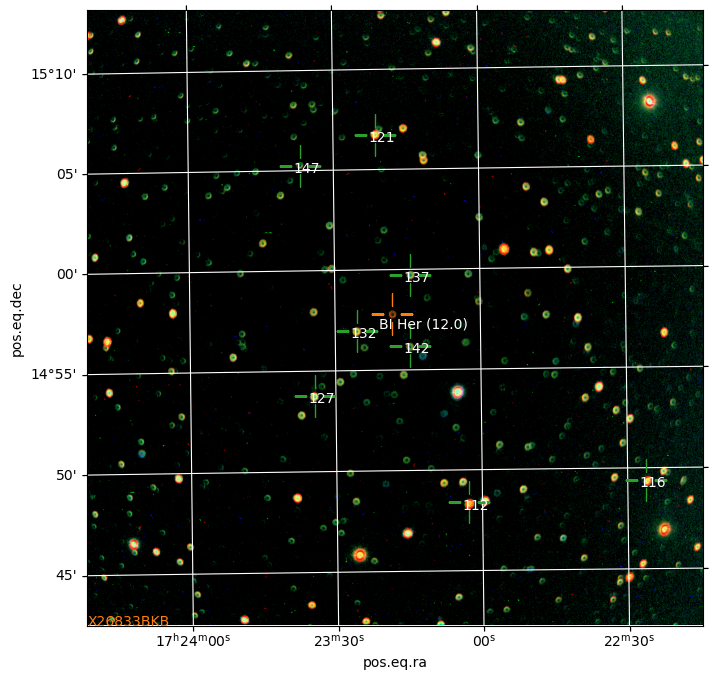

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

J349185:R677757 (BI Her) 6 February 2020 05:28:14 UTC
Filters: R V B
Getting 73B68469 from cache
BI Her seq:X26833BKB (8)


a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


jid 349185: (BI Her)
6 February 2020 05:28:14 UTC
Filters: ('R', 'V', 'B')
Getting 73B68469 from cache
 GCVS  n_GCVS   RAJ2000     DEJ2000   VarType magMax      Period      SpType Exists  VarName  Simbad
                "h:m:s"     "d:m:s"            mag          d                                       
------ ------ ----------- ----------- ------- ------ ---------------- ------ ------ --------- ------
BI Her      x 17 23 18.13 +14 57 47.9       M 12.000   210.0000000000               BI    Her Simbad
['000-BKL-281', '112', '17:23:02.85', 260.76187134, '14:48:22.9', 14.8063612, '12.782 (—)', '11.193 (—)', '1.589 (—)', '10.347 (0.029)']
['000-BKL-282', '116', '17:22:26.27', 260.60946655, '14:49:24.3', 14.82341671, '12.712 (—)', '11.554 (—)', '1.158 (—)', '11.017 (0.029)']
['000-BKL-283', '121', '17:23:21.33', 260.83886719, '15:06:43.0', 15.1119442, '13.124 (0.025)', '12.094 (0.017)', '1.030 (0.030)', '11.514 (0.025)']
['000-BKL-284', '127', '17:23:34.36', 260.89315796, '14:53:46.1', 14.

a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


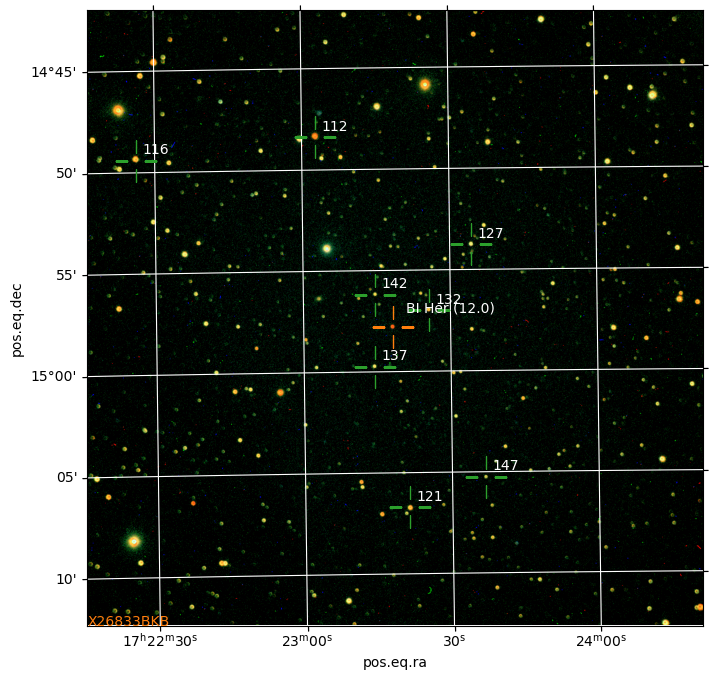

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

J387457:R729936 (BI Her) 24 October 2021 19:57:57 UTC
Filters: R V B
Solving for 09D33A05
solve-field -p -l 120 -O -L 1 -H 2 -u app -3 260.825000 -4 14.963333 -5 5 /tmp/field-solverxji9aedp/tmpi_tgahn4.fits


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]


BI Her seq:X26833BKB (8)
jid 387457: (BI Her)
24 October 2021 19:57:57 UTC
Filters: ('R', 'V', 'B')
Getting 09D33A05 from cache
 GCVS  n_GCVS   RAJ2000     DEJ2000   VarType magMax      Period      SpType Exists  VarName  Simbad
                'h:m:s'     'd:m:s'            mag          d                                       
------ ------ ----------- ----------- ------- ------ ---------------- ------ ------ --------- ------
BI Her      x 17 23 18.13 +14 57 47.9       M 12.000   210.0000000000               BI    Her Simbad
['000-BKL-281', '112', '17:23:02.85', 260.76187134, '14:48:22.9', 14.8063612, '12.782 (—)', '11.193 (—)', '1.589 (—)', '10.347 (0.029)']
['000-BKL-282', '116', '17:22:26.27', 260.60946655, '14:49:24.3', 14.82341671, '12.712 (—)', '11.554 (—)', '1.158 (—)', '11.017 (0.029)']
['000-BKL-283', '121', '17:23:21.33', 260.83886719, '15:06:43.0', 15.1119442, '13.124 (0.025)', '12.094 (0.017)', '1.030 (0.030)', '11.514 (0.025)']
['000-BKL-284', '127', '17:23:34.36', 260.89

the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]


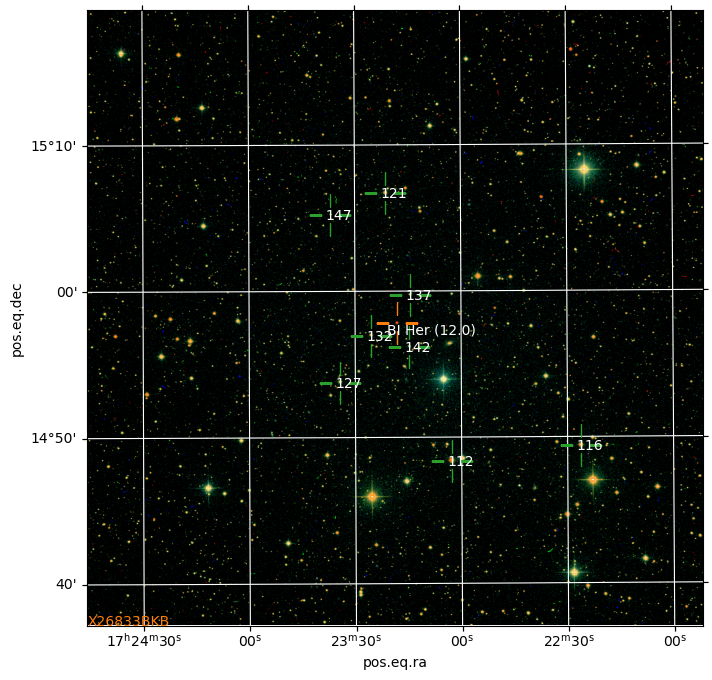

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

J347780:R676261 (BI Her) 21 January 2020 06:53:02 UTC
Filters: R V B
Getting FA99020F from cache
BI Her seq:X26833BKB (8)


a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


jid 347780: (BI Her)
21 January 2020 06:53:02 UTC
Filters: ('R', 'V', 'B')
Getting FA99020F from cache
 GCVS  n_GCVS   RAJ2000     DEJ2000   VarType magMax      Period      SpType Exists  VarName  Simbad
                "h:m:s"     "d:m:s"            mag          d                                       
------ ------ ----------- ----------- ------- ------ ---------------- ------ ------ --------- ------
BI Her      x 17 23 18.13 +14 57 47.9       M 12.000   210.0000000000               BI    Her Simbad
['000-BKL-281', '112', '17:23:02.85', 260.76187134, '14:48:22.9', 14.8063612, '12.782 (—)', '11.193 (—)', '1.589 (—)', '10.347 (0.029)']
['000-BKL-282', '116', '17:22:26.27', 260.60946655, '14:49:24.3', 14.82341671, '12.712 (—)', '11.554 (—)', '1.158 (—)', '11.017 (0.029)']
['000-BKL-283', '121', '17:23:21.33', 260.83886719, '15:06:43.0', 15.1119442, '13.124 (0.025)', '12.094 (0.017)', '1.030 (0.030)', '11.514 (0.025)']
['000-BKL-284', '127', '17:23:34.36', 260.89315796, '14:53:46.1', 14.

a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


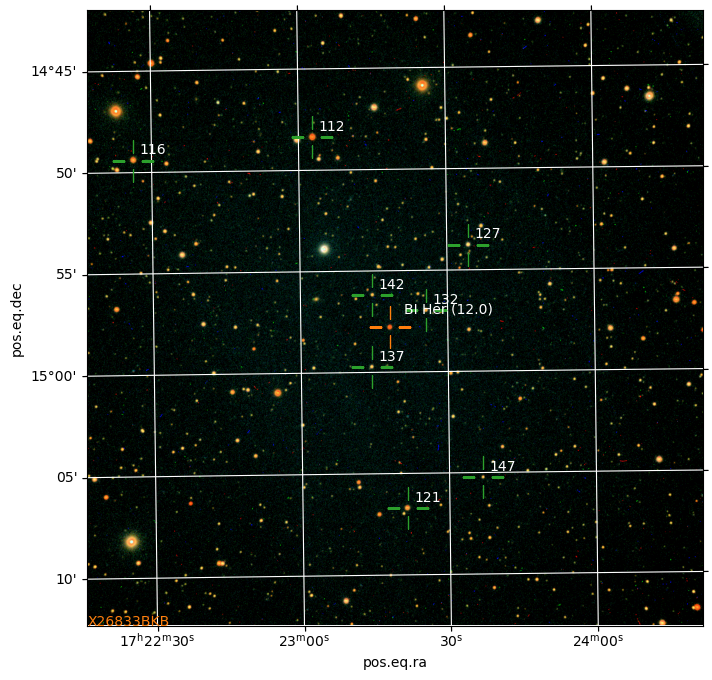

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

J392070:R735438 (BI Her) 19 February 2022 04:38:22 UTC
Filters: R V B
Solving for 2A82EB7A
solve-field -p -l 120 -O -L 1 -H 2 -u app -3 260.825000 -4 14.963333 -5 5 /tmp/field-solver5fui2818/tmp4ylun0ri.fits


a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


BI Her seq:X26833BKB (8)
jid 392070: (BI Her)
19 February 2022 04:38:22 UTC
Filters: ('R', 'V', 'B')
Getting 2A82EB7A from cache
 GCVS  n_GCVS   RAJ2000     DEJ2000   VarType magMax      Period      SpType Exists  VarName  Simbad
                'h:m:s'     'd:m:s'            mag          d                                       
------ ------ ----------- ----------- ------- ------ ---------------- ------ ------ --------- ------
BI Her      x 17 23 18.13 +14 57 47.9       M 12.000   210.0000000000               BI    Her Simbad
['000-BKL-281', '112', '17:23:02.85', 260.76187134, '14:48:22.9', 14.8063612, '12.782 (—)', '11.193 (—)', '1.589 (—)', '10.347 (0.029)']
['000-BKL-282', '116', '17:22:26.27', 260.60946655, '14:49:24.3', 14.82341671, '12.712 (—)', '11.554 (—)', '1.158 (—)', '11.017 (0.029)']
['000-BKL-283', '121', '17:23:21.33', 260.83886719, '15:06:43.0', 15.1119442, '13.124 (0.025)', '12.094 (0.017)', '1.030 (0.030)', '11.514 (0.025)']
['000-BKL-284', '127', '17:23:34.36', 260.8

a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


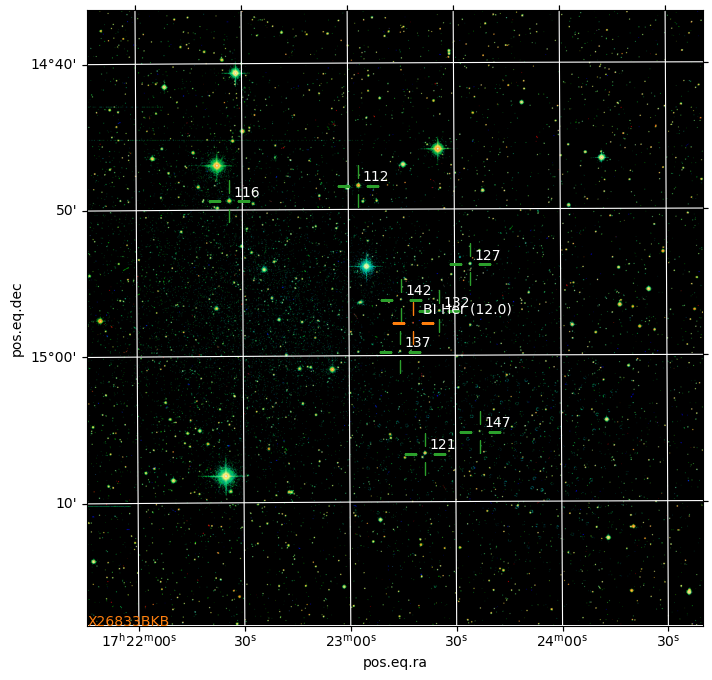

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

J383113:R724987 (BI Her) 23 August 2021 22:00:02 UTC
Filters: R V B
Getting A8D16191 from cache
BI Her seq:X26833BKB (8)
jid 383113: (BI Her)
23 August 2021 22:00:02 UTC
Filters: ('R', 'V', 'B')
Getting A8D16191 from cache
 GCVS  n_GCVS   RAJ2000     DEJ2000   VarType magMax      Period      SpType Exists  VarName  Simbad
                "h:m:s"     "d:m:s"            mag          d                                       
------ ------ ----------- ----------- ------- ------ ---------------- ------ ------ --------- ------
BI Her      x 17 23 18.13 +14 57 47.9       M 12.000   210.0000000000               BI    Her Simbad
['000-BKL-281', '112', '17:23:02.85', 260.76187134, '14:48:22.9', 14.8063612, '12.782 (—)', '11.193 (—)', '1.589 (—)', '10.347 (0.029)']
['000-BKL-282', '116', '17:22:26.27', 260.60946655, '14:49:24.3', 14.82341671, '12.712 (—)', '11.554 (—)', '1.158 (—)', '11.017 (0.029)']
['000-BKL-283', '121', '17:23:21.33', 260.83886719, '15:06:43.0', 15.1119442, '13.124 (0.025)', '1

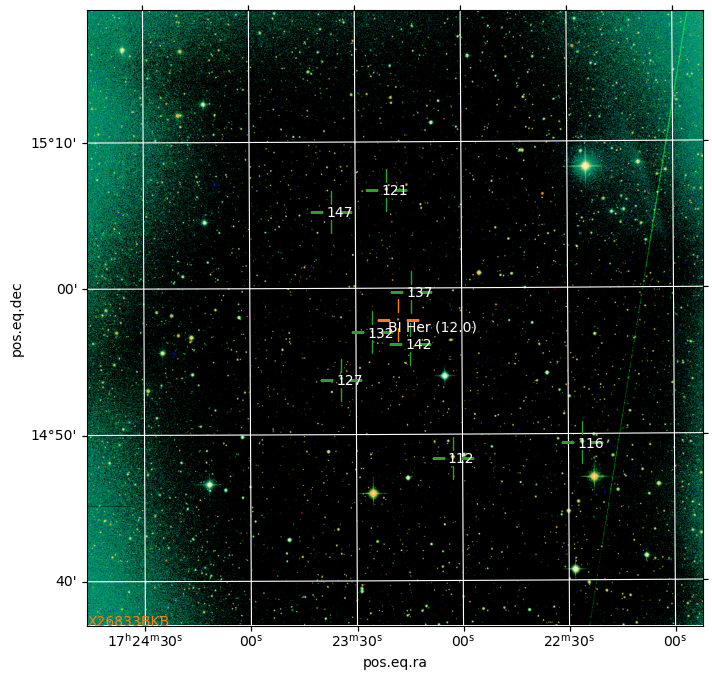

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

J398732:R743601 (BI Her) 26 August 2022 00:43:03 UTC
Filters: R V B
Solving for 282DFF76
solve-field -p -l 120 -O -L 1 -H 2 -u app -3 260.825000 -4 14.963333 -5 5 /tmp/field-solver9ivd241i/tmpmnm8fyvv.fits


a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


BI Her seq:X26833BKB (8)
jid 398732: (BI Her)
26 August 2022 00:43:03 UTC
Filters: ('R', 'V', 'B')
Getting 282DFF76 from cache
 GCVS  n_GCVS   RAJ2000     DEJ2000   VarType magMax      Period      SpType Exists  VarName  Simbad
                'h:m:s'     'd:m:s'            mag          d                                       
------ ------ ----------- ----------- ------- ------ ---------------- ------ ------ --------- ------
BI Her      x 17 23 18.13 +14 57 47.9       M 12.000   210.0000000000               BI    Her Simbad
['000-BKL-281', '112', '17:23:02.85', 260.76187134, '14:48:22.9', 14.8063612, '12.782 (—)', '11.193 (—)', '1.589 (—)', '10.347 (0.029)']
['000-BKL-282', '116', '17:22:26.27', 260.60946655, '14:49:24.3', 14.82341671, '12.712 (—)', '11.554 (—)', '1.158 (—)', '11.017 (0.029)']
['000-BKL-283', '121', '17:23:21.33', 260.83886719, '15:06:43.0', 15.1119442, '13.124 (0.025)', '12.094 (0.017)', '1.030 (0.030)', '11.514 (0.025)']
['000-BKL-284', '127', '17:23:34.36', 260.893

a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


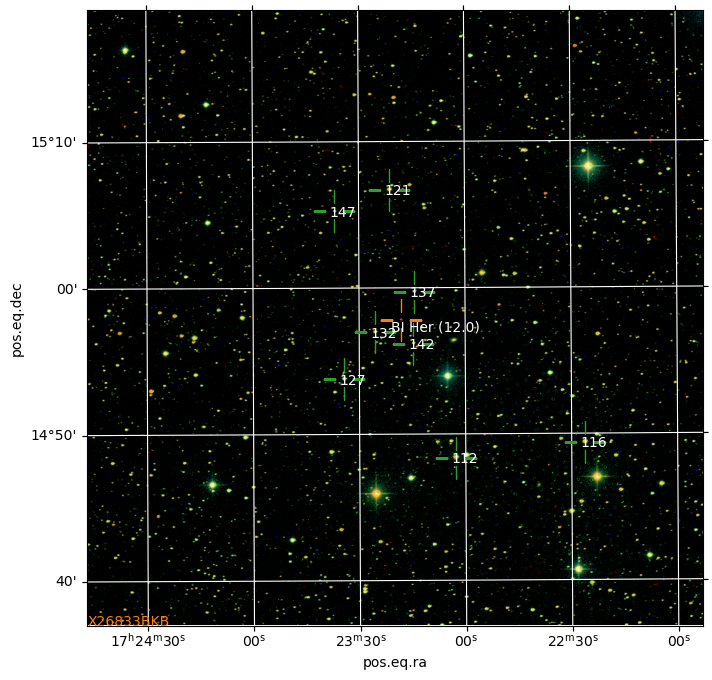

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

J395789:R740059 (BI Her) 22 May 2022 22:01:57 UTC
Filters: R V B
Solving for 64B8C8A3
solve-field -p -l 120 -O -L 1 -H 2 -u app -3 260.825000 -4 14.963333 -5 5 /tmp/field-solverpdtestik/tmp_nqbn5ew.fits


a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


BI Her seq:X26833BKB (8)
jid 395789: (BI Her)
22 May 2022 22:01:57 UTC
Filters: ('R', 'V', 'B')
Getting 64B8C8A3 from cache
 GCVS  n_GCVS   RAJ2000     DEJ2000   VarType magMax      Period      SpType Exists  VarName  Simbad
                'h:m:s'     'd:m:s'            mag          d                                       
------ ------ ----------- ----------- ------- ------ ---------------- ------ ------ --------- ------
BI Her      x 17 23 18.13 +14 57 47.9       M 12.000   210.0000000000               BI    Her Simbad
['000-BKL-281', '112', '17:23:02.85', 260.76187134, '14:48:22.9', 14.8063612, '12.782 (—)', '11.193 (—)', '1.589 (—)', '10.347 (0.029)']
['000-BKL-282', '116', '17:22:26.27', 260.60946655, '14:49:24.3', 14.82341671, '12.712 (—)', '11.554 (—)', '1.158 (—)', '11.017 (0.029)']
['000-BKL-283', '121', '17:23:21.33', 260.83886719, '15:06:43.0', 15.1119442, '13.124 (0.025)', '12.094 (0.017)', '1.030 (0.030)', '11.514 (0.025)']
['000-BKL-284', '127', '17:23:34.36', 260.893157

a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


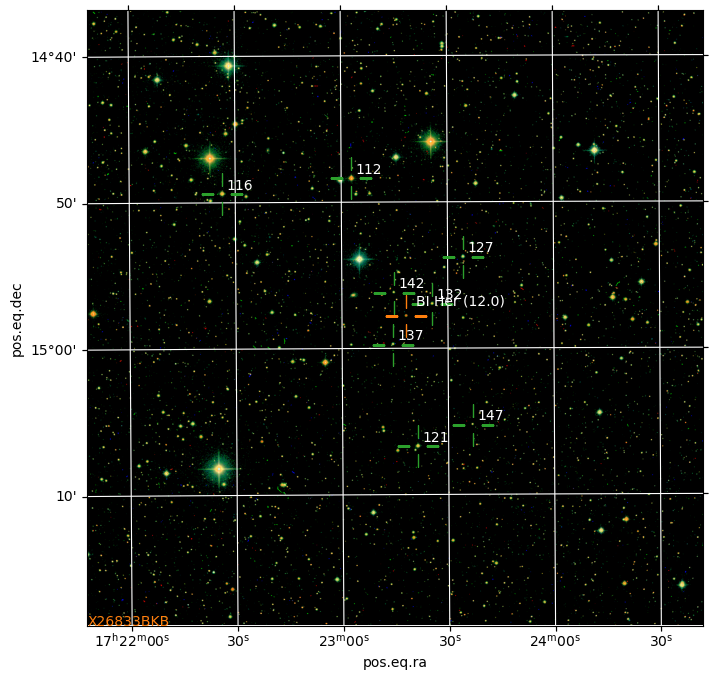

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

J369806:R707041 (BI Her) 18 January 2021 06:11:39 UTC
Filters: R V B
Getting AF6958ED from cache
BI Her seq:X26833BKB (8)


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]


jid 369806: (BI Her)
18 January 2021 06:11:39 UTC
Filters: ('R', 'V', 'B')
Getting AF6958ED from cache
 GCVS  n_GCVS   RAJ2000     DEJ2000   VarType magMax      Period      SpType Exists  VarName  Simbad
                "h:m:s"     "d:m:s"            mag          d                                       
------ ------ ----------- ----------- ------- ------ ---------------- ------ ------ --------- ------
BI Her      x 17 23 18.13 +14 57 47.9       M 12.000   210.0000000000               BI    Her Simbad
['000-BKL-281', '112', '17:23:02.85', 260.76187134, '14:48:22.9', 14.8063612, '12.782 (—)', '11.193 (—)', '1.589 (—)', '10.347 (0.029)']
['000-BKL-282', '116', '17:22:26.27', 260.60946655, '14:49:24.3', 14.82341671, '12.712 (—)', '11.554 (—)', '1.158 (—)', '11.017 (0.029)']
['000-BKL-283', '121', '17:23:21.33', 260.83886719, '15:06:43.0', 15.1119442, '13.124 (0.025)', '12.094 (0.017)', '1.030 (0.030)', '11.514 (0.025)']
['000-BKL-284', '127', '17:23:34.36', 260.89315796, '14:53:46.1', 14.

the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]


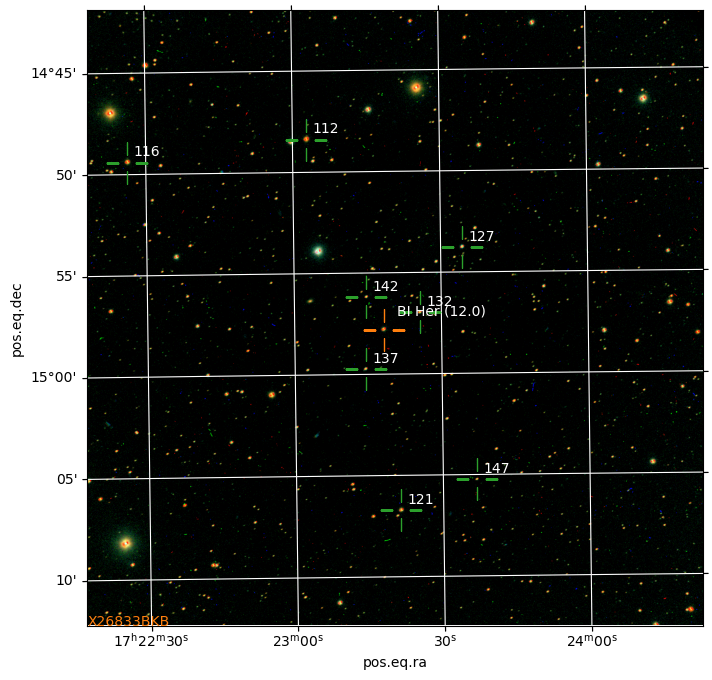

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

J335766:R663164 (BI Her) 24 March 2019 02:43:54 UTC
Filters: R V B
Getting 7C7207AA from cache
BI Her seq:X26833BKB (8)


a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


jid 335766: (BI Her)
24 March 2019 02:43:54 UTC
Filters: ('R', 'V', 'B')
Getting 7C7207AA from cache
 GCVS  n_GCVS   RAJ2000     DEJ2000   VarType magMax      Period      SpType Exists  VarName  Simbad
                "h:m:s"     "d:m:s"            mag          d                                       
------ ------ ----------- ----------- ------- ------ ---------------- ------ ------ --------- ------
BI Her      x 17 23 18.13 +14 57 47.9       M 12.000   210.0000000000               BI    Her Simbad
['000-BKL-281', '112', '17:23:02.85', 260.76187134, '14:48:22.9', 14.8063612, '12.782 (—)', '11.193 (—)', '1.589 (—)', '10.347 (0.029)']
['000-BKL-282', '116', '17:22:26.27', 260.60946655, '14:49:24.3', 14.82341671, '12.712 (—)', '11.554 (—)', '1.158 (—)', '11.017 (0.029)']
['000-BKL-283', '121', '17:23:21.33', 260.83886719, '15:06:43.0', 15.1119442, '13.124 (0.025)', '12.094 (0.017)', '1.030 (0.030)', '11.514 (0.025)']
['000-BKL-284', '127', '17:23:34.36', 260.89315796, '14:53:46.1', 14.89

a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


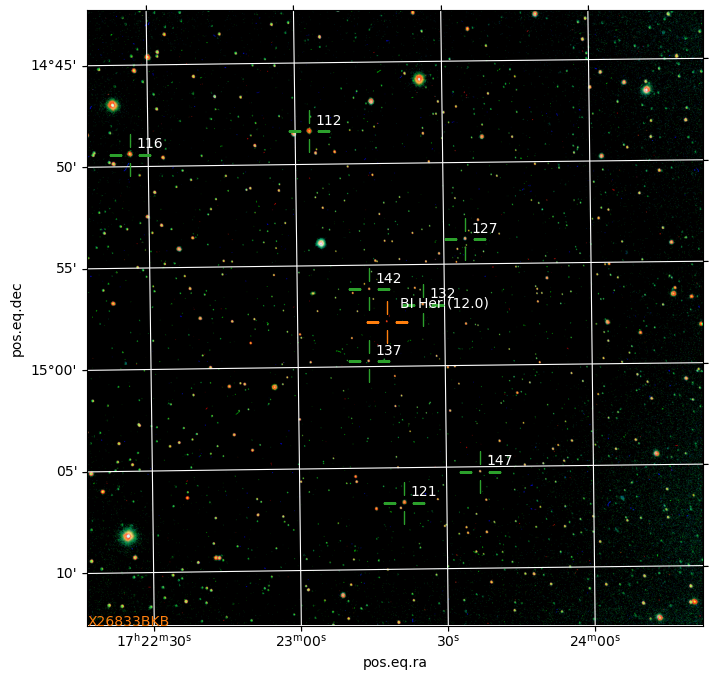

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

J388759:R731484 (BI Her) 6 January 2022 07:01:23 UTC
Filters: R V B
Solving for 5CF3189F
solve-field -p -l 120 -O -L 1 -H 2 -u app -3 260.825000 -4 14.963333 -5 5 /tmp/field-solverz_2tmoel/tmpmk5ziu5w.fits


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]


BI Her seq:X26833BKB (8)
jid 388759: (BI Her)
6 January 2022 07:01:23 UTC
Filters: ('R', 'V', 'B')
Getting 5CF3189F from cache
 GCVS  n_GCVS   RAJ2000     DEJ2000   VarType magMax      Period      SpType Exists  VarName  Simbad
                'h:m:s'     'd:m:s'            mag          d                                       
------ ------ ----------- ----------- ------- ------ ---------------- ------ ------ --------- ------
BI Her      x 17 23 18.13 +14 57 47.9       M 12.000   210.0000000000               BI    Her Simbad
['000-BKL-281', '112', '17:23:02.85', 260.76187134, '14:48:22.9', 14.8063612, '12.782 (—)', '11.193 (—)', '1.589 (—)', '10.347 (0.029)']
['000-BKL-282', '116', '17:22:26.27', 260.60946655, '14:49:24.3', 14.82341671, '12.712 (—)', '11.554 (—)', '1.158 (—)', '11.017 (0.029)']
['000-BKL-283', '121', '17:23:21.33', 260.83886719, '15:06:43.0', 15.1119442, '13.124 (0.025)', '12.094 (0.017)', '1.030 (0.030)', '11.514 (0.025)']
['000-BKL-284', '127', '17:23:34.36', 260.893

the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]


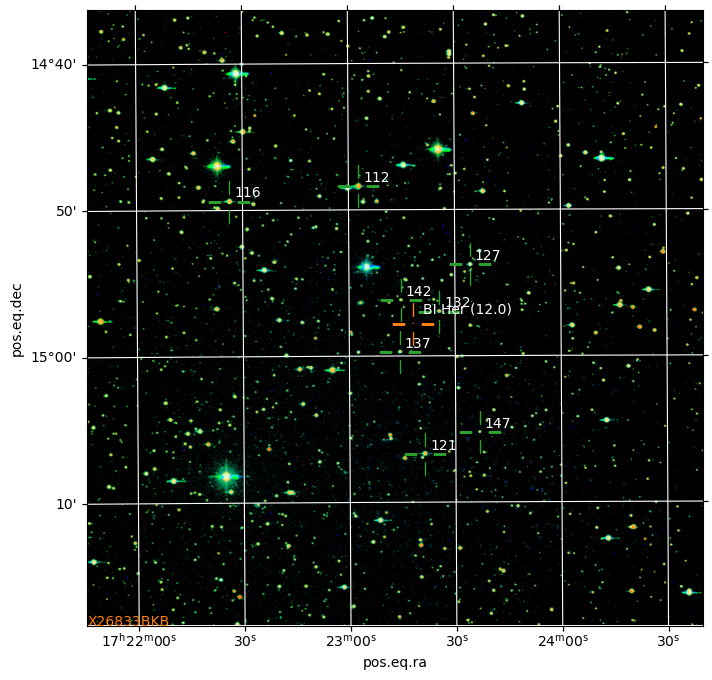

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

J393111:R736895 (BI Her) 13 March 2022 02:51:19 UTC
Filters: R V B
Solving for 47CFD5A4
solve-field -p -l 120 -O -L 1 -H 2 -u app -3 260.825000 -4 14.963333 -5 5 /tmp/field-solvere7z5_jgg/tmpzcss9eqg.fits


a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


BI Her seq:X26833BKB (8)
jid 393111: (BI Her)
13 March 2022 02:51:19 UTC
Filters: ('R', 'V', 'B')
Getting 47CFD5A4 from cache
 GCVS  n_GCVS   RAJ2000     DEJ2000   VarType magMax      Period      SpType Exists  VarName  Simbad
                'h:m:s'     'd:m:s'            mag          d                                       
------ ------ ----------- ----------- ------- ------ ---------------- ------ ------ --------- ------
BI Her      x 17 23 18.13 +14 57 47.9       M 12.000   210.0000000000               BI    Her Simbad
['000-BKL-281', '112', '17:23:02.85', 260.76187134, '14:48:22.9', 14.8063612, '12.782 (—)', '11.193 (—)', '1.589 (—)', '10.347 (0.029)']
['000-BKL-282', '116', '17:22:26.27', 260.60946655, '14:49:24.3', 14.82341671, '12.712 (—)', '11.554 (—)', '1.158 (—)', '11.017 (0.029)']
['000-BKL-283', '121', '17:23:21.33', 260.83886719, '15:06:43.0', 15.1119442, '13.124 (0.025)', '12.094 (0.017)', '1.030 (0.030)', '11.514 (0.025)']
['000-BKL-284', '127', '17:23:34.36', 260.8931

a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


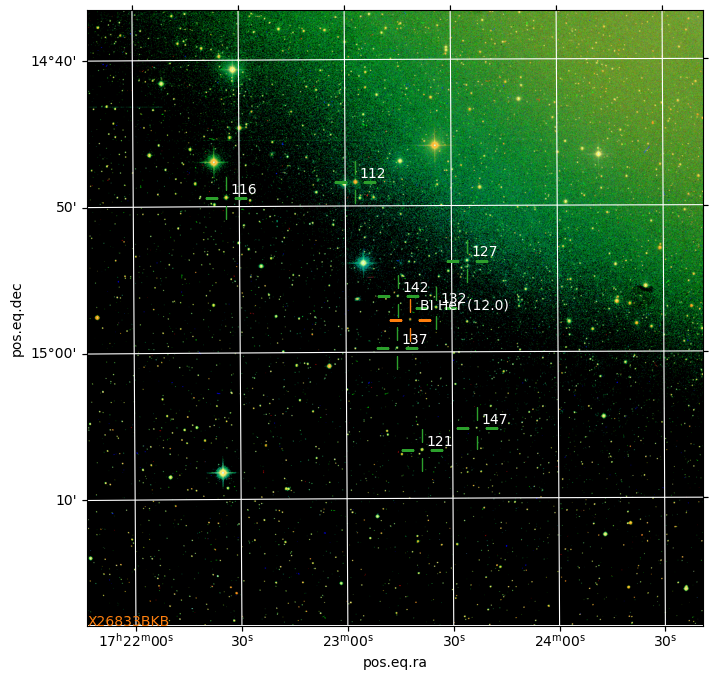

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

J346393:R674820 (BI Her) 11 January 2020 06:53:41 UTC
Filters: R V B
Getting 52674778 from cache
BI Her seq:X26833BKB (8)


a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


jid 346393: (BI Her)
11 January 2020 06:53:41 UTC
Filters: ('R', 'V', 'B')
Getting 52674778 from cache
 GCVS  n_GCVS   RAJ2000     DEJ2000   VarType magMax      Period      SpType Exists  VarName  Simbad
                "h:m:s"     "d:m:s"            mag          d                                       
------ ------ ----------- ----------- ------- ------ ---------------- ------ ------ --------- ------
BI Her      x 17 23 18.13 +14 57 47.9       M 12.000   210.0000000000               BI    Her Simbad
['000-BKL-281', '112', '17:23:02.85', 260.76187134, '14:48:22.9', 14.8063612, '12.782 (—)', '11.193 (—)', '1.589 (—)', '10.347 (0.029)']
['000-BKL-282', '116', '17:22:26.27', 260.60946655, '14:49:24.3', 14.82341671, '12.712 (—)', '11.554 (—)', '1.158 (—)', '11.017 (0.029)']
['000-BKL-283', '121', '17:23:21.33', 260.83886719, '15:06:43.0', 15.1119442, '13.124 (0.025)', '12.094 (0.017)', '1.030 (0.030)', '11.514 (0.025)']
['000-BKL-284', '127', '17:23:34.36', 260.89315796, '14:53:46.1', 14.

a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


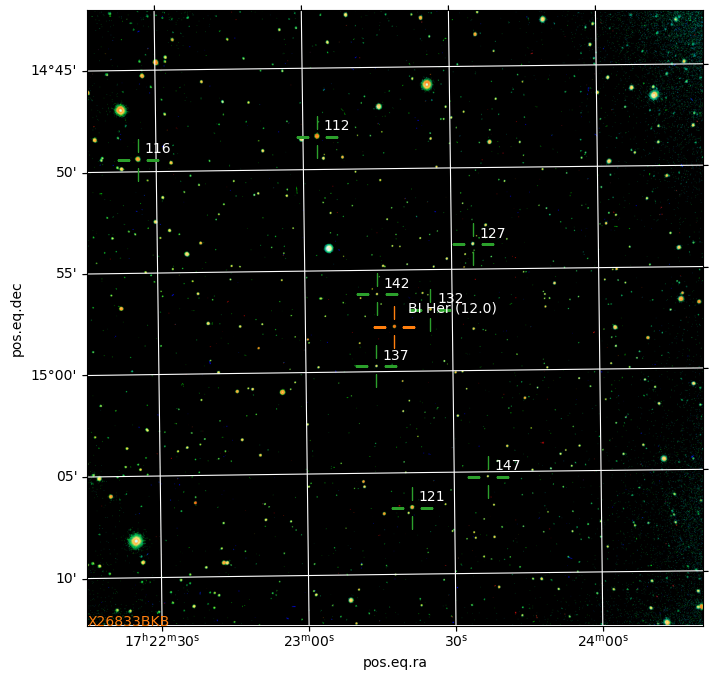

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

J349727:R678344 (BI Her) 11 February 2020 04:55:13 UTC
Filters: R V B
Getting 082C707A from cache
BI Her seq:X26833BKB (8)


a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


jid 349727: (BI Her)
11 February 2020 04:55:13 UTC
Filters: ('R', 'V', 'B')
Getting 082C707A from cache
 GCVS  n_GCVS   RAJ2000     DEJ2000   VarType magMax      Period      SpType Exists  VarName  Simbad
                "h:m:s"     "d:m:s"            mag          d                                       
------ ------ ----------- ----------- ------- ------ ---------------- ------ ------ --------- ------
BI Her      x 17 23 18.13 +14 57 47.9       M 12.000   210.0000000000               BI    Her Simbad
['000-BKL-281', '112', '17:23:02.85', 260.76187134, '14:48:22.9', 14.8063612, '12.782 (—)', '11.193 (—)', '1.589 (—)', '10.347 (0.029)']
['000-BKL-282', '116', '17:22:26.27', 260.60946655, '14:49:24.3', 14.82341671, '12.712 (—)', '11.554 (—)', '1.158 (—)', '11.017 (0.029)']
['000-BKL-283', '121', '17:23:21.33', 260.83886719, '15:06:43.0', 15.1119442, '13.124 (0.025)', '12.094 (0.017)', '1.030 (0.030)', '11.514 (0.025)']
['000-BKL-284', '127', '17:23:34.36', 260.89315796, '14:53:46.1', 14

a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


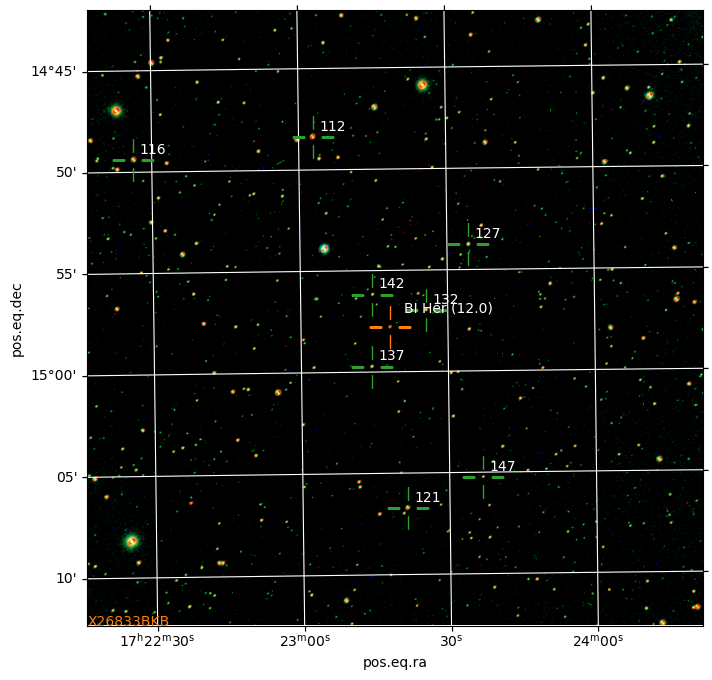

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

J394912:R738959 (BI Her) 22 April 2022 00:19:09 UTC
Filters: R V B
Solving for 34CDFECA
solve-field -p -l 120 -O -L 1 -H 2 -u app -3 260.825000 -4 14.963333 -5 5 /tmp/field-solverdu81jfin/tmpr9j16cmx.fits


a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


BI Her seq:X26833BKB (8)
jid 394912: (BI Her)
22 April 2022 00:19:09 UTC
Filters: ('R', 'V', 'B')
Getting 34CDFECA from cache
 GCVS  n_GCVS   RAJ2000     DEJ2000   VarType magMax      Period      SpType Exists  VarName  Simbad
                'h:m:s'     'd:m:s'            mag          d                                       
------ ------ ----------- ----------- ------- ------ ---------------- ------ ------ --------- ------
BI Her      x 17 23 18.13 +14 57 47.9       M 12.000   210.0000000000               BI    Her Simbad
['000-BKL-281', '112', '17:23:02.85', 260.76187134, '14:48:22.9', 14.8063612, '12.782 (—)', '11.193 (—)', '1.589 (—)', '10.347 (0.029)']
['000-BKL-282', '116', '17:22:26.27', 260.60946655, '14:49:24.3', 14.82341671, '12.712 (—)', '11.554 (—)', '1.158 (—)', '11.017 (0.029)']
['000-BKL-283', '121', '17:23:21.33', 260.83886719, '15:06:43.0', 15.1119442, '13.124 (0.025)', '12.094 (0.017)', '1.030 (0.030)', '11.514 (0.025)']
['000-BKL-284', '127', '17:23:34.36', 260.8931

a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


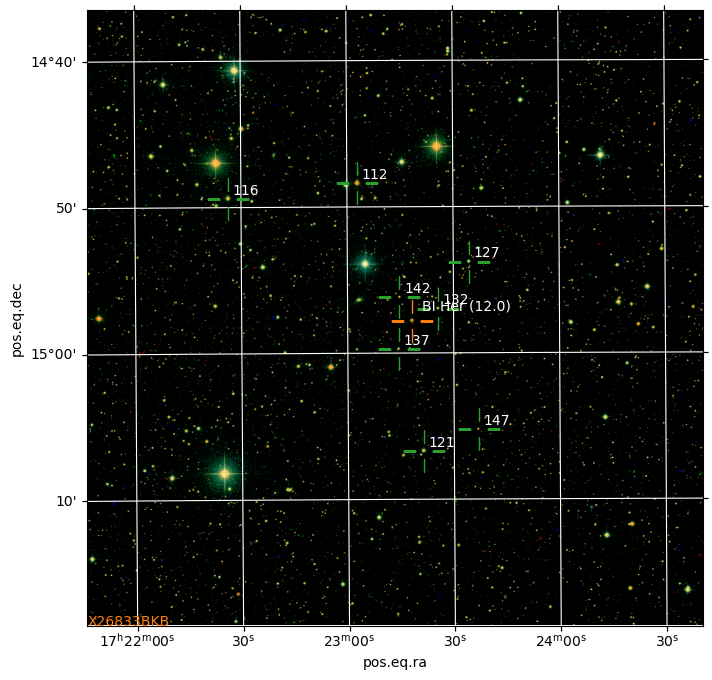

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

J383650:R725592 (BI Her) 31 August 2021 00:28:18 UTC
Filters: R V B
Solving for 89017AD5
solve-field -p -l 120 -O -L 1 -H 2 -u app -3 260.825000 -4 14.963333 -5 5 /tmp/field-solver_g8aflgy/tmpr6ut9u5h.fits


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]


BI Her seq:X26833BKB (8)
jid 383650: (BI Her)
31 August 2021 00:28:18 UTC
Filters: ('R', 'V', 'B')
Getting 89017AD5 from cache
 GCVS  n_GCVS   RAJ2000     DEJ2000   VarType magMax      Period      SpType Exists  VarName  Simbad
                'h:m:s'     'd:m:s'            mag          d                                       
------ ------ ----------- ----------- ------- ------ ---------------- ------ ------ --------- ------
BI Her      x 17 23 18.13 +14 57 47.9       M 12.000   210.0000000000               BI    Her Simbad
['000-BKL-281', '112', '17:23:02.85', 260.76187134, '14:48:22.9', 14.8063612, '12.782 (—)', '11.193 (—)', '1.589 (—)', '10.347 (0.029)']
['000-BKL-282', '116', '17:22:26.27', 260.60946655, '14:49:24.3', 14.82341671, '12.712 (—)', '11.554 (—)', '1.158 (—)', '11.017 (0.029)']
['000-BKL-283', '121', '17:23:21.33', 260.83886719, '15:06:43.0', 15.1119442, '13.124 (0.025)', '12.094 (0.017)', '1.030 (0.030)', '11.514 (0.025)']
['000-BKL-284', '127', '17:23:34.36', 260.893

the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]


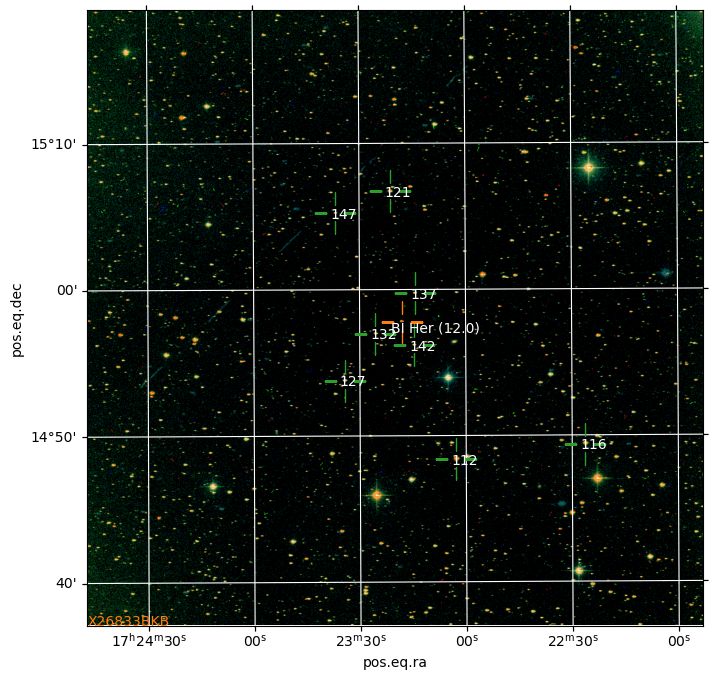

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

J338339:R665819 (BI Her) 7 August 2019 01:32:59 UTC
Filters: R V B
Getting 5EC2B431 from cache
BI Her seq:X26833BKB (8)


a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


jid 338339: (BI Her)
7 August 2019 01:32:59 UTC
Filters: ('R', 'V', 'B')
Getting 5EC2B431 from cache
 GCVS  n_GCVS   RAJ2000     DEJ2000   VarType magMax      Period      SpType Exists  VarName  Simbad
                "h:m:s"     "d:m:s"            mag          d                                       
------ ------ ----------- ----------- ------- ------ ---------------- ------ ------ --------- ------
BI Her      x 17 23 18.13 +14 57 47.9       M 12.000   210.0000000000               BI    Her Simbad
['000-BKL-281', '112', '17:23:02.85', 260.76187134, '14:48:22.9', 14.8063612, '12.782 (—)', '11.193 (—)', '1.589 (—)', '10.347 (0.029)']
['000-BKL-282', '116', '17:22:26.27', 260.60946655, '14:49:24.3', 14.82341671, '12.712 (—)', '11.554 (—)', '1.158 (—)', '11.017 (0.029)']
['000-BKL-283', '121', '17:23:21.33', 260.83886719, '15:06:43.0', 15.1119442, '13.124 (0.025)', '12.094 (0.017)', '1.030 (0.030)', '11.514 (0.025)']
['000-BKL-284', '127', '17:23:34.36', 260.89315796, '14:53:46.1', 14.89

a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


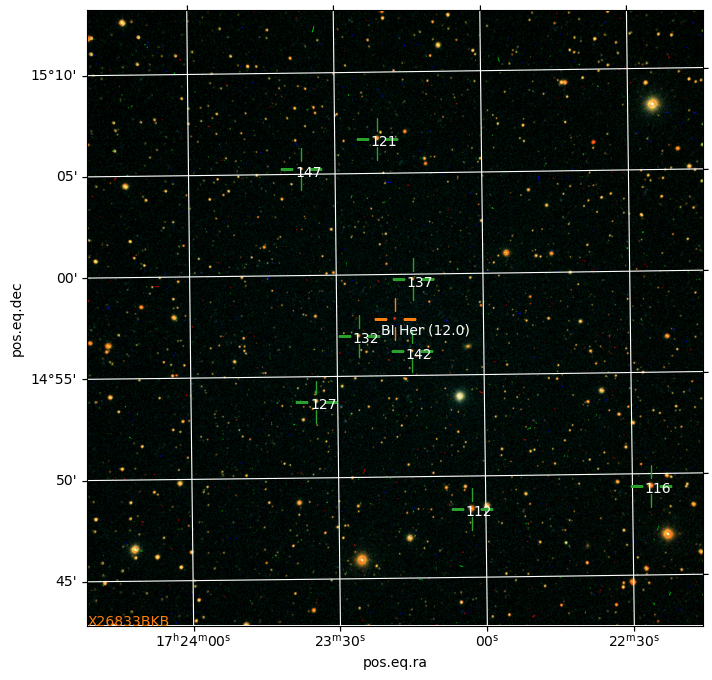

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

J346660:R675092 (BI Her) 13 January 2020 06:56:37 UTC
Filters: R V B
Getting B01F69CC from cache
BI Her seq:X26833BKB (8)


a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


jid 346660: (BI Her)
13 January 2020 06:56:37 UTC
Filters: ('R', 'V', 'B')
Getting B01F69CC from cache
 GCVS  n_GCVS   RAJ2000     DEJ2000   VarType magMax      Period      SpType Exists  VarName  Simbad
                "h:m:s"     "d:m:s"            mag          d                                       
------ ------ ----------- ----------- ------- ------ ---------------- ------ ------ --------- ------
BI Her      x 17 23 18.13 +14 57 47.9       M 12.000   210.0000000000               BI    Her Simbad
['000-BKL-281', '112', '17:23:02.85', 260.76187134, '14:48:22.9', 14.8063612, '12.782 (—)', '11.193 (—)', '1.589 (—)', '10.347 (0.029)']
['000-BKL-282', '116', '17:22:26.27', 260.60946655, '14:49:24.3', 14.82341671, '12.712 (—)', '11.554 (—)', '1.158 (—)', '11.017 (0.029)']
['000-BKL-283', '121', '17:23:21.33', 260.83886719, '15:06:43.0', 15.1119442, '13.124 (0.025)', '12.094 (0.017)', '1.030 (0.030)', '11.514 (0.025)']
['000-BKL-284', '127', '17:23:34.36', 260.89315796, '14:53:46.1', 14.

a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


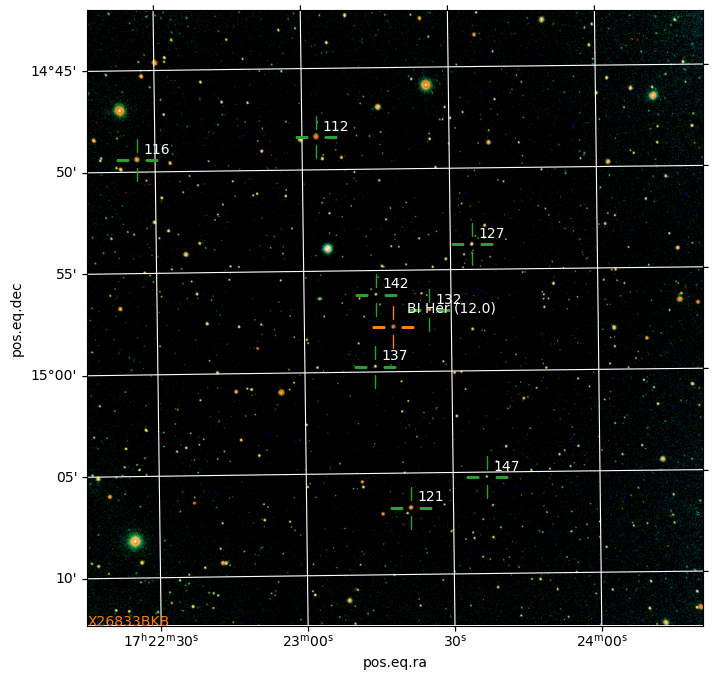

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

J392740:R736391 (BI Her) 9 March 2022 03:09:09 UTC
Filters: R V B
Solving for E03ABAE4
solve-field -p -l 120 -O -L 1 -H 2 -u app -3 260.825000 -4 14.963333 -5 5 /tmp/field-solverr0f193ha/tmpcpyfg5hm.fits


a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


BI Her seq:X26833BKB (8)
jid 392740: (BI Her)
9 March 2022 03:09:09 UTC
Filters: ('R', 'V', 'B')
Getting E03ABAE4 from cache
 GCVS  n_GCVS   RAJ2000     DEJ2000   VarType magMax      Period      SpType Exists  VarName  Simbad
                'h:m:s'     'd:m:s'            mag          d                                       
------ ------ ----------- ----------- ------- ------ ---------------- ------ ------ --------- ------
BI Her      x 17 23 18.13 +14 57 47.9       M 12.000   210.0000000000               BI    Her Simbad
['000-BKL-281', '112', '17:23:02.85', 260.76187134, '14:48:22.9', 14.8063612, '12.782 (—)', '11.193 (—)', '1.589 (—)', '10.347 (0.029)']
['000-BKL-282', '116', '17:22:26.27', 260.60946655, '14:49:24.3', 14.82341671, '12.712 (—)', '11.554 (—)', '1.158 (—)', '11.017 (0.029)']
['000-BKL-283', '121', '17:23:21.33', 260.83886719, '15:06:43.0', 15.1119442, '13.124 (0.025)', '12.094 (0.017)', '1.030 (0.030)', '11.514 (0.025)']
['000-BKL-284', '127', '17:23:34.36', 260.89315

a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


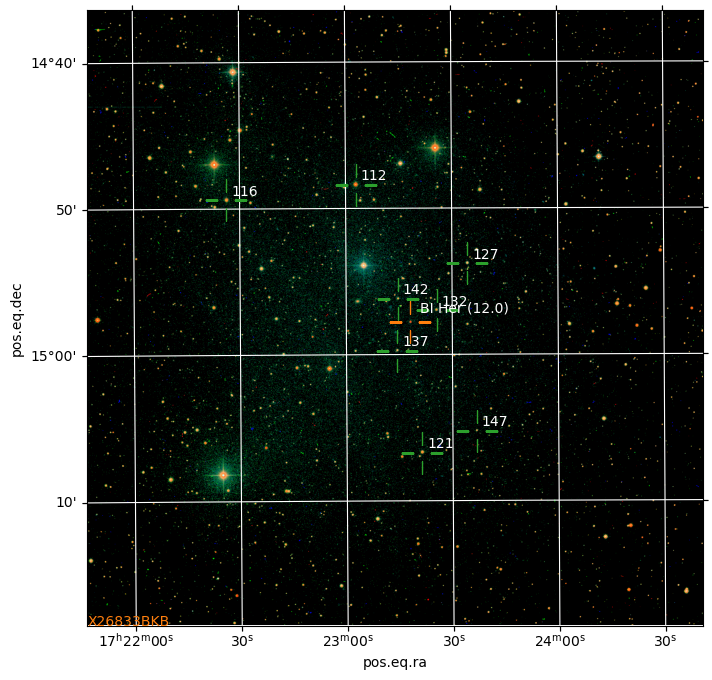

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

J387747:R730275 (BI Her) 31 October 2021 19:35:50 UTC
Filters: R V B
Solving for D34AC5F7
solve-field -p -l 120 -O -L 1 -H 2 -u app -3 260.825000 -4 14.963333 -5 5 /tmp/field-solvergtthbhd0/tmpon7ihrs9.fits


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]


BI Her seq:X26833BKB (8)
jid 387747: (BI Her)
31 October 2021 19:35:50 UTC
Filters: ('R', 'V', 'B')
Getting D34AC5F7 from cache
 GCVS  n_GCVS   RAJ2000     DEJ2000   VarType magMax      Period      SpType Exists  VarName  Simbad
                'h:m:s'     'd:m:s'            mag          d                                       
------ ------ ----------- ----------- ------- ------ ---------------- ------ ------ --------- ------
BI Her      x 17 23 18.13 +14 57 47.9       M 12.000   210.0000000000               BI    Her Simbad
['000-BKL-281', '112', '17:23:02.85', 260.76187134, '14:48:22.9', 14.8063612, '12.782 (—)', '11.193 (—)', '1.589 (—)', '10.347 (0.029)']
['000-BKL-282', '116', '17:22:26.27', 260.60946655, '14:49:24.3', 14.82341671, '12.712 (—)', '11.554 (—)', '1.158 (—)', '11.017 (0.029)']
['000-BKL-283', '121', '17:23:21.33', 260.83886719, '15:06:43.0', 15.1119442, '13.124 (0.025)', '12.094 (0.017)', '1.030 (0.030)', '11.514 (0.025)']
['000-BKL-284', '127', '17:23:34.36', 260.89

the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]


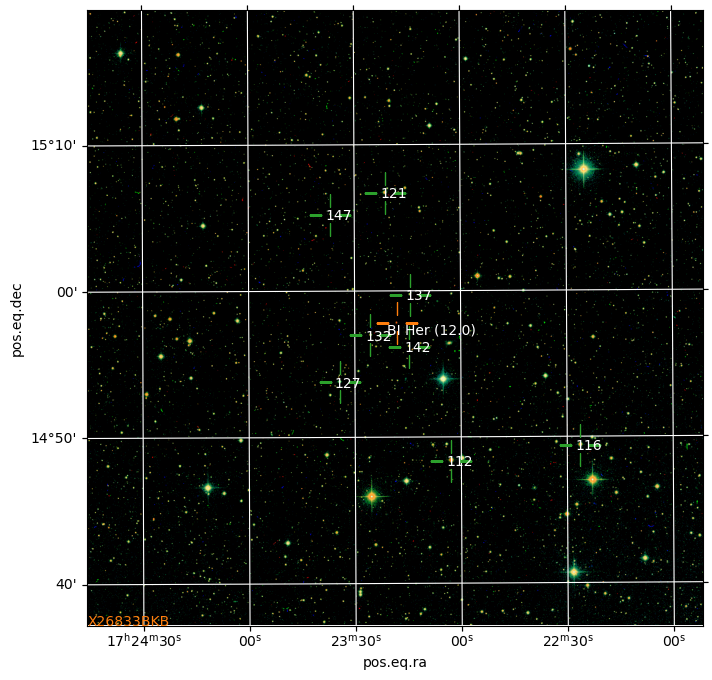

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

J346792:R675236 (BI Her) 14 January 2020 06:37:45 UTC
Filters: R V B
Getting 7366F17F from cache
BI Her seq:X26833BKB (8)


a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


jid 346792: (BI Her)
14 January 2020 06:37:45 UTC
Filters: ('R', 'V', 'B')
Getting 7366F17F from cache


a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


 GCVS  n_GCVS   RAJ2000     DEJ2000   VarType magMax      Period      SpType Exists  VarName  Simbad
                "h:m:s"     "d:m:s"            mag          d                                       
------ ------ ----------- ----------- ------- ------ ---------------- ------ ------ --------- ------
BI Her      x 17 23 18.13 +14 57 47.9       M 12.000   210.0000000000               BI    Her Simbad
['000-BKL-281', '112', '17:23:02.85', 260.76187134, '14:48:22.9', 14.8063612, '12.782 (—)', '11.193 (—)', '1.589 (—)', '10.347 (0.029)']
['000-BKL-282', '116', '17:22:26.27', 260.60946655, '14:49:24.3', 14.82341671, '12.712 (—)', '11.554 (—)', '1.158 (—)', '11.017 (0.029)']
['000-BKL-283', '121', '17:23:21.33', 260.83886719, '15:06:43.0', 15.1119442, '13.124 (0.025)', '12.094 (0.017)', '1.030 (0.030)', '11.514 (0.025)']
['000-BKL-284', '127', '17:23:34.36', 260.89315796, '14:53:46.1', 14.89613914, '13.208 (—)', '12.670 (—)', '0.538 (—)', '12.433 (0.019)']
['000-BKL-285', '132', '17:23:25.5

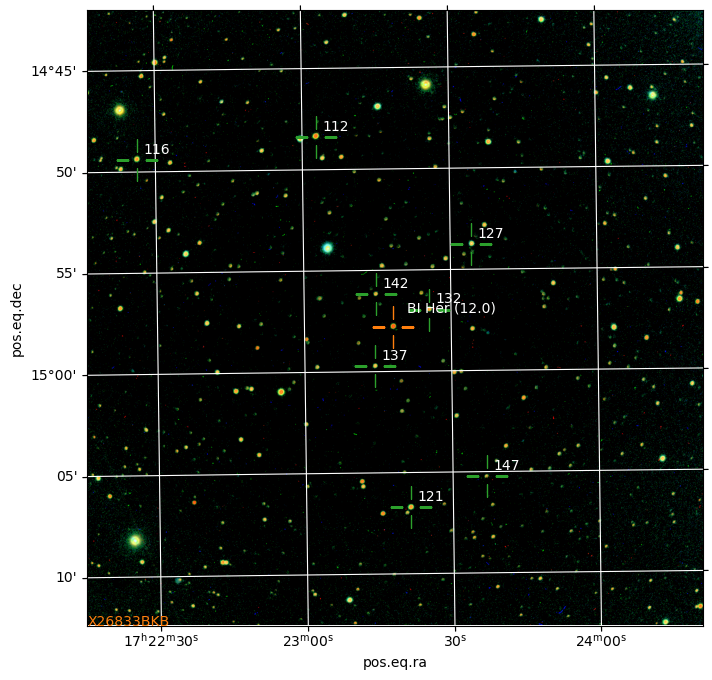

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

J393513:R737348 (BI Her) 22 March 2022 02:21:41 UTC
Filters: R V B
Solving for 44B7EAE8
solve-field -p -l 120 -O -L 1 -H 2 -u app -3 260.825000 -4 14.963333 -5 5 /tmp/field-solvervms_it7b/tmpa2fo5u2y.fits


a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


BI Her seq:X26833BKB (8)
jid 393513: (BI Her)
22 March 2022 02:21:41 UTC
Filters: ('R', 'V', 'B')
Getting 44B7EAE8 from cache
 GCVS  n_GCVS   RAJ2000     DEJ2000   VarType magMax      Period      SpType Exists  VarName  Simbad
                'h:m:s'     'd:m:s'            mag          d                                       
------ ------ ----------- ----------- ------- ------ ---------------- ------ ------ --------- ------
BI Her      x 17 23 18.13 +14 57 47.9       M 12.000   210.0000000000               BI    Her Simbad
['000-BKL-281', '112', '17:23:02.85', 260.76187134, '14:48:22.9', 14.8063612, '12.782 (—)', '11.193 (—)', '1.589 (—)', '10.347 (0.029)']
['000-BKL-282', '116', '17:22:26.27', 260.60946655, '14:49:24.3', 14.82341671, '12.712 (—)', '11.554 (—)', '1.158 (—)', '11.017 (0.029)']
['000-BKL-283', '121', '17:23:21.33', 260.83886719, '15:06:43.0', 15.1119442, '13.124 (0.025)', '12.094 (0.017)', '1.030 (0.030)', '11.514 (0.025)']
['000-BKL-284', '127', '17:23:34.36', 260.8931

a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


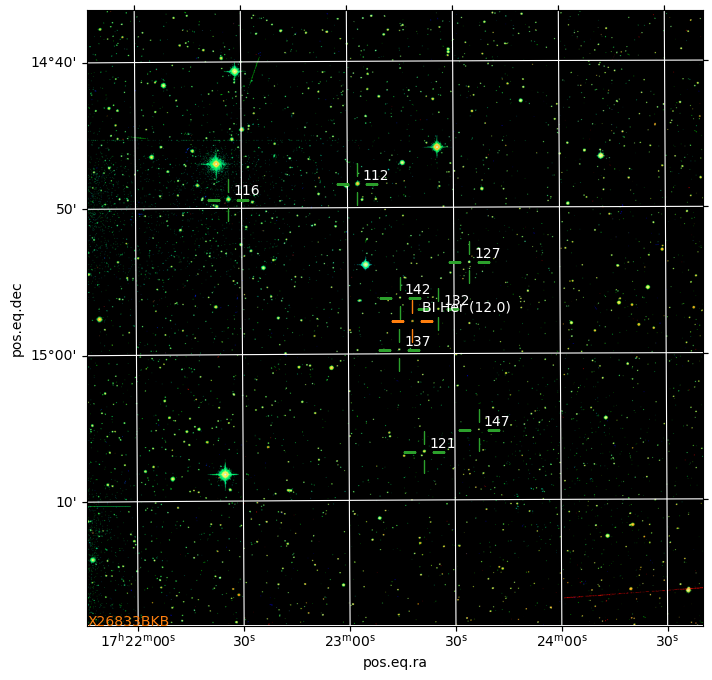

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

J349868:R678504 (BI Her) 14 February 2020 06:06:04 UTC
Filters: R V B
Getting 15A11513 from cache
BI Her seq:X26833BKB (8)


a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


jid 349868: (BI Her)
14 February 2020 06:06:04 UTC
Filters: ('R', 'V', 'B')
Getting 15A11513 from cache
 GCVS  n_GCVS   RAJ2000     DEJ2000   VarType magMax      Period      SpType Exists  VarName  Simbad
                "h:m:s"     "d:m:s"            mag          d                                       
------ ------ ----------- ----------- ------- ------ ---------------- ------ ------ --------- ------
BI Her      x 17 23 18.13 +14 57 47.9       M 12.000   210.0000000000               BI    Her Simbad
['000-BKL-281', '112', '17:23:02.85', 260.76187134, '14:48:22.9', 14.8063612, '12.782 (—)', '11.193 (—)', '1.589 (—)', '10.347 (0.029)']
['000-BKL-282', '116', '17:22:26.27', 260.60946655, '14:49:24.3', 14.82341671, '12.712 (—)', '11.554 (—)', '1.158 (—)', '11.017 (0.029)']
['000-BKL-283', '121', '17:23:21.33', 260.83886719, '15:06:43.0', 15.1119442, '13.124 (0.025)', '12.094 (0.017)', '1.030 (0.030)', '11.514 (0.025)']
['000-BKL-284', '127', '17:23:34.36', 260.89315796, '14:53:46.1', 14

a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


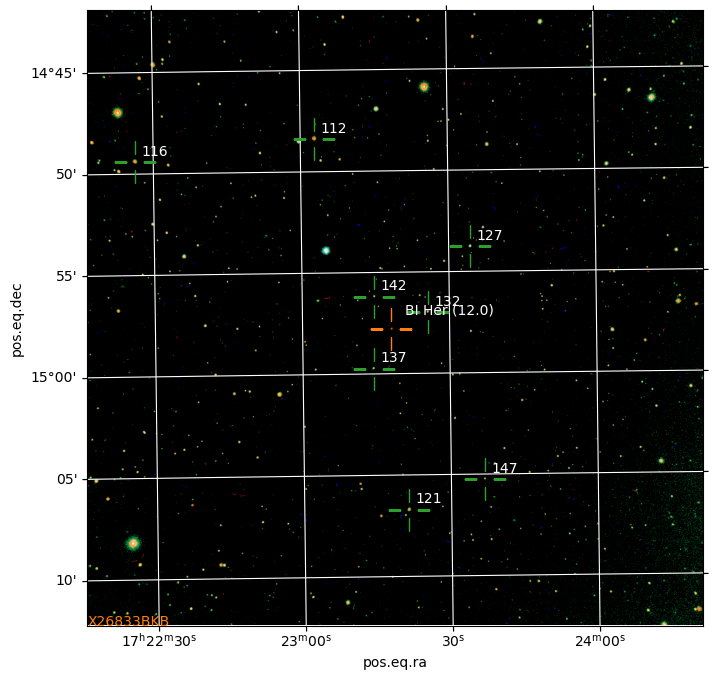

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

J348460:R677006 (BI Her) 29 January 2020 05:56:52 UTC
Filters: R V B
Getting 4CFA1D29 from cache
BI Her seq:X26833BKB (8)


a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


jid 348460: (BI Her)
29 January 2020 05:56:52 UTC
Filters: ('R', 'V', 'B')
Getting 4CFA1D29 from cache
 GCVS  n_GCVS   RAJ2000     DEJ2000   VarType magMax      Period      SpType Exists  VarName  Simbad
                "h:m:s"     "d:m:s"            mag          d                                       
------ ------ ----------- ----------- ------- ------ ---------------- ------ ------ --------- ------
BI Her      x 17 23 18.13 +14 57 47.9       M 12.000   210.0000000000               BI    Her Simbad
['000-BKL-281', '112', '17:23:02.85', 260.76187134, '14:48:22.9', 14.8063612, '12.782 (—)', '11.193 (—)', '1.589 (—)', '10.347 (0.029)']
['000-BKL-282', '116', '17:22:26.27', 260.60946655, '14:49:24.3', 14.82341671, '12.712 (—)', '11.554 (—)', '1.158 (—)', '11.017 (0.029)']
['000-BKL-283', '121', '17:23:21.33', 260.83886719, '15:06:43.0', 15.1119442, '13.124 (0.025)', '12.094 (0.017)', '1.030 (0.030)', '11.514 (0.025)']
['000-BKL-284', '127', '17:23:34.36', 260.89315796, '14:53:46.1', 14.

a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


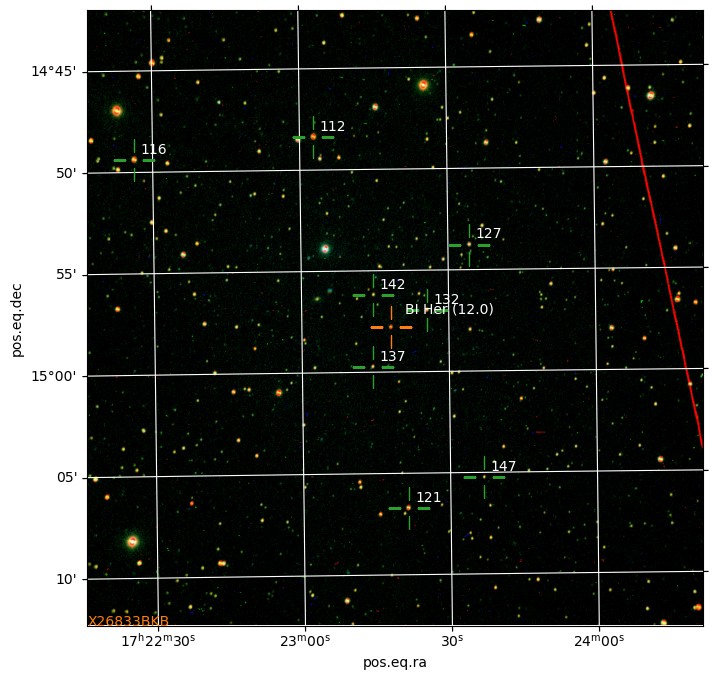

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

J399405:R744382 (BI Her) 10 September 2022 22:16:47 UTC
Filters: R V B
Getting A1FAE810 from cache
BI Her seq:X26833BKB (8)


a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


jid 399405: (BI Her)
10 September 2022 22:16:47 UTC
Filters: ('R', 'V', 'B')
Getting A1FAE810 from cache
 GCVS  n_GCVS   RAJ2000     DEJ2000   VarType magMax      Period      SpType Exists  VarName  Simbad
                'h:m:s'     'd:m:s'            mag          d                                       
------ ------ ----------- ----------- ------- ------ ---------------- ------ ------ --------- ------
BI Her      x 17 23 18.13 +14 57 47.9       M 12.000   210.0000000000               BI    Her Simbad
['000-BKL-281', '112', '17:23:02.85', 260.76187134, '14:48:22.9', 14.8063612, '12.782 (—)', '11.193 (—)', '1.589 (—)', '10.347 (0.029)']
['000-BKL-282', '116', '17:22:26.27', 260.60946655, '14:49:24.3', 14.82341671, '12.712 (—)', '11.554 (—)', '1.158 (—)', '11.017 (0.029)']
['000-BKL-283', '121', '17:23:21.33', 260.83886719, '15:06:43.0', 15.1119442, '13.124 (0.025)', '12.094 (0.017)', '1.030 (0.030)', '11.514 (0.025)']
['000-BKL-284', '127', '17:23:34.36', 260.89315796, '14:53:46.1', 1

a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


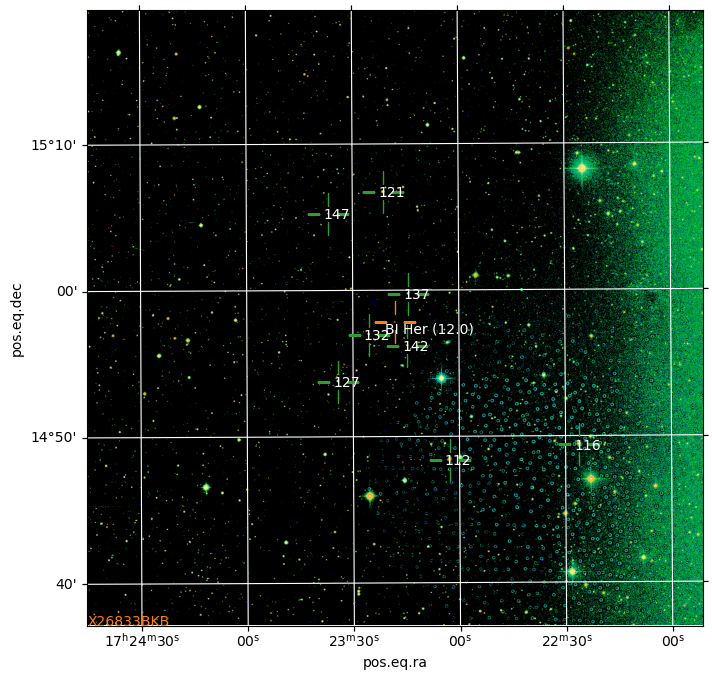

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

J391597:R734833 (BI Her) 22 January 2022 05:58:02 UTC
Filters: R V B
Solving for 6578FDB9
solve-field -p -l 120 -O -L 1 -H 2 -u app -3 260.825000 -4 14.963333 -5 5 /tmp/field-solver3pttzidd/tmp84isukh5.fits


a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


BI Her seq:X26833BKB (8)
jid 391597: (BI Her)
22 January 2022 05:58:02 UTC
Filters: ('R', 'V', 'B')
Getting 6578FDB9 from cache
 GCVS  n_GCVS   RAJ2000     DEJ2000   VarType magMax      Period      SpType Exists  VarName  Simbad
                'h:m:s'     'd:m:s'            mag          d                                       
------ ------ ----------- ----------- ------- ------ ---------------- ------ ------ --------- ------
BI Her      x 17 23 18.13 +14 57 47.9       M 12.000   210.0000000000               BI    Her Simbad
['000-BKL-281', '112', '17:23:02.85', 260.76187134, '14:48:22.9', 14.8063612, '12.782 (—)', '11.193 (—)', '1.589 (—)', '10.347 (0.029)']
['000-BKL-282', '116', '17:22:26.27', 260.60946655, '14:49:24.3', 14.82341671, '12.712 (—)', '11.554 (—)', '1.158 (—)', '11.017 (0.029)']
['000-BKL-283', '121', '17:23:21.33', 260.83886719, '15:06:43.0', 15.1119442, '13.124 (0.025)', '12.094 (0.017)', '1.030 (0.030)', '11.514 (0.025)']
['000-BKL-284', '127', '17:23:34.36', 260.89

a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


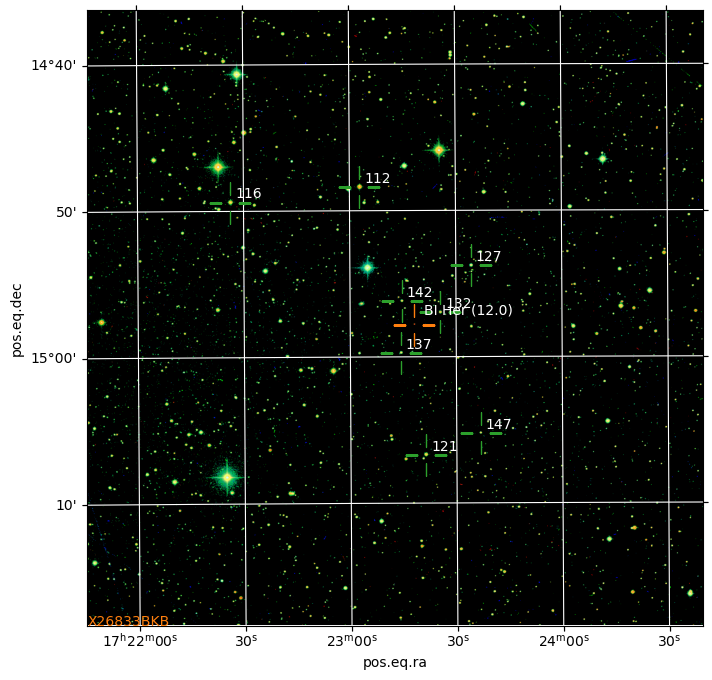

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

J393904:R737798 (BI Her) 1 April 2022 02:24:18 UTC
Filters: R V B
Solving for DC0E2976
solve-field -p -l 120 -O -L 1 -H 2 -u app -3 260.825000 -4 14.963333 -5 5 /tmp/field-solver_cel5bae/tmp8gzmty16.fits


a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


BI Her seq:X26833BKB (8)
jid 393904: (BI Her)
1 April 2022 02:24:18 UTC
Filters: ('R', 'V', 'B')
Getting DC0E2976 from cache
 GCVS  n_GCVS   RAJ2000     DEJ2000   VarType magMax      Period      SpType Exists  VarName  Simbad
                'h:m:s'     'd:m:s'            mag          d                                       
------ ------ ----------- ----------- ------- ------ ---------------- ------ ------ --------- ------
BI Her      x 17 23 18.13 +14 57 47.9       M 12.000   210.0000000000               BI    Her Simbad
['000-BKL-281', '112', '17:23:02.85', 260.76187134, '14:48:22.9', 14.8063612, '12.782 (—)', '11.193 (—)', '1.589 (—)', '10.347 (0.029)']
['000-BKL-282', '116', '17:22:26.27', 260.60946655, '14:49:24.3', 14.82341671, '12.712 (—)', '11.554 (—)', '1.158 (—)', '11.017 (0.029)']
['000-BKL-283', '121', '17:23:21.33', 260.83886719, '15:06:43.0', 15.1119442, '13.124 (0.025)', '12.094 (0.017)', '1.030 (0.030)', '11.514 (0.025)']
['000-BKL-284', '127', '17:23:34.36', 260.89315

a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


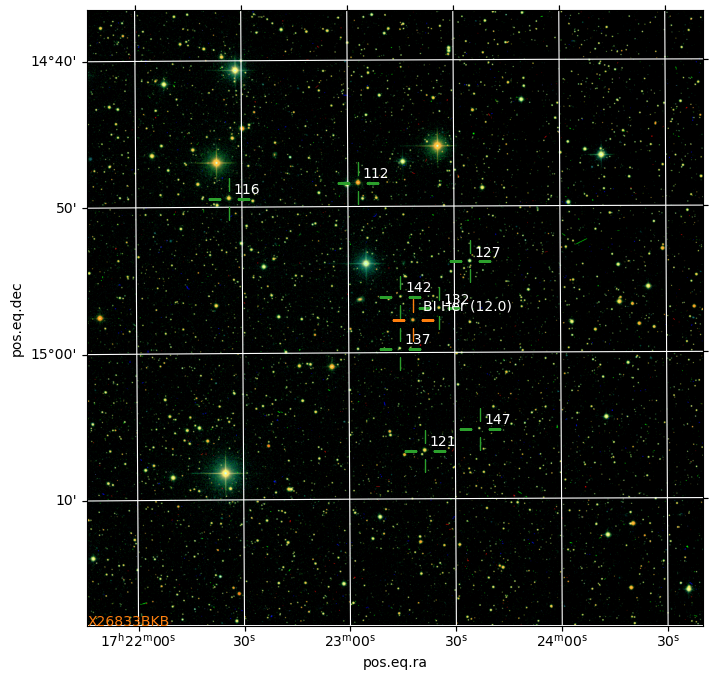

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

J348337:R676869 (BI Her) 28 January 2020 05:39:04 UTC
Filters: R V B
Getting 1A504DE9 from cache
BI Her seq:X26833BKB (8)


a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


jid 348337: (BI Her)
28 January 2020 05:39:04 UTC
Filters: ('R', 'V', 'B')
Getting 1A504DE9 from cache
 GCVS  n_GCVS   RAJ2000     DEJ2000   VarType magMax      Period      SpType Exists  VarName  Simbad
                "h:m:s"     "d:m:s"            mag          d                                       
------ ------ ----------- ----------- ------- ------ ---------------- ------ ------ --------- ------
BI Her      x 17 23 18.13 +14 57 47.9       M 12.000   210.0000000000               BI    Her Simbad
['000-BKL-281', '112', '17:23:02.85', 260.76187134, '14:48:22.9', 14.8063612, '12.782 (—)', '11.193 (—)', '1.589 (—)', '10.347 (0.029)']
['000-BKL-282', '116', '17:22:26.27', 260.60946655, '14:49:24.3', 14.82341671, '12.712 (—)', '11.554 (—)', '1.158 (—)', '11.017 (0.029)']
['000-BKL-283', '121', '17:23:21.33', 260.83886719, '15:06:43.0', 15.1119442, '13.124 (0.025)', '12.094 (0.017)', '1.030 (0.030)', '11.514 (0.025)']
['000-BKL-284', '127', '17:23:34.36', 260.89315796, '14:53:46.1', 14.

a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


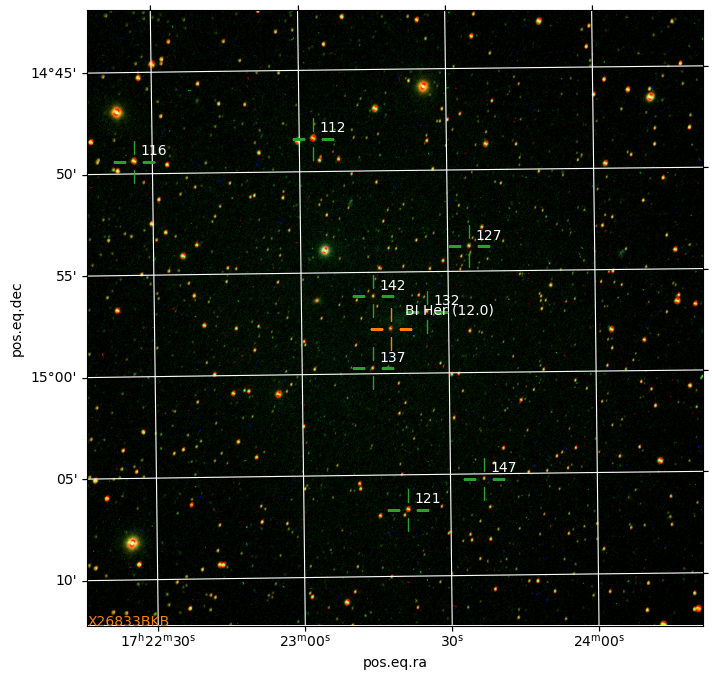

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

J382515:R724291 (BI Her) 15 August 2021 00:57:05 UTC
Filters: R V B
Getting 976F01FB from cache
BI Her seq:X26833BKB (8)


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]


jid 382515: (BI Her)
15 August 2021 00:57:05 UTC
Filters: ('R', 'V', 'B')
Getting 976F01FB from cache
 GCVS  n_GCVS   RAJ2000     DEJ2000   VarType magMax      Period      SpType Exists  VarName  Simbad
                "h:m:s"     "d:m:s"            mag          d                                       
------ ------ ----------- ----------- ------- ------ ---------------- ------ ------ --------- ------
BI Her      x 17 23 18.13 +14 57 47.9       M 12.000   210.0000000000               BI    Her Simbad
['000-BKL-281', '112', '17:23:02.85', 260.76187134, '14:48:22.9', 14.8063612, '12.782 (—)', '11.193 (—)', '1.589 (—)', '10.347 (0.029)']
['000-BKL-282', '116', '17:22:26.27', 260.60946655, '14:49:24.3', 14.82341671, '12.712 (—)', '11.554 (—)', '1.158 (—)', '11.017 (0.029)']
['000-BKL-283', '121', '17:23:21.33', 260.83886719, '15:06:43.0', 15.1119442, '13.124 (0.025)', '12.094 (0.017)', '1.030 (0.030)', '11.514 (0.025)']
['000-BKL-284', '127', '17:23:34.36', 260.89315796, '14:53:46.1', 14.8

the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]


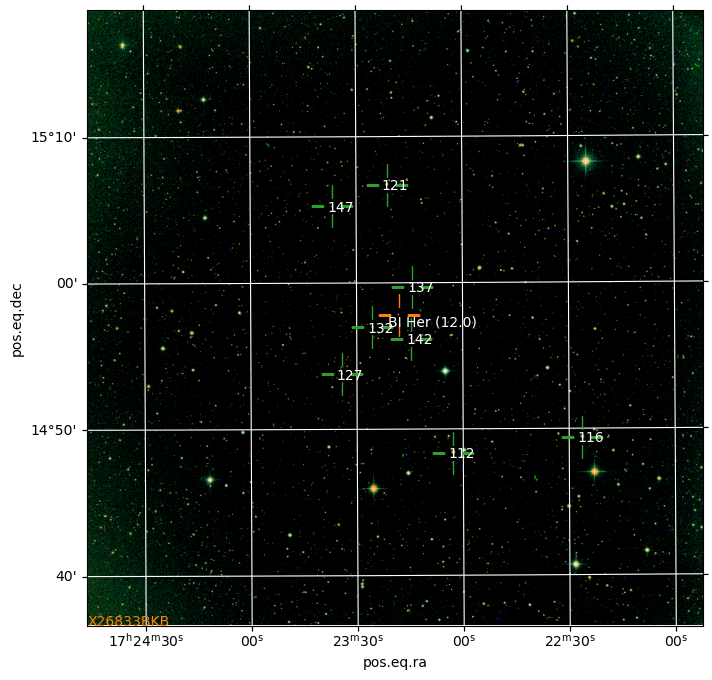

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

J348212:R676732 (BI Her) 27 January 2020 05:38:58 UTC
Filters: R V B
Getting 9E248068 from cache
BI Her seq:X26833BKB (8)


a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


jid 348212: (BI Her)
27 January 2020 05:38:58 UTC
Filters: ('R', 'V', 'B')
Getting 9E248068 from cache
 GCVS  n_GCVS   RAJ2000     DEJ2000   VarType magMax      Period      SpType Exists  VarName  Simbad
                "h:m:s"     "d:m:s"            mag          d                                       
------ ------ ----------- ----------- ------- ------ ---------------- ------ ------ --------- ------
BI Her      x 17 23 18.13 +14 57 47.9       M 12.000   210.0000000000               BI    Her Simbad
['000-BKL-281', '112', '17:23:02.85', 260.76187134, '14:48:22.9', 14.8063612, '12.782 (—)', '11.193 (—)', '1.589 (—)', '10.347 (0.029)']
['000-BKL-282', '116', '17:22:26.27', 260.60946655, '14:49:24.3', 14.82341671, '12.712 (—)', '11.554 (—)', '1.158 (—)', '11.017 (0.029)']
['000-BKL-283', '121', '17:23:21.33', 260.83886719, '15:06:43.0', 15.1119442, '13.124 (0.025)', '12.094 (0.017)', '1.030 (0.030)', '11.514 (0.025)']
['000-BKL-284', '127', '17:23:34.36', 260.89315796, '14:53:46.1', 14.

a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


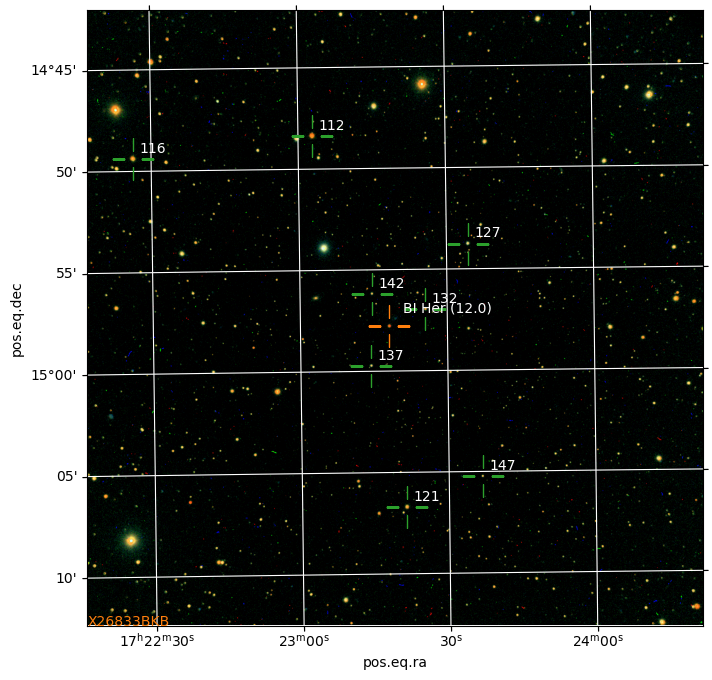

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

J347318:R675782 (BI Her) 18 January 2020 06:17:37 UTC
Filters: R V B
Getting 4B9056BE from cache
BI Her seq:X26833BKB (8)


a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


jid 347318: (BI Her)
18 January 2020 06:17:37 UTC
Filters: ('R', 'V', 'B')
Getting 4B9056BE from cache
 GCVS  n_GCVS   RAJ2000     DEJ2000   VarType magMax      Period      SpType Exists  VarName  Simbad
                "h:m:s"     "d:m:s"            mag          d                                       
------ ------ ----------- ----------- ------- ------ ---------------- ------ ------ --------- ------
BI Her      x 17 23 18.13 +14 57 47.9       M 12.000   210.0000000000               BI    Her Simbad
['000-BKL-281', '112', '17:23:02.85', 260.76187134, '14:48:22.9', 14.8063612, '12.782 (—)', '11.193 (—)', '1.589 (—)', '10.347 (0.029)']
['000-BKL-282', '116', '17:22:26.27', 260.60946655, '14:49:24.3', 14.82341671, '12.712 (—)', '11.554 (—)', '1.158 (—)', '11.017 (0.029)']
['000-BKL-283', '121', '17:23:21.33', 260.83886719, '15:06:43.0', 15.1119442, '13.124 (0.025)', '12.094 (0.017)', '1.030 (0.030)', '11.514 (0.025)']
['000-BKL-284', '127', '17:23:34.36', 260.89315796, '14:53:46.1', 14.

a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


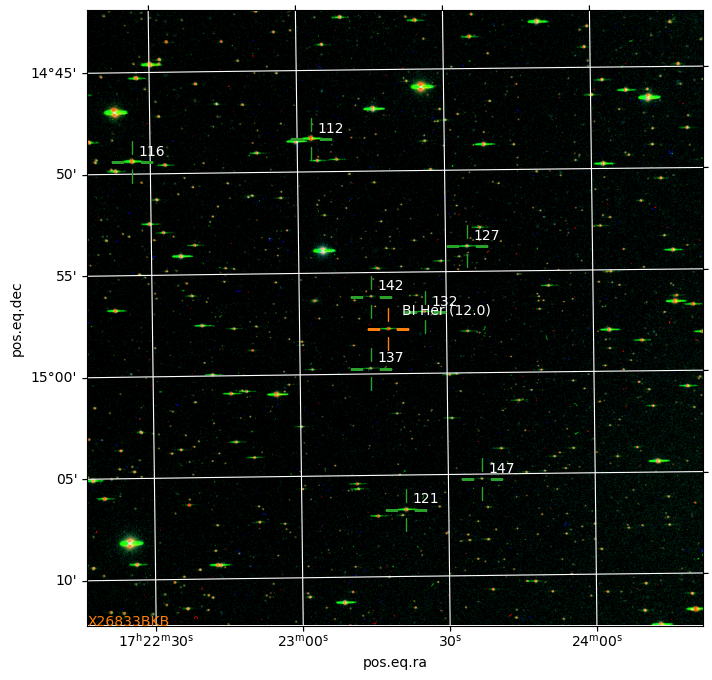

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

J339768:R667474 (BI Her) 25 September 2019 21:22:29 UTC
Filters: R V B
Getting 4BD1002D from cache
BI Her seq:X26833BKB (8)


a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


jid 339768: (BI Her)
25 September 2019 21:22:29 UTC
Filters: ('R', 'V', 'B')
Getting 4BD1002D from cache
 GCVS  n_GCVS   RAJ2000     DEJ2000   VarType magMax      Period      SpType Exists  VarName  Simbad
                "h:m:s"     "d:m:s"            mag          d                                       
------ ------ ----------- ----------- ------- ------ ---------------- ------ ------ --------- ------
BI Her      x 17 23 18.13 +14 57 47.9       M 12.000   210.0000000000               BI    Her Simbad
['000-BKL-281', '112', '17:23:02.85', 260.76187134, '14:48:22.9', 14.8063612, '12.782 (—)', '11.193 (—)', '1.589 (—)', '10.347 (0.029)']
['000-BKL-282', '116', '17:22:26.27', 260.60946655, '14:49:24.3', 14.82341671, '12.712 (—)', '11.554 (—)', '1.158 (—)', '11.017 (0.029)']
['000-BKL-283', '121', '17:23:21.33', 260.83886719, '15:06:43.0', 15.1119442, '13.124 (0.025)', '12.094 (0.017)', '1.030 (0.030)', '11.514 (0.025)']
['000-BKL-284', '127', '17:23:34.36', 260.89315796, '14:53:46.1', 1

a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


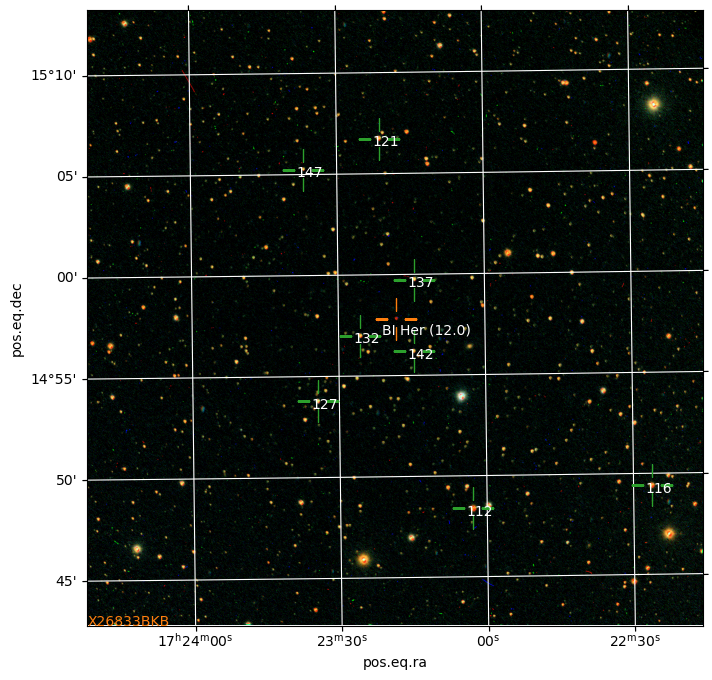

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

J350522:R679208 (BI Her) 22 February 2020 03:58:51 UTC
Filters: R V B
Getting 0EE1E585 from cache
BI Her seq:X26833BKB (8)


a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


jid 350522: (BI Her)
22 February 2020 03:58:51 UTC
Filters: ('R', 'V', 'B')
Getting 0EE1E585 from cache
 GCVS  n_GCVS   RAJ2000     DEJ2000   VarType magMax      Period      SpType Exists  VarName  Simbad
                "h:m:s"     "d:m:s"            mag          d                                       
------ ------ ----------- ----------- ------- ------ ---------------- ------ ------ --------- ------
BI Her      x 17 23 18.13 +14 57 47.9       M 12.000   210.0000000000               BI    Her Simbad
['000-BKL-281', '112', '17:23:02.85', 260.76187134, '14:48:22.9', 14.8063612, '12.782 (—)', '11.193 (—)', '1.589 (—)', '10.347 (0.029)']
['000-BKL-282', '116', '17:22:26.27', 260.60946655, '14:49:24.3', 14.82341671, '12.712 (—)', '11.554 (—)', '1.158 (—)', '11.017 (0.029)']
['000-BKL-283', '121', '17:23:21.33', 260.83886719, '15:06:43.0', 15.1119442, '13.124 (0.025)', '12.094 (0.017)', '1.030 (0.030)', '11.514 (0.025)']
['000-BKL-284', '127', '17:23:34.36', 260.89315796, '14:53:46.1', 14

a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


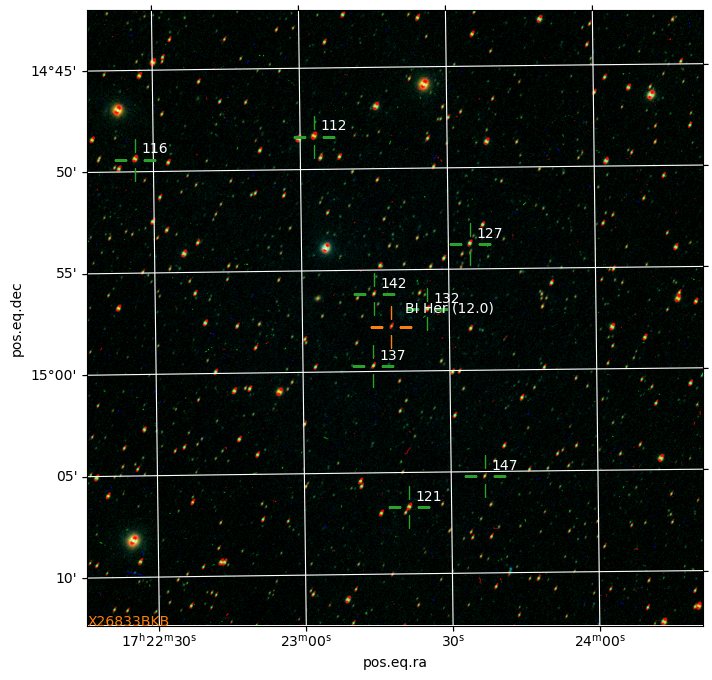

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

J355386:R685127 (BI Her) 1 June 2020 04:55:42 UTC
Filters: R V B
Getting 0DD7F12E from cache
BI Her seq:X26833BKB (8)


a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


jid 355386: (BI Her)
1 June 2020 04:55:42 UTC
Filters: ('R', 'V', 'B')
Getting 0DD7F12E from cache
 GCVS  n_GCVS   RAJ2000     DEJ2000   VarType magMax      Period      SpType Exists  VarName  Simbad
                "h:m:s"     "d:m:s"            mag          d                                       
------ ------ ----------- ----------- ------- ------ ---------------- ------ ------ --------- ------
BI Her      x 17 23 18.13 +14 57 47.9       M 12.000   210.0000000000               BI    Her Simbad
['000-BKL-281', '112', '17:23:02.85', 260.76187134, '14:48:22.9', 14.8063612, '12.782 (—)', '11.193 (—)', '1.589 (—)', '10.347 (0.029)']
['000-BKL-282', '116', '17:22:26.27', 260.60946655, '14:49:24.3', 14.82341671, '12.712 (—)', '11.554 (—)', '1.158 (—)', '11.017 (0.029)']
['000-BKL-283', '121', '17:23:21.33', 260.83886719, '15:06:43.0', 15.1119442, '13.124 (0.025)', '12.094 (0.017)', '1.030 (0.030)', '11.514 (0.025)']
['000-BKL-284', '127', '17:23:34.36', 260.89315796, '14:53:46.1', 14.8961

a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


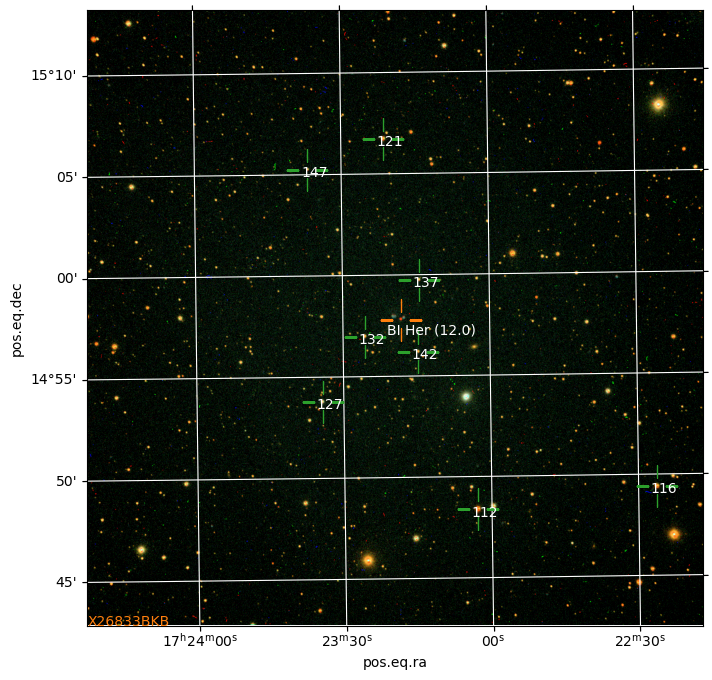

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

J397372:R741974 (BI Her) 30 July 2022 02:28:02 UTC
Filters: R V B
Solving for B2B27B27
solve-field -p -l 120 -O -L 1 -H 2 -u app -3 260.825000 -4 14.963333 -5 5 /tmp/field-solver2e2zf674/tmpjgxeh2sw.fits


a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


BI Her seq:X26833BKB (8)
jid 397372: (BI Her)
30 July 2022 02:28:02 UTC
Filters: ('R', 'V', 'B')
Getting B2B27B27 from cache
 GCVS  n_GCVS   RAJ2000     DEJ2000   VarType magMax      Period      SpType Exists  VarName  Simbad
                'h:m:s'     'd:m:s'            mag          d                                       
------ ------ ----------- ----------- ------- ------ ---------------- ------ ------ --------- ------
BI Her      x 17 23 18.13 +14 57 47.9       M 12.000   210.0000000000               BI    Her Simbad
['000-BKL-281', '112', '17:23:02.85', 260.76187134, '14:48:22.9', 14.8063612, '12.782 (—)', '11.193 (—)', '1.589 (—)', '10.347 (0.029)']
['000-BKL-282', '116', '17:22:26.27', 260.60946655, '14:49:24.3', 14.82341671, '12.712 (—)', '11.554 (—)', '1.158 (—)', '11.017 (0.029)']
['000-BKL-283', '121', '17:23:21.33', 260.83886719, '15:06:43.0', 15.1119442, '13.124 (0.025)', '12.094 (0.017)', '1.030 (0.030)', '11.514 (0.025)']
['000-BKL-284', '127', '17:23:34.36', 260.89315

a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


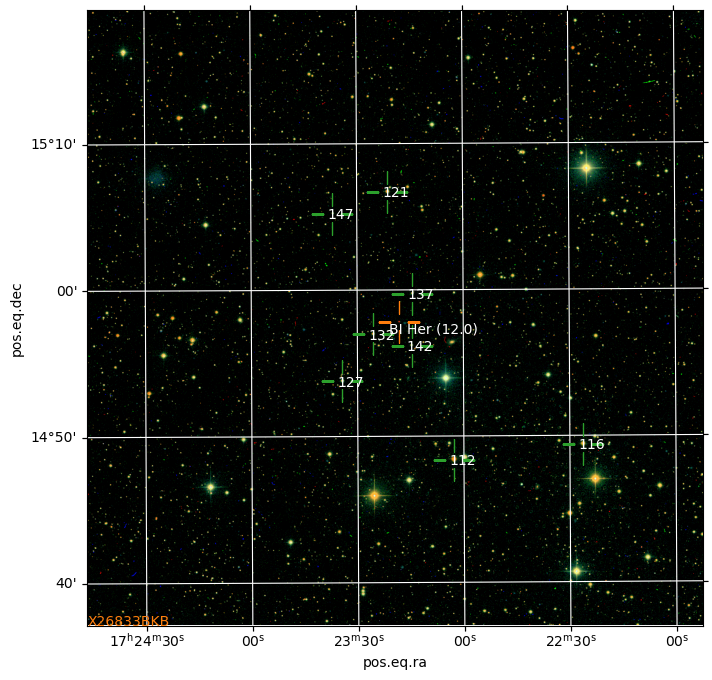

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

J340157:R668022 (BI Her) 9 January 2020 06:52:16 UTC
Filters: R V B
Getting A9773329 from cache
BI Her seq:X26833BKB (8)


a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


jid 340157: (BI Her)
9 January 2020 06:52:16 UTC
Filters: ('R', 'V', 'B')
Getting A9773329 from cache
 GCVS  n_GCVS   RAJ2000     DEJ2000   VarType magMax      Period      SpType Exists  VarName  Simbad
                "h:m:s"     "d:m:s"            mag          d                                       
------ ------ ----------- ----------- ------- ------ ---------------- ------ ------ --------- ------
BI Her      x 17 23 18.13 +14 57 47.9       M 12.000   210.0000000000               BI    Her Simbad
['000-BKL-281', '112', '17:23:02.85', 260.76187134, '14:48:22.9', 14.8063612, '12.782 (—)', '11.193 (—)', '1.589 (—)', '10.347 (0.029)']
['000-BKL-282', '116', '17:22:26.27', 260.60946655, '14:49:24.3', 14.82341671, '12.712 (—)', '11.554 (—)', '1.158 (—)', '11.017 (0.029)']
['000-BKL-283', '121', '17:23:21.33', 260.83886719, '15:06:43.0', 15.1119442, '13.124 (0.025)', '12.094 (0.017)', '1.030 (0.030)', '11.514 (0.025)']
['000-BKL-284', '127', '17:23:34.36', 260.89315796, '14:53:46.1', 14.8

a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


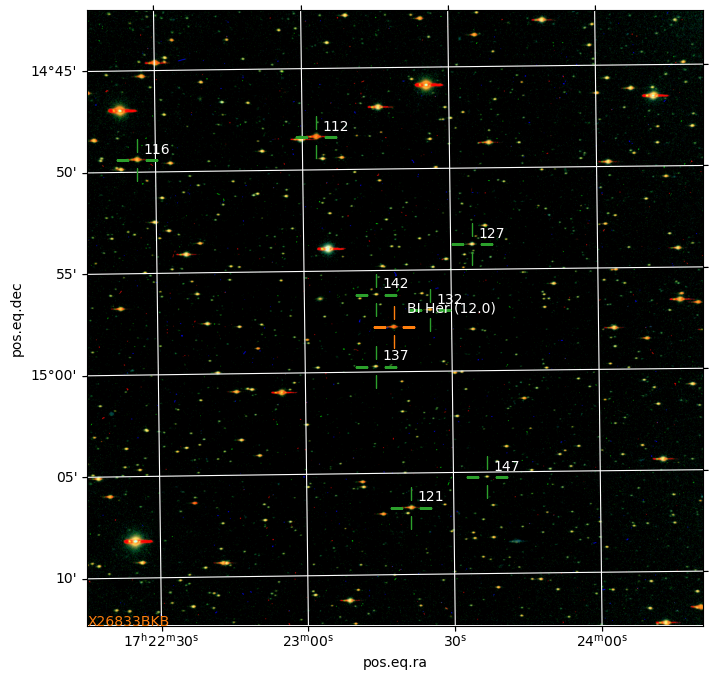

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

J388155:R730751 (BI Her) 7 November 2021 19:42:48 UTC
Filters: R V B
Solving for 1434F704
solve-field -p -l 120 -O -L 1 -H 2 -u app -3 260.825000 -4 14.963333 -5 5 /tmp/field-solverpztgqlj0/tmpg_2_mg7s.fits


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]


BI Her seq:X26833BKB (8)
jid 388155: (BI Her)
7 November 2021 19:42:48 UTC
Filters: ('R', 'V', 'B')
Getting 1434F704 from cache
 GCVS  n_GCVS   RAJ2000     DEJ2000   VarType magMax      Period      SpType Exists  VarName  Simbad
                'h:m:s'     'd:m:s'            mag          d                                       
------ ------ ----------- ----------- ------- ------ ---------------- ------ ------ --------- ------
BI Her      x 17 23 18.13 +14 57 47.9       M 12.000   210.0000000000               BI    Her Simbad
['000-BKL-281', '112', '17:23:02.85', 260.76187134, '14:48:22.9', 14.8063612, '12.782 (—)', '11.193 (—)', '1.589 (—)', '10.347 (0.029)']
['000-BKL-282', '116', '17:22:26.27', 260.60946655, '14:49:24.3', 14.82341671, '12.712 (—)', '11.554 (—)', '1.158 (—)', '11.017 (0.029)']
['000-BKL-283', '121', '17:23:21.33', 260.83886719, '15:06:43.0', 15.1119442, '13.124 (0.025)', '12.094 (0.017)', '1.030 (0.030)', '11.514 (0.025)']
['000-BKL-284', '127', '17:23:34.36', 260.89

the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]


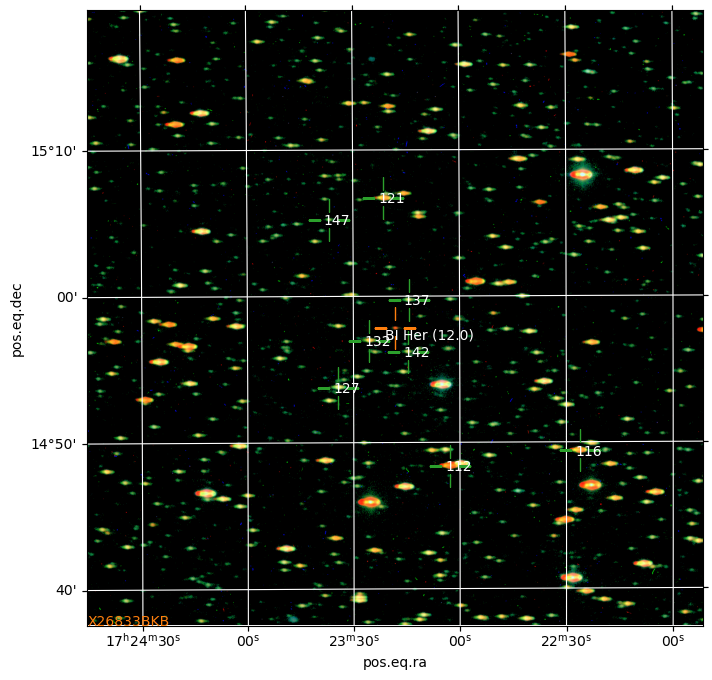

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

J347464:R675932 (BI Her) 19 January 2020 06:27:04 UTC
Filters: R V B
Getting 36198571 from cache
BI Her seq:X26833BKB (8)


a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


jid 347464: (BI Her)
19 January 2020 06:27:04 UTC
Filters: ('R', 'V', 'B')
Getting 36198571 from cache
 GCVS  n_GCVS   RAJ2000     DEJ2000   VarType magMax      Period      SpType Exists  VarName  Simbad
                "h:m:s"     "d:m:s"            mag          d                                       
------ ------ ----------- ----------- ------- ------ ---------------- ------ ------ --------- ------
BI Her      x 17 23 18.13 +14 57 47.9       M 12.000   210.0000000000               BI    Her Simbad
['000-BKL-281', '112', '17:23:02.85', 260.76187134, '14:48:22.9', 14.8063612, '12.782 (—)', '11.193 (—)', '1.589 (—)', '10.347 (0.029)']
['000-BKL-282', '116', '17:22:26.27', 260.60946655, '14:49:24.3', 14.82341671, '12.712 (—)', '11.554 (—)', '1.158 (—)', '11.017 (0.029)']
['000-BKL-283', '121', '17:23:21.33', 260.83886719, '15:06:43.0', 15.1119442, '13.124 (0.025)', '12.094 (0.017)', '1.030 (0.030)', '11.514 (0.025)']
['000-BKL-284', '127', '17:23:34.36', 260.89315796, '14:53:46.1', 14.

a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


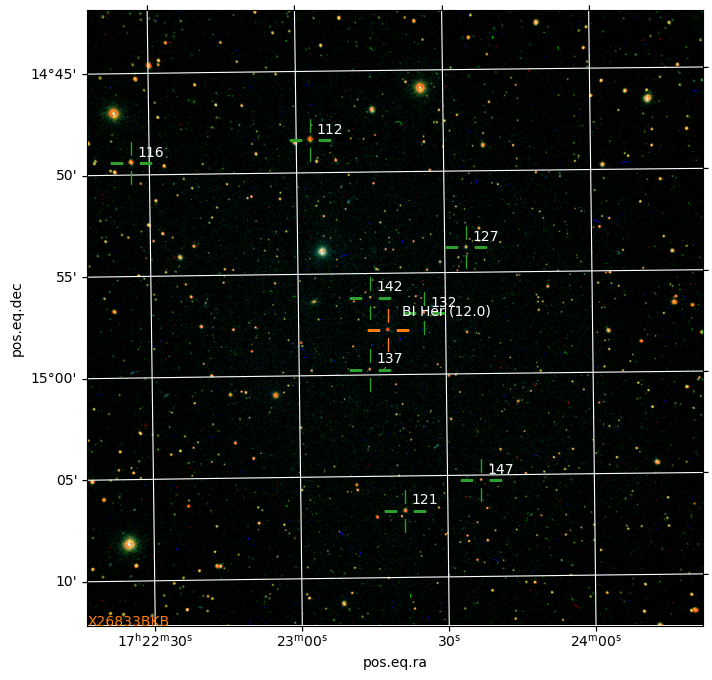

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

J352201:R681000 (BI Her) 14 March 2020 02:40:45 UTC
Filters: R V B
Getting DE4E7ADA from cache
BI Her seq:X26833BKB (8)


a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


jid 352201: (BI Her)
14 March 2020 02:40:45 UTC
Filters: ('R', 'V', 'B')
Getting DE4E7ADA from cache
 GCVS  n_GCVS   RAJ2000     DEJ2000   VarType magMax      Period      SpType Exists  VarName  Simbad
                "h:m:s"     "d:m:s"            mag          d                                       
------ ------ ----------- ----------- ------- ------ ---------------- ------ ------ --------- ------
BI Her      x 17 23 18.13 +14 57 47.9       M 12.000   210.0000000000               BI    Her Simbad
['000-BKL-281', '112', '17:23:02.85', 260.76187134, '14:48:22.9', 14.8063612, '12.782 (—)', '11.193 (—)', '1.589 (—)', '10.347 (0.029)']
['000-BKL-282', '116', '17:22:26.27', 260.60946655, '14:49:24.3', 14.82341671, '12.712 (—)', '11.554 (—)', '1.158 (—)', '11.017 (0.029)']
['000-BKL-283', '121', '17:23:21.33', 260.83886719, '15:06:43.0', 15.1119442, '13.124 (0.025)', '12.094 (0.017)', '1.030 (0.030)', '11.514 (0.025)']
['000-BKL-284', '127', '17:23:34.36', 260.89315796, '14:53:46.1', 14.89

a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


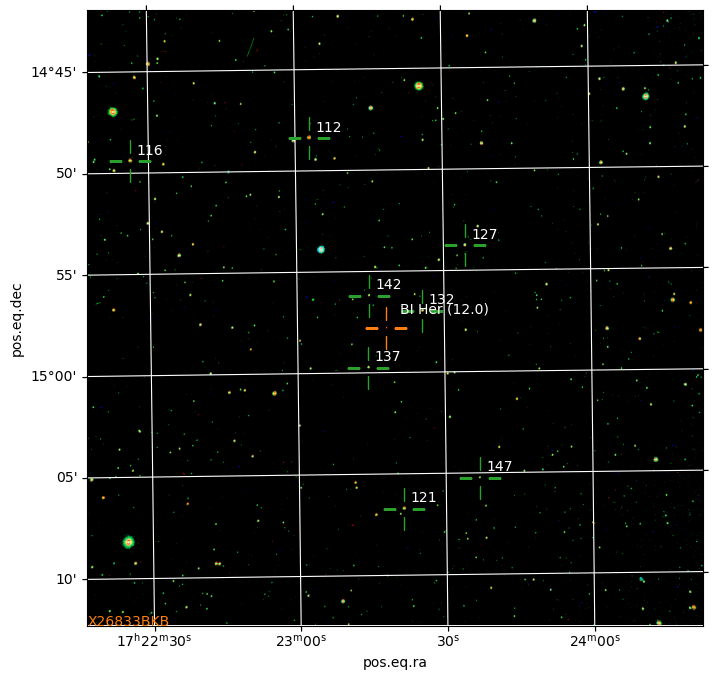

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

J396489:R740864 (BI Her) 30 June 2022 00:59:51 UTC
Filters: R V B
Solving for 8599D6C8
solve-field -p -l 120 -O -L 1 -H 2 -u app -3 260.825000 -4 14.963333 -5 5 /tmp/field-solvertt_fdoyc/tmpns2kk8jh.fits


a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


BI Her seq:X26833BKB (8)
jid 396489: (BI Her)
30 June 2022 00:59:51 UTC
Filters: ('R', 'V', 'B')
Getting 8599D6C8 from cache
 GCVS  n_GCVS   RAJ2000     DEJ2000   VarType magMax      Period      SpType Exists  VarName  Simbad
                'h:m:s'     'd:m:s'            mag          d                                       
------ ------ ----------- ----------- ------- ------ ---------------- ------ ------ --------- ------
BI Her      x 17 23 18.13 +14 57 47.9       M 12.000   210.0000000000               BI    Her Simbad
['000-BKL-281', '112', '17:23:02.85', 260.76187134, '14:48:22.9', 14.8063612, '12.782 (—)', '11.193 (—)', '1.589 (—)', '10.347 (0.029)']
['000-BKL-282', '116', '17:22:26.27', 260.60946655, '14:49:24.3', 14.82341671, '12.712 (—)', '11.554 (—)', '1.158 (—)', '11.017 (0.029)']
['000-BKL-283', '121', '17:23:21.33', 260.83886719, '15:06:43.0', 15.1119442, '13.124 (0.025)', '12.094 (0.017)', '1.030 (0.030)', '11.514 (0.025)']
['000-BKL-284', '127', '17:23:34.36', 260.89315

a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


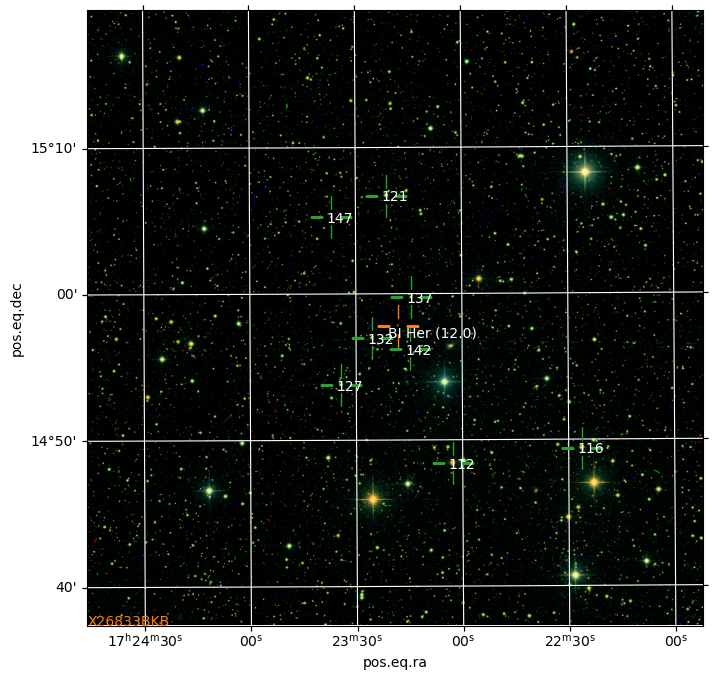

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

J395471:R739635 (BI Her) 1 May 2022 01:06:23 UTC
Filters: R V B
Solving for A81CD7D2
solve-field -p -l 120 -O -L 1 -H 2 -u app -3 260.825000 -4 14.963333 -5 5 /tmp/field-solverke36qof5/tmpql9ks8jb.fits


a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


BI Her seq:X26833BKB (8)
jid 395471: (BI Her)
1 May 2022 01:06:23 UTC
Filters: ('R', 'V', 'B')
Getting A81CD7D2 from cache
 GCVS  n_GCVS   RAJ2000     DEJ2000   VarType magMax      Period      SpType Exists  VarName  Simbad
                'h:m:s'     'd:m:s'            mag          d                                       
------ ------ ----------- ----------- ------- ------ ---------------- ------ ------ --------- ------
BI Her      x 17 23 18.13 +14 57 47.9       M 12.000   210.0000000000               BI    Her Simbad
['000-BKL-281', '112', '17:23:02.85', 260.76187134, '14:48:22.9', 14.8063612, '12.782 (—)', '11.193 (—)', '1.589 (—)', '10.347 (0.029)']
['000-BKL-282', '116', '17:22:26.27', 260.60946655, '14:49:24.3', 14.82341671, '12.712 (—)', '11.554 (—)', '1.158 (—)', '11.017 (0.029)']
['000-BKL-283', '121', '17:23:21.33', 260.83886719, '15:06:43.0', 15.1119442, '13.124 (0.025)', '12.094 (0.017)', '1.030 (0.030)', '11.514 (0.025)']
['000-BKL-284', '127', '17:23:34.36', 260.8931579

a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


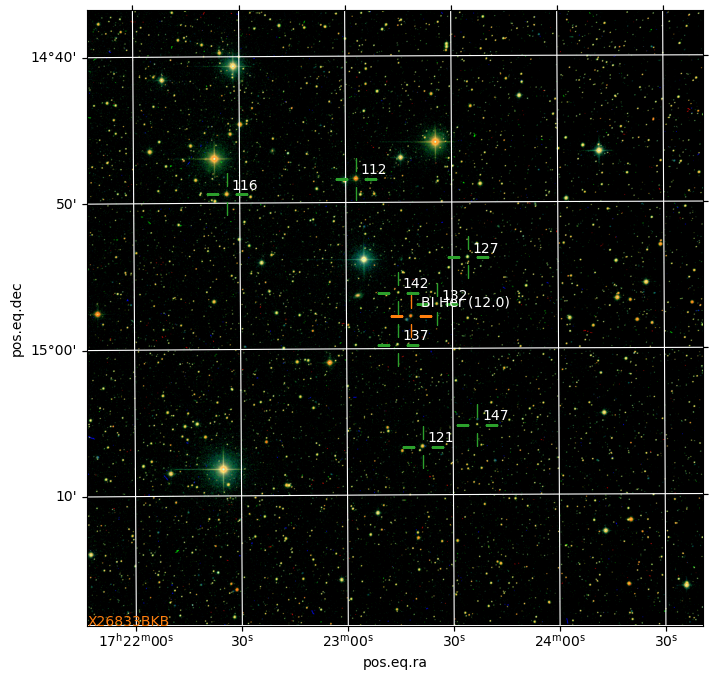

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

J387027:R729455 (BI Her) 19 October 2021 19:36:44 UTC
Filters: R V B
Solving for B2431634
solve-field -p -l 120 -O -L 1 -H 2 -u app -3 260.825000 -4 14.963333 -5 5 /tmp/field-solverpnlcdaas/tmp_wjxllcr.fits


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]


BI Her seq:X26833BKB (8)
jid 387027: (BI Her)
19 October 2021 19:36:44 UTC
Filters: ('R', 'V', 'B')
Getting B2431634 from cache
 GCVS  n_GCVS   RAJ2000     DEJ2000   VarType magMax      Period      SpType Exists  VarName  Simbad
                'h:m:s'     'd:m:s'            mag          d                                       
------ ------ ----------- ----------- ------- ------ ---------------- ------ ------ --------- ------
BI Her      x 17 23 18.13 +14 57 47.9       M 12.000   210.0000000000               BI    Her Simbad
['000-BKL-281', '112', '17:23:02.85', 260.76187134, '14:48:22.9', 14.8063612, '12.782 (—)', '11.193 (—)', '1.589 (—)', '10.347 (0.029)']
['000-BKL-282', '116', '17:22:26.27', 260.60946655, '14:49:24.3', 14.82341671, '12.712 (—)', '11.554 (—)', '1.158 (—)', '11.017 (0.029)']
['000-BKL-283', '121', '17:23:21.33', 260.83886719, '15:06:43.0', 15.1119442, '13.124 (0.025)', '12.094 (0.017)', '1.030 (0.030)', '11.514 (0.025)']
['000-BKL-284', '127', '17:23:34.36', 260.89

the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]


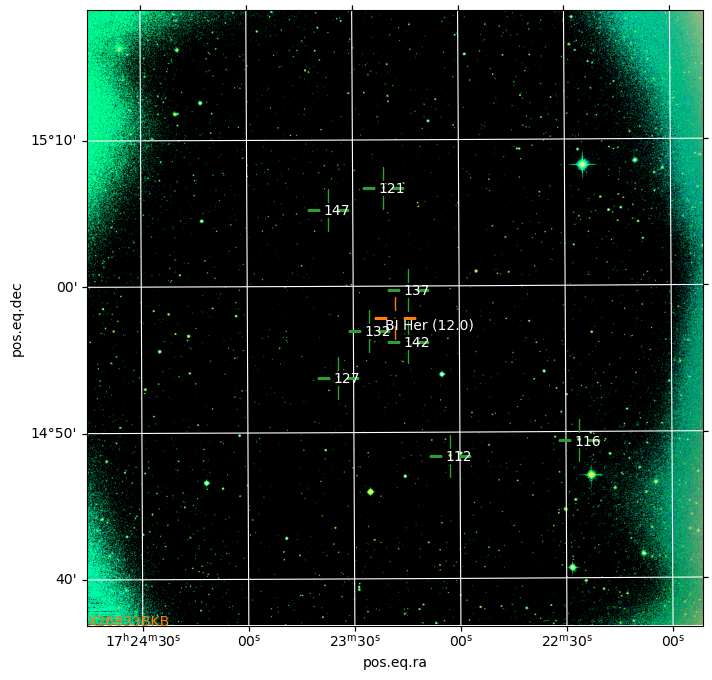

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

J353497:R682414 (BI Her) 23 April 2020 00:27:52 UTC
Filters: R V B
Getting 325700F3 from cache
BI Her seq:X26833BKB (8)


a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


jid 353497: (BI Her)
23 April 2020 00:27:52 UTC
Filters: ('R', 'V', 'B')
Getting 325700F3 from cache
 GCVS  n_GCVS   RAJ2000     DEJ2000   VarType magMax      Period      SpType Exists  VarName  Simbad
                "h:m:s"     "d:m:s"            mag          d                                       
------ ------ ----------- ----------- ------- ------ ---------------- ------ ------ --------- ------
BI Her      x 17 23 18.13 +14 57 47.9       M 12.000   210.0000000000               BI    Her Simbad
['000-BKL-281', '112', '17:23:02.85', 260.76187134, '14:48:22.9', 14.8063612, '12.782 (—)', '11.193 (—)', '1.589 (—)', '10.347 (0.029)']
['000-BKL-282', '116', '17:22:26.27', 260.60946655, '14:49:24.3', 14.82341671, '12.712 (—)', '11.554 (—)', '1.158 (—)', '11.017 (0.029)']
['000-BKL-283', '121', '17:23:21.33', 260.83886719, '15:06:43.0', 15.1119442, '13.124 (0.025)', '12.094 (0.017)', '1.030 (0.030)', '11.514 (0.025)']
['000-BKL-284', '127', '17:23:34.36', 260.89315796, '14:53:46.1', 14.89

a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


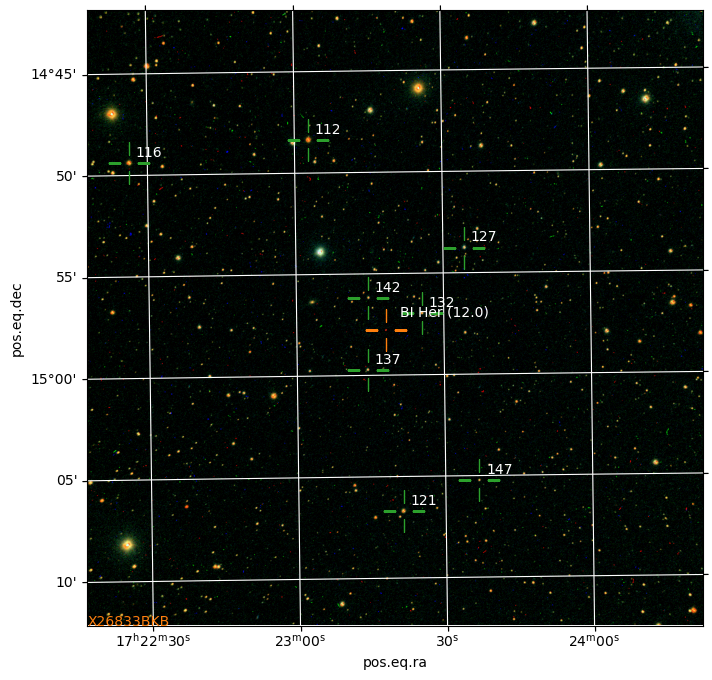

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

J338778:R666272 (BI Her) 16 August 2019 00:43:28 UTC
Filters: R V B
Getting 9E2474BE from cache
BI Her seq:X26833BKB (8)


a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


jid 338778: (BI Her)
16 August 2019 00:43:28 UTC
Filters: ('R', 'V', 'B')
Getting 9E2474BE from cache
 GCVS  n_GCVS   RAJ2000     DEJ2000   VarType magMax      Period      SpType Exists  VarName  Simbad
                "h:m:s"     "d:m:s"            mag          d                                       
------ ------ ----------- ----------- ------- ------ ---------------- ------ ------ --------- ------
BI Her      x 17 23 18.13 +14 57 47.9       M 12.000   210.0000000000               BI    Her Simbad
['000-BKL-281', '112', '17:23:02.85', 260.76187134, '14:48:22.9', 14.8063612, '12.782 (—)', '11.193 (—)', '1.589 (—)', '10.347 (0.029)']
['000-BKL-282', '116', '17:22:26.27', 260.60946655, '14:49:24.3', 14.82341671, '12.712 (—)', '11.554 (—)', '1.158 (—)', '11.017 (0.029)']
['000-BKL-283', '121', '17:23:21.33', 260.83886719, '15:06:43.0', 15.1119442, '13.124 (0.025)', '12.094 (0.017)', '1.030 (0.030)', '11.514 (0.025)']
['000-BKL-284', '127', '17:23:34.36', 260.89315796, '14:53:46.1', 14.8

a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


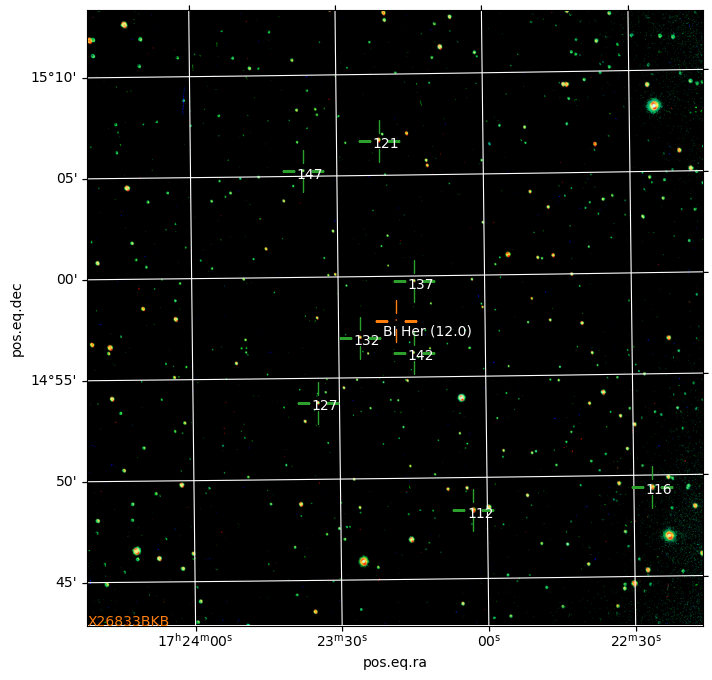

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

J350683:R679380 (BI Her) 3 March 2020 05:41:04 UTC
Filters: R V B
Getting F22F3B49 from cache
BI Her seq:X26833BKB (8)


a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


jid 350683: (BI Her)
3 March 2020 05:41:04 UTC
Filters: ('R', 'V', 'B')
Getting F22F3B49 from cache
 GCVS  n_GCVS   RAJ2000     DEJ2000   VarType magMax      Period      SpType Exists  VarName  Simbad
                "h:m:s"     "d:m:s"            mag          d                                       
------ ------ ----------- ----------- ------- ------ ---------------- ------ ------ --------- ------
BI Her      x 17 23 18.13 +14 57 47.9       M 12.000   210.0000000000               BI    Her Simbad
['000-BKL-281', '112', '17:23:02.85', 260.76187134, '14:48:22.9', 14.8063612, '12.782 (—)', '11.193 (—)', '1.589 (—)', '10.347 (0.029)']
['000-BKL-282', '116', '17:22:26.27', 260.60946655, '14:49:24.3', 14.82341671, '12.712 (—)', '11.554 (—)', '1.158 (—)', '11.017 (0.029)']
['000-BKL-283', '121', '17:23:21.33', 260.83886719, '15:06:43.0', 15.1119442, '13.124 (0.025)', '12.094 (0.017)', '1.030 (0.030)', '11.514 (0.025)']
['000-BKL-284', '127', '17:23:34.36', 260.89315796, '14:53:46.1', 14.896

a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


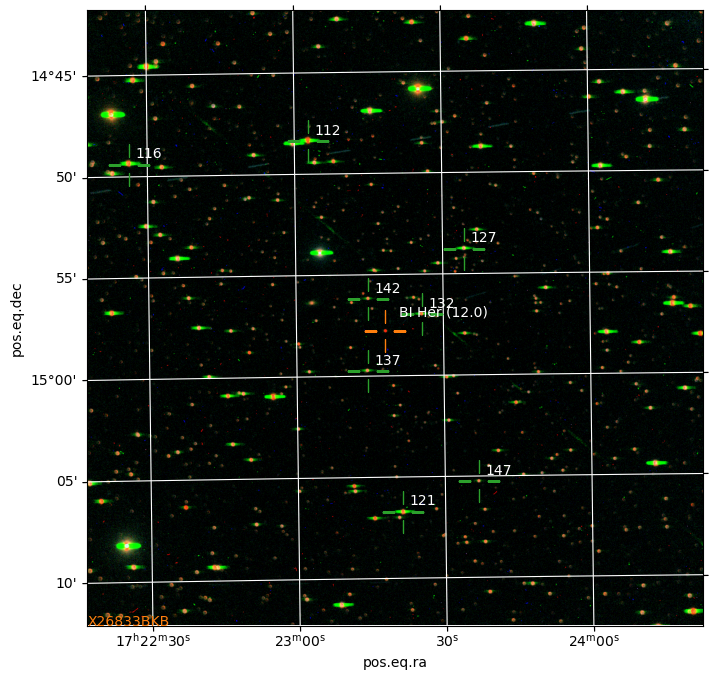

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

J337501:R664966 (BI Her) 5 July 2019 00:50:48 UTC
Filters: R V B
Getting A17DE5D7 from cache
BI Her seq:X26833BKB (8)


a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


jid 337501: (BI Her)
5 July 2019 00:50:48 UTC
Filters: ('R', 'V', 'B')
Getting A17DE5D7 from cache
 GCVS  n_GCVS   RAJ2000     DEJ2000   VarType magMax      Period      SpType Exists  VarName  Simbad
                "h:m:s"     "d:m:s"            mag          d                                       
------ ------ ----------- ----------- ------- ------ ---------------- ------ ------ --------- ------
BI Her      x 17 23 18.13 +14 57 47.9       M 12.000   210.0000000000               BI    Her Simbad
['000-BKL-281', '112', '17:23:02.85', 260.76187134, '14:48:22.9', 14.8063612, '12.782 (—)', '11.193 (—)', '1.589 (—)', '10.347 (0.029)']
['000-BKL-282', '116', '17:22:26.27', 260.60946655, '14:49:24.3', 14.82341671, '12.712 (—)', '11.554 (—)', '1.158 (—)', '11.017 (0.029)']
['000-BKL-283', '121', '17:23:21.33', 260.83886719, '15:06:43.0', 15.1119442, '13.124 (0.025)', '12.094 (0.017)', '1.030 (0.030)', '11.514 (0.025)']
['000-BKL-284', '127', '17:23:34.36', 260.89315796, '14:53:46.1', 14.8961

a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


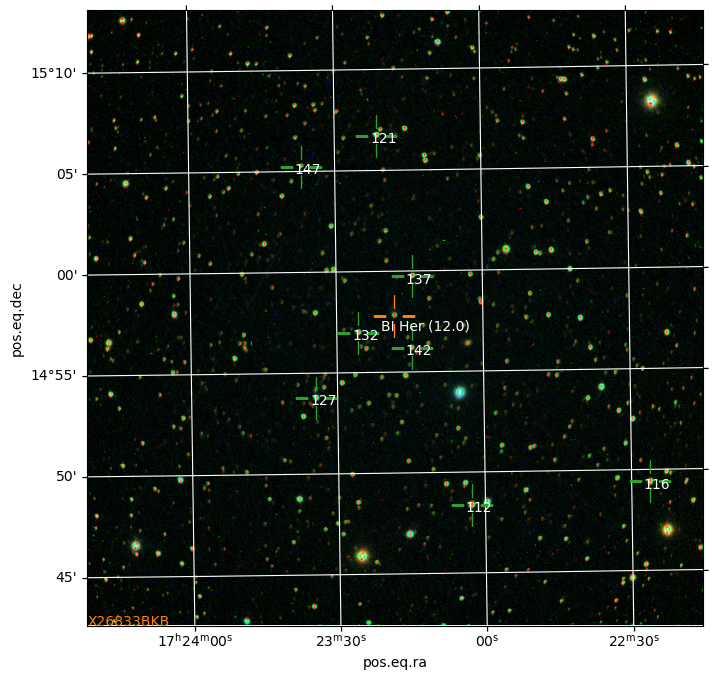

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

J349534:R678128 (BI Her) 8 February 2020 04:54:56 UTC
Filters: R V B
Getting D9EB8444 from cache
BI Her seq:X26833BKB (8)


a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


jid 349534: (BI Her)
8 February 2020 04:54:56 UTC
Filters: ('R', 'V', 'B')
Getting D9EB8444 from cache
 GCVS  n_GCVS   RAJ2000     DEJ2000   VarType magMax      Period      SpType Exists  VarName  Simbad
                "h:m:s"     "d:m:s"            mag          d                                       
------ ------ ----------- ----------- ------- ------ ---------------- ------ ------ --------- ------
BI Her      x 17 23 18.13 +14 57 47.9       M 12.000   210.0000000000               BI    Her Simbad
['000-BKL-281', '112', '17:23:02.85', 260.76187134, '14:48:22.9', 14.8063612, '12.782 (—)', '11.193 (—)', '1.589 (—)', '10.347 (0.029)']
['000-BKL-282', '116', '17:22:26.27', 260.60946655, '14:49:24.3', 14.82341671, '12.712 (—)', '11.554 (—)', '1.158 (—)', '11.017 (0.029)']
['000-BKL-283', '121', '17:23:21.33', 260.83886719, '15:06:43.0', 15.1119442, '13.124 (0.025)', '12.094 (0.017)', '1.030 (0.030)', '11.514 (0.025)']
['000-BKL-284', '127', '17:23:34.36', 260.89315796, '14:53:46.1', 14.

a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


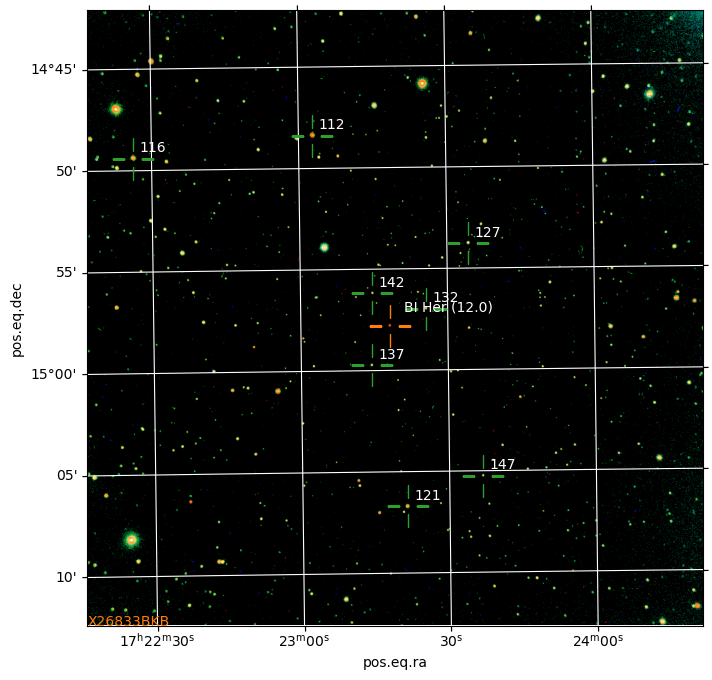

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

J398302:R743115 (BI Her) 9 August 2022 00:10:34 UTC
Filters: R V B
Solving for C4E701E4
solve-field -p -l 120 -O -L 1 -H 2 -u app -3 260.825000 -4 14.963333 -5 5 /tmp/field-solverhm6e1m1e/tmpkzfrkhi4.fits


a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


BI Her seq:X26833BKB (8)
jid 398302: (BI Her)
9 August 2022 00:10:34 UTC
Filters: ('R', 'V', 'B')
Getting C4E701E4 from cache
 GCVS  n_GCVS   RAJ2000     DEJ2000   VarType magMax      Period      SpType Exists  VarName  Simbad
                'h:m:s'     'd:m:s'            mag          d                                       
------ ------ ----------- ----------- ------- ------ ---------------- ------ ------ --------- ------
BI Her      x 17 23 18.13 +14 57 47.9       M 12.000   210.0000000000               BI    Her Simbad
['000-BKL-281', '112', '17:23:02.85', 260.76187134, '14:48:22.9', 14.8063612, '12.782 (—)', '11.193 (—)', '1.589 (—)', '10.347 (0.029)']
['000-BKL-282', '116', '17:22:26.27', 260.60946655, '14:49:24.3', 14.82341671, '12.712 (—)', '11.554 (—)', '1.158 (—)', '11.017 (0.029)']
['000-BKL-283', '121', '17:23:21.33', 260.83886719, '15:06:43.0', 15.1119442, '13.124 (0.025)', '12.094 (0.017)', '1.030 (0.030)', '11.514 (0.025)']
['000-BKL-284', '127', '17:23:34.36', 260.8931

a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


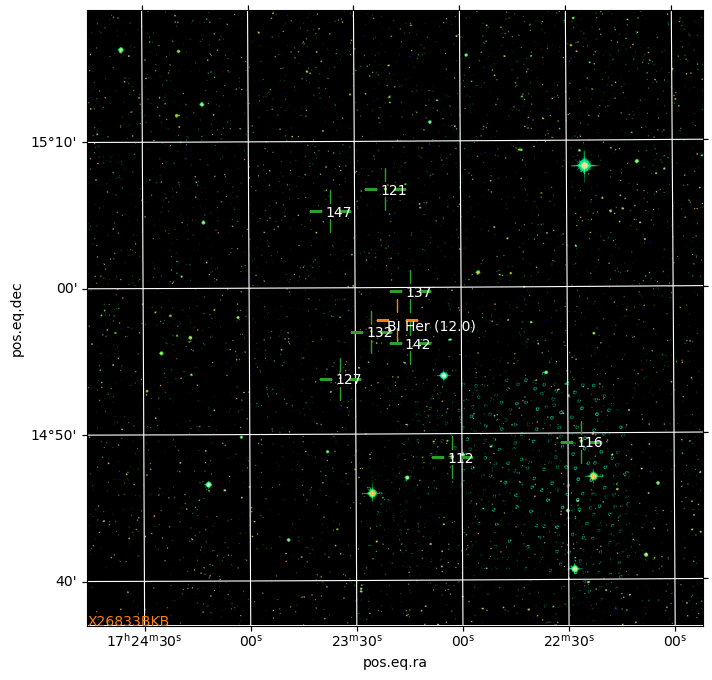

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

J348896:R677463 (BI Her) 1 February 2020 05:57:15 UTC
Filters: R V B
Getting CD4950AE from cache
BI Her seq:X26833BKB (8)


a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


jid 348896: (BI Her)
1 February 2020 05:57:15 UTC
Filters: ('R', 'V', 'B')
Getting CD4950AE from cache
 GCVS  n_GCVS   RAJ2000     DEJ2000   VarType magMax      Period      SpType Exists  VarName  Simbad
                "h:m:s"     "d:m:s"            mag          d                                       
------ ------ ----------- ----------- ------- ------ ---------------- ------ ------ --------- ------
BI Her      x 17 23 18.13 +14 57 47.9       M 12.000   210.0000000000               BI    Her Simbad
['000-BKL-281', '112', '17:23:02.85', 260.76187134, '14:48:22.9', 14.8063612, '12.782 (—)', '11.193 (—)', '1.589 (—)', '10.347 (0.029)']
['000-BKL-282', '116', '17:22:26.27', 260.60946655, '14:49:24.3', 14.82341671, '12.712 (—)', '11.554 (—)', '1.158 (—)', '11.017 (0.029)']
['000-BKL-283', '121', '17:23:21.33', 260.83886719, '15:06:43.0', 15.1119442, '13.124 (0.025)', '12.094 (0.017)', '1.030 (0.030)', '11.514 (0.025)']
['000-BKL-284', '127', '17:23:34.36', 260.89315796, '14:53:46.1', 14.

a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


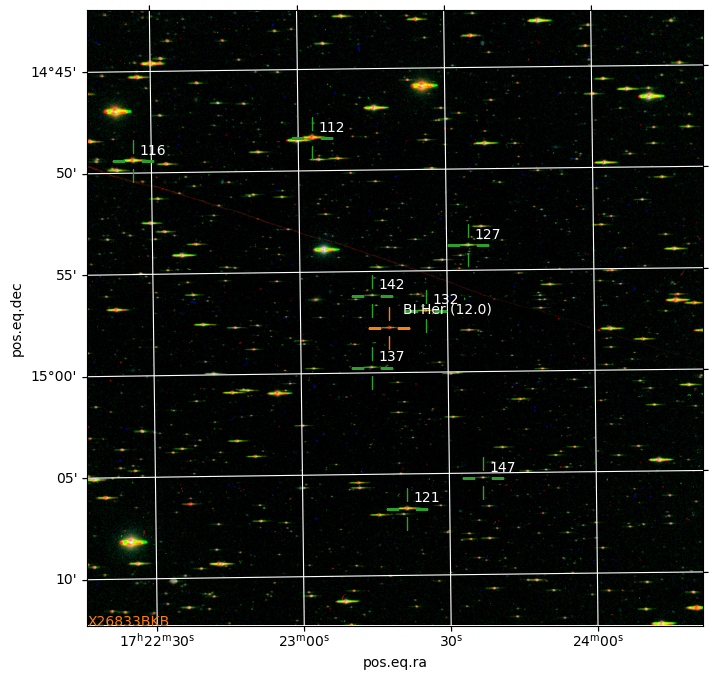

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

J339300:R666886 (BI Her) 6 September 2019 21:09:42 UTC
Filters: R V B
Getting B1B18713 from cache
BI Her seq:X26833BKB (8)


a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


jid 339300: (BI Her)
6 September 2019 21:09:42 UTC
Filters: ('R', 'V', 'B')
Getting B1B18713 from cache
 GCVS  n_GCVS   RAJ2000     DEJ2000   VarType magMax      Period      SpType Exists  VarName  Simbad
                "h:m:s"     "d:m:s"            mag          d                                       
------ ------ ----------- ----------- ------- ------ ---------------- ------ ------ --------- ------
BI Her      x 17 23 18.13 +14 57 47.9       M 12.000   210.0000000000               BI    Her Simbad
['000-BKL-281', '112', '17:23:02.85', 260.76187134, '14:48:22.9', 14.8063612, '12.782 (—)', '11.193 (—)', '1.589 (—)', '10.347 (0.029)']
['000-BKL-282', '116', '17:22:26.27', 260.60946655, '14:49:24.3', 14.82341671, '12.712 (—)', '11.554 (—)', '1.158 (—)', '11.017 (0.029)']
['000-BKL-283', '121', '17:23:21.33', 260.83886719, '15:06:43.0', 15.1119442, '13.124 (0.025)', '12.094 (0.017)', '1.030 (0.030)', '11.514 (0.025)']
['000-BKL-284', '127', '17:23:34.36', 260.89315796, '14:53:46.1', 14

a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


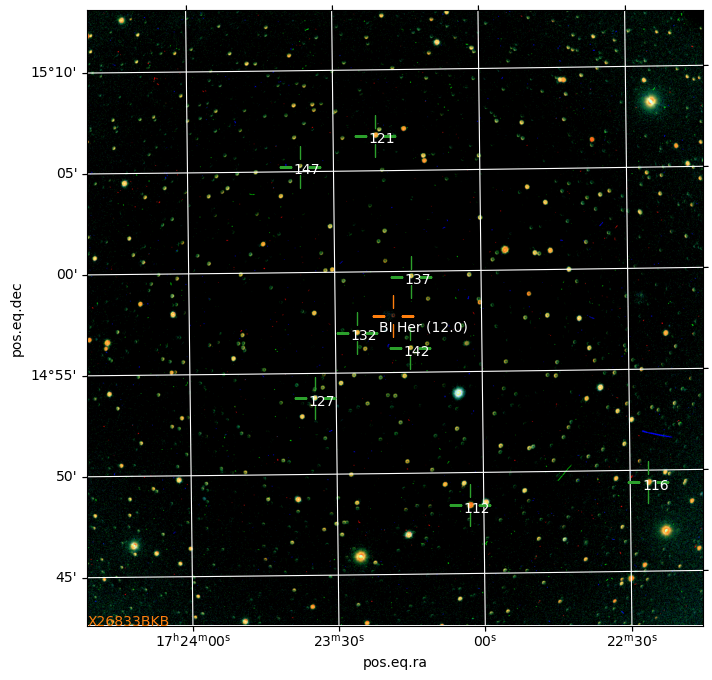

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

J352485:R681294 (BI Her) 18 March 2020 02:35:06 UTC
Filters: R V B
Getting 58587F2D from cache
BI Her seq:X26833BKB (8)


a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


jid 352485: (BI Her)
18 March 2020 02:35:06 UTC
Filters: ('R', 'V', 'B')
Getting 58587F2D from cache
 GCVS  n_GCVS   RAJ2000     DEJ2000   VarType magMax      Period      SpType Exists  VarName  Simbad
                "h:m:s"     "d:m:s"            mag          d                                       
------ ------ ----------- ----------- ------- ------ ---------------- ------ ------ --------- ------
BI Her      x 17 23 18.13 +14 57 47.9       M 12.000   210.0000000000               BI    Her Simbad
['000-BKL-281', '112', '17:23:02.85', 260.76187134, '14:48:22.9', 14.8063612, '12.782 (—)', '11.193 (—)', '1.589 (—)', '10.347 (0.029)']
['000-BKL-282', '116', '17:22:26.27', 260.60946655, '14:49:24.3', 14.82341671, '12.712 (—)', '11.554 (—)', '1.158 (—)', '11.017 (0.029)']
['000-BKL-283', '121', '17:23:21.33', 260.83886719, '15:06:43.0', 15.1119442, '13.124 (0.025)', '12.094 (0.017)', '1.030 (0.030)', '11.514 (0.025)']
['000-BKL-284', '127', '17:23:34.36', 260.89315796, '14:53:46.1', 14.89

a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


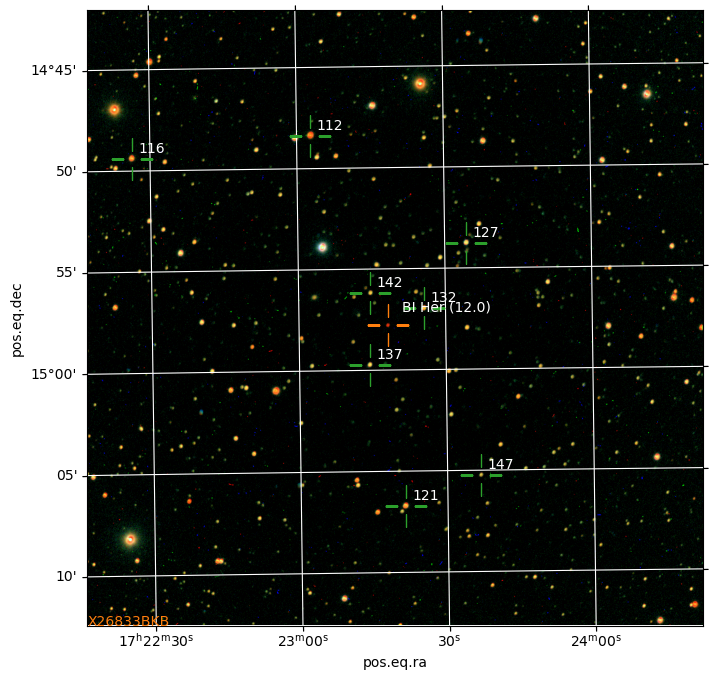

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

J347878:R676361 (BI Her) 25 January 2020 06:41:31 UTC
Filters: R V B
Getting FA7B9403 from cache
BI Her seq:X26833BKB (8)
jid 347878: (BI Her)
25 January 2020 06:41:31 UTC
Filters: ('R', 'V', 'B')
Getting FA7B9403 from cache
 GCVS  n_GCVS   RAJ2000     DEJ2000   VarType magMax      Period      SpType Exists  VarName  Simbad
                "h:m:s"     "d:m:s"            mag          d                                       
------ ------ ----------- ----------- ------- ------ ---------------- ------ ------ --------- ------
BI Her      x 17 23 18.13 +14 57 47.9       M 12.000   210.0000000000               BI    Her Simbad
['000-BKL-281', '112', '17:23:02.85', 260.76187134, '14:48:22.9', 14.8063612, '12.782 (—)', '11.193 (—)', '1.589 (—)', '10.347 (0.029)']
['000-BKL-282', '116', '17:22:26.27', 260.60946655, '14:49:24.3', 14.82341671, '12.712 (—)', '11.554 (—)', '1.158 (—)', '11.017 (0.029)']
['000-BKL-283', '121', '17:23:21.33', 260.83886719, '15:06:43.0', 15.1119442, '13.124 (0.025)', 

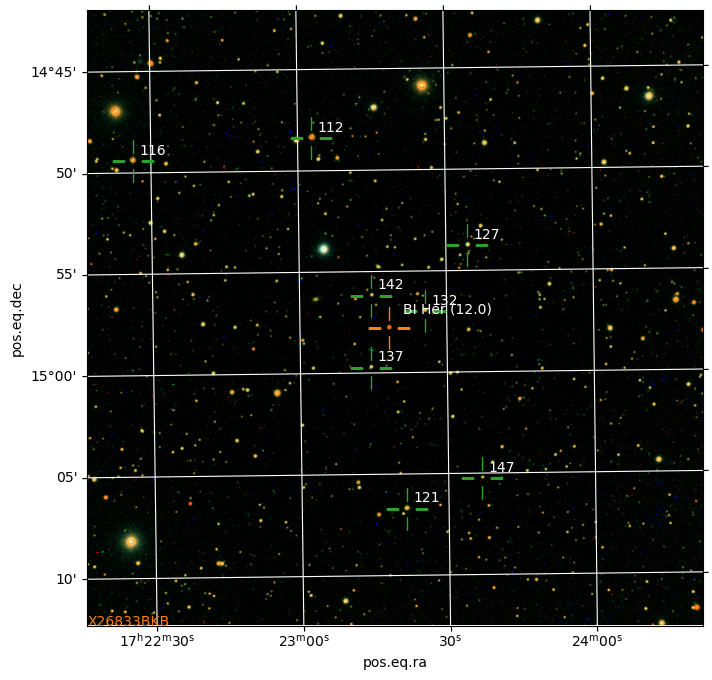

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

J388453:R731110 (BI Her) 13 November 2021 19:26:51 UTC
Filters: R V B
Solving for C48798D6
solve-field -p -l 120 -O -L 1 -H 2 -u app -3 260.825000 -4 14.963333 -5 5 /tmp/field-solvercdq9c1ey/tmpfps6zpm0.fits


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]


BI Her seq:X26833BKB (8)
jid 388453: (BI Her)
13 November 2021 19:26:51 UTC
Filters: ('R', 'V', 'B')
Getting C48798D6 from cache
 GCVS  n_GCVS   RAJ2000     DEJ2000   VarType magMax      Period      SpType Exists  VarName  Simbad
                'h:m:s'     'd:m:s'            mag          d                                       
------ ------ ----------- ----------- ------- ------ ---------------- ------ ------ --------- ------
BI Her      x 17 23 18.13 +14 57 47.9       M 12.000   210.0000000000               BI    Her Simbad
['000-BKL-281', '112', '17:23:02.85', 260.76187134, '14:48:22.9', 14.8063612, '12.782 (—)', '11.193 (—)', '1.589 (—)', '10.347 (0.029)']
['000-BKL-282', '116', '17:22:26.27', 260.60946655, '14:49:24.3', 14.82341671, '12.712 (—)', '11.554 (—)', '1.158 (—)', '11.017 (0.029)']
['000-BKL-283', '121', '17:23:21.33', 260.83886719, '15:06:43.0', 15.1119442, '13.124 (0.025)', '12.094 (0.017)', '1.030 (0.030)', '11.514 (0.025)']
['000-BKL-284', '127', '17:23:34.36', 260.8

the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]


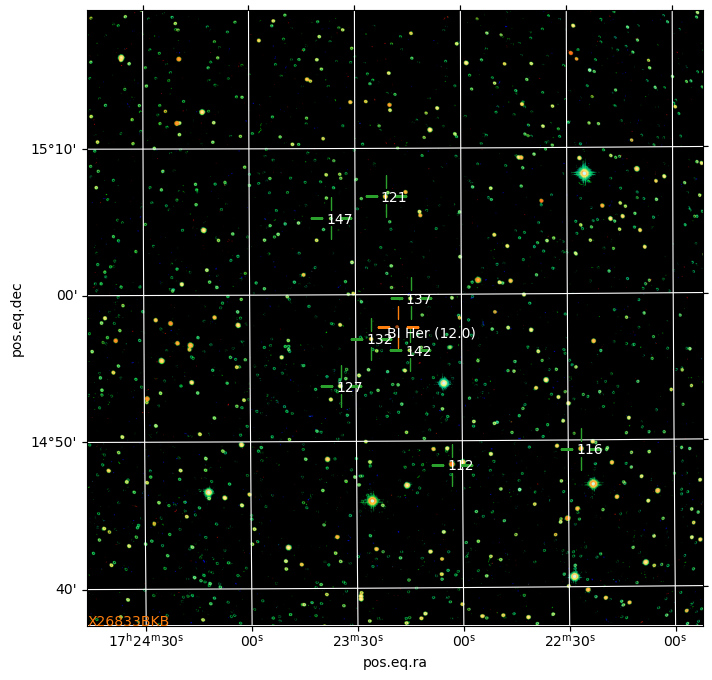

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

J347625:R676102 (BI Her) 20 January 2020 06:14:22 UTC
Filters: R V B
Getting 48803BA6 from cache
BI Her seq:X26833BKB (8)


a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


jid 347625: (BI Her)
20 January 2020 06:14:22 UTC
Filters: ('R', 'V', 'B')
Getting 48803BA6 from cache
 GCVS  n_GCVS   RAJ2000     DEJ2000   VarType magMax      Period      SpType Exists  VarName  Simbad
                "h:m:s"     "d:m:s"            mag          d                                       
------ ------ ----------- ----------- ------- ------ ---------------- ------ ------ --------- ------
BI Her      x 17 23 18.13 +14 57 47.9       M 12.000   210.0000000000               BI    Her Simbad
['000-BKL-281', '112', '17:23:02.85', 260.76187134, '14:48:22.9', 14.8063612, '12.782 (—)', '11.193 (—)', '1.589 (—)', '10.347 (0.029)']
['000-BKL-282', '116', '17:22:26.27', 260.60946655, '14:49:24.3', 14.82341671, '12.712 (—)', '11.554 (—)', '1.158 (—)', '11.017 (0.029)']
['000-BKL-283', '121', '17:23:21.33', 260.83886719, '15:06:43.0', 15.1119442, '13.124 (0.025)', '12.094 (0.017)', '1.030 (0.030)', '11.514 (0.025)']
['000-BKL-284', '127', '17:23:34.36', 260.89315796, '14:53:46.1', 14.

a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


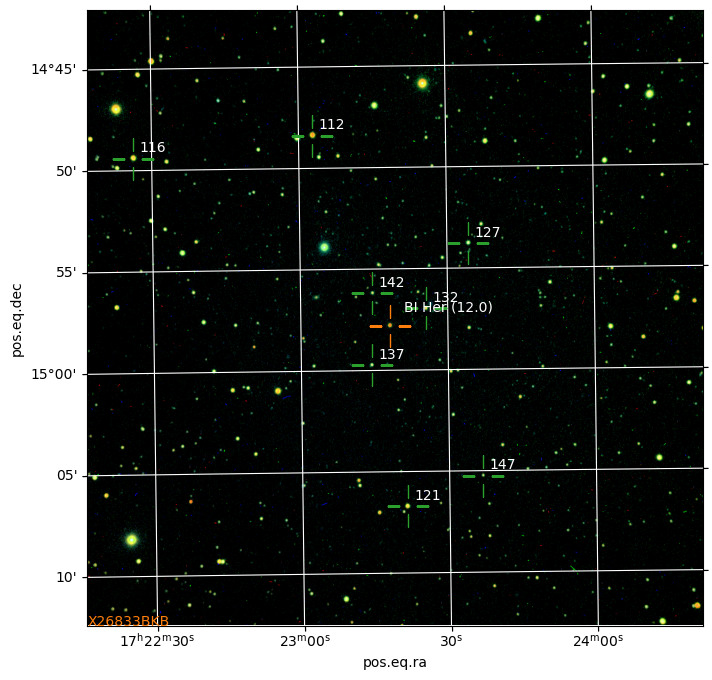

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

J394347:R738303 (BI Her) 8 April 2022 01:54:00 UTC
Filters: R V B
Solving for CE7ADB81
solve-field -p -l 120 -O -L 1 -H 2 -u app -3 260.825000 -4 14.963333 -5 5 /tmp/field-solverhnfygen1/tmpp0tfxuxi.fits


a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


BI Her seq:X26833BKB (8)
jid 394347: (BI Her)
8 April 2022 01:54:00 UTC
Filters: ('R', 'V', 'B')
Getting CE7ADB81 from cache
 GCVS  n_GCVS   RAJ2000     DEJ2000   VarType magMax      Period      SpType Exists  VarName  Simbad
                'h:m:s'     'd:m:s'            mag          d                                       
------ ------ ----------- ----------- ------- ------ ---------------- ------ ------ --------- ------
BI Her      x 17 23 18.13 +14 57 47.9       M 12.000   210.0000000000               BI    Her Simbad
['000-BKL-281', '112', '17:23:02.85', 260.76187134, '14:48:22.9', 14.8063612, '12.782 (—)', '11.193 (—)', '1.589 (—)', '10.347 (0.029)']
['000-BKL-282', '116', '17:22:26.27', 260.60946655, '14:49:24.3', 14.82341671, '12.712 (—)', '11.554 (—)', '1.158 (—)', '11.017 (0.029)']
['000-BKL-283', '121', '17:23:21.33', 260.83886719, '15:06:43.0', 15.1119442, '13.124 (0.025)', '12.094 (0.017)', '1.030 (0.030)', '11.514 (0.025)']
['000-BKL-284', '127', '17:23:34.36', 260.89315

a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


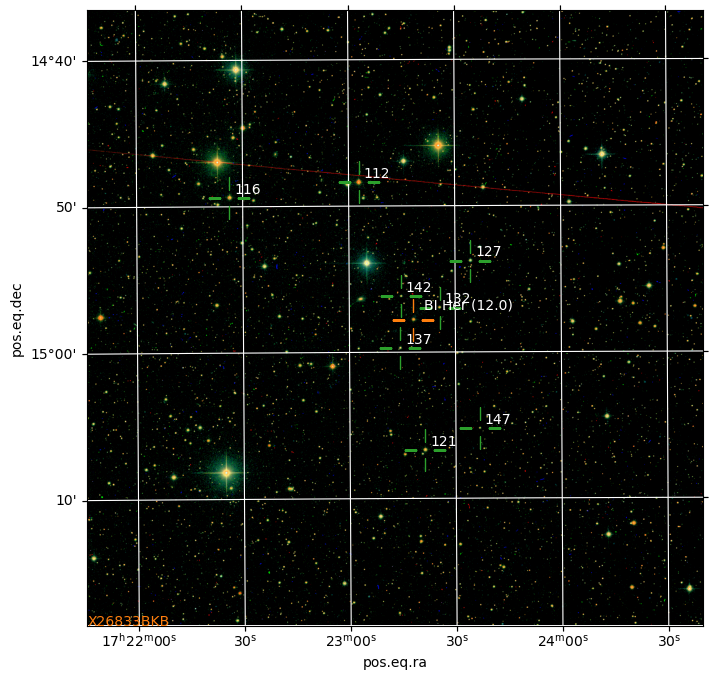

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

J346478:R674906 (BI Her) 12 January 2020 06:38:52 UTC
Filters: R V B
Getting E171B80C from cache
BI Her seq:X26833BKB (8)


a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


jid 346478: (BI Her)
12 January 2020 06:38:52 UTC
Filters: ('R', 'V', 'B')
Getting E171B80C from cache
 GCVS  n_GCVS   RAJ2000     DEJ2000   VarType magMax      Period      SpType Exists  VarName  Simbad
                "h:m:s"     "d:m:s"            mag          d                                       
------ ------ ----------- ----------- ------- ------ ---------------- ------ ------ --------- ------
BI Her      x 17 23 18.13 +14 57 47.9       M 12.000   210.0000000000               BI    Her Simbad
['000-BKL-281', '112', '17:23:02.85', 260.76187134, '14:48:22.9', 14.8063612, '12.782 (—)', '11.193 (—)', '1.589 (—)', '10.347 (0.029)']
['000-BKL-282', '116', '17:22:26.27', 260.60946655, '14:49:24.3', 14.82341671, '12.712 (—)', '11.554 (—)', '1.158 (—)', '11.017 (0.029)']
['000-BKL-283', '121', '17:23:21.33', 260.83886719, '15:06:43.0', 15.1119442, '13.124 (0.025)', '12.094 (0.017)', '1.030 (0.030)', '11.514 (0.025)']
['000-BKL-284', '127', '17:23:34.36', 260.89315796, '14:53:46.1', 14.

a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


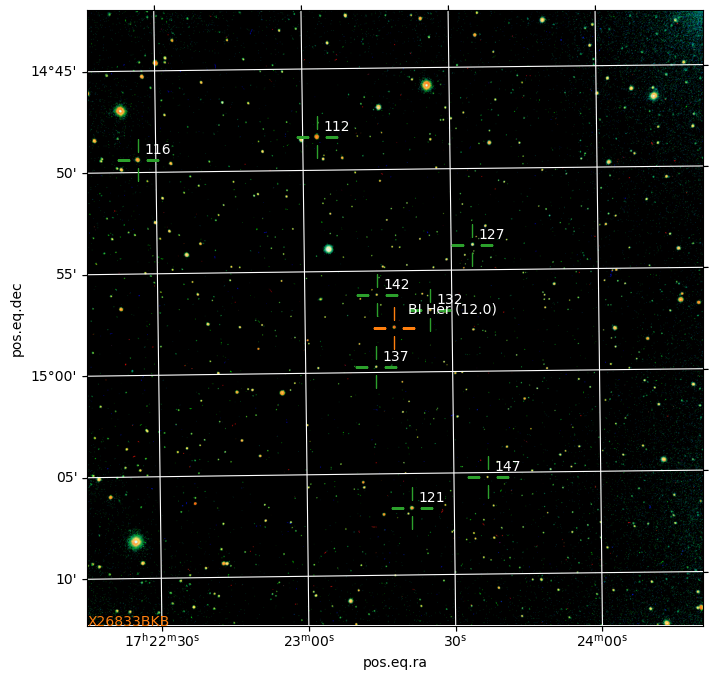

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

J351472:R680235 (BI Her) 10 March 2020 02:57:48 UTC
Filters: R V B
Getting EBCC92E8 from cache
BI Her seq:X26833BKB (8)


a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


jid 351472: (BI Her)
10 March 2020 02:57:48 UTC
Filters: ('R', 'V', 'B')
Getting EBCC92E8 from cache
 GCVS  n_GCVS   RAJ2000     DEJ2000   VarType magMax      Period      SpType Exists  VarName  Simbad
                "h:m:s"     "d:m:s"            mag          d                                       
------ ------ ----------- ----------- ------- ------ ---------------- ------ ------ --------- ------
BI Her      x 17 23 18.13 +14 57 47.9       M 12.000   210.0000000000               BI    Her Simbad
['000-BKL-281', '112', '17:23:02.85', 260.76187134, '14:48:22.9', 14.8063612, '12.782 (—)', '11.193 (—)', '1.589 (—)', '10.347 (0.029)']
['000-BKL-282', '116', '17:22:26.27', 260.60946655, '14:49:24.3', 14.82341671, '12.712 (—)', '11.554 (—)', '1.158 (—)', '11.017 (0.029)']
['000-BKL-283', '121', '17:23:21.33', 260.83886719, '15:06:43.0', 15.1119442, '13.124 (0.025)', '12.094 (0.017)', '1.030 (0.030)', '11.514 (0.025)']
['000-BKL-284', '127', '17:23:34.36', 260.89315796, '14:53:46.1', 14.89

a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


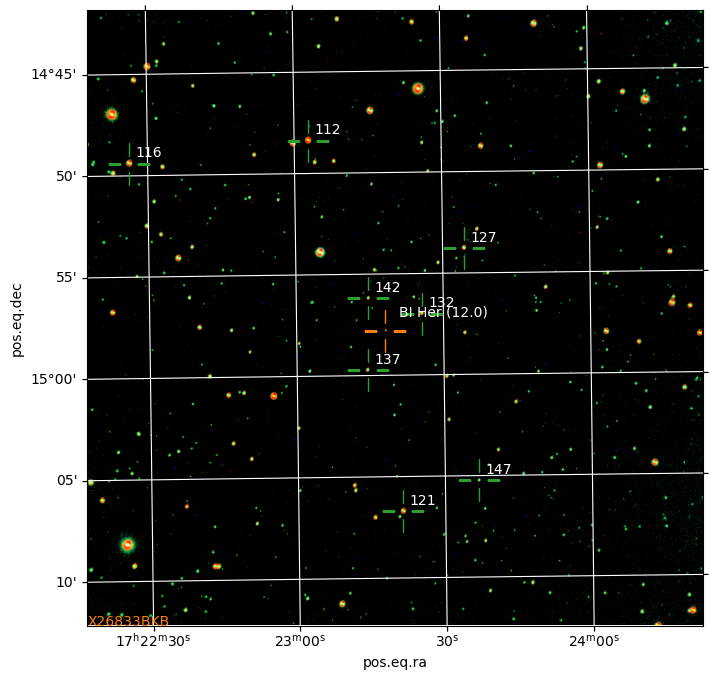

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

J350066:R678711 (BI Her) 17 February 2020 04:35:02 UTC
Filters: R V B
Getting 44D8239F from cache
BI Her seq:X26833BKB (8)


a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


jid 350066: (BI Her)
17 February 2020 04:35:02 UTC
Filters: ('R', 'V', 'B')
Getting 44D8239F from cache
 GCVS  n_GCVS   RAJ2000     DEJ2000   VarType magMax      Period      SpType Exists  VarName  Simbad
                "h:m:s"     "d:m:s"            mag          d                                       
------ ------ ----------- ----------- ------- ------ ---------------- ------ ------ --------- ------
BI Her      x 17 23 18.13 +14 57 47.9       M 12.000   210.0000000000               BI    Her Simbad
['000-BKL-281', '112', '17:23:02.85', 260.76187134, '14:48:22.9', 14.8063612, '12.782 (—)', '11.193 (—)', '1.589 (—)', '10.347 (0.029)']
['000-BKL-282', '116', '17:22:26.27', 260.60946655, '14:49:24.3', 14.82341671, '12.712 (—)', '11.554 (—)', '1.158 (—)', '11.017 (0.029)']
['000-BKL-283', '121', '17:23:21.33', 260.83886719, '15:06:43.0', 15.1119442, '13.124 (0.025)', '12.094 (0.017)', '1.030 (0.030)', '11.514 (0.025)']
['000-BKL-284', '127', '17:23:34.36', 260.89315796, '14:53:46.1', 14

a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


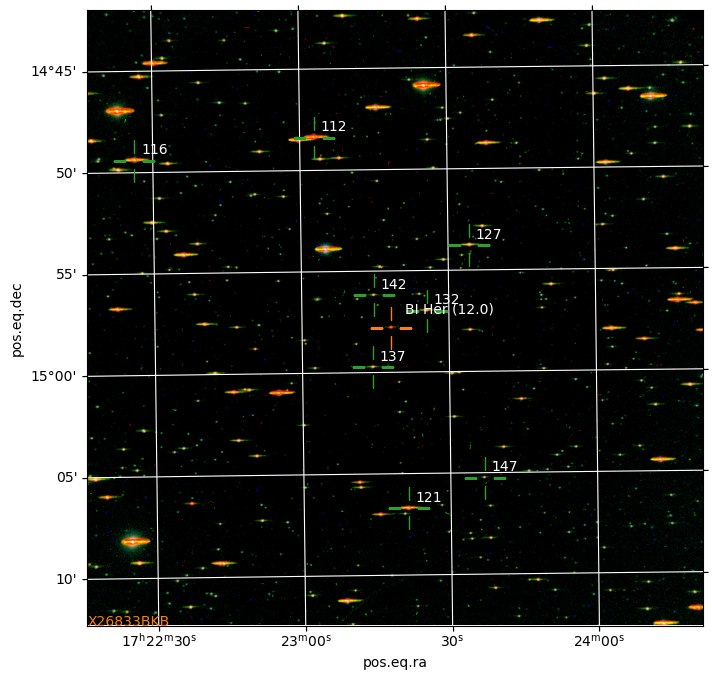

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

J346994:R675443 (BI Her) 16 January 2020 06:25:45 UTC
Filters: R V B
Getting 9ACEC401 from cache
BI Her seq:X26833BKB (8)


a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


jid 346994: (BI Her)
16 January 2020 06:25:45 UTC
Filters: ('R', 'V', 'B')
Getting 9ACEC401 from cache
 GCVS  n_GCVS   RAJ2000     DEJ2000   VarType magMax      Period      SpType Exists  VarName  Simbad
                "h:m:s"     "d:m:s"            mag          d                                       
------ ------ ----------- ----------- ------- ------ ---------------- ------ ------ --------- ------
BI Her      x 17 23 18.13 +14 57 47.9       M 12.000   210.0000000000               BI    Her Simbad
['000-BKL-281', '112', '17:23:02.85', 260.76187134, '14:48:22.9', 14.8063612, '12.782 (—)', '11.193 (—)', '1.589 (—)', '10.347 (0.029)']
['000-BKL-282', '116', '17:22:26.27', 260.60946655, '14:49:24.3', 14.82341671, '12.712 (—)', '11.554 (—)', '1.158 (—)', '11.017 (0.029)']
['000-BKL-283', '121', '17:23:21.33', 260.83886719, '15:06:43.0', 15.1119442, '13.124 (0.025)', '12.094 (0.017)', '1.030 (0.030)', '11.514 (0.025)']
['000-BKL-284', '127', '17:23:34.36', 260.89315796, '14:53:46.1', 14.

a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


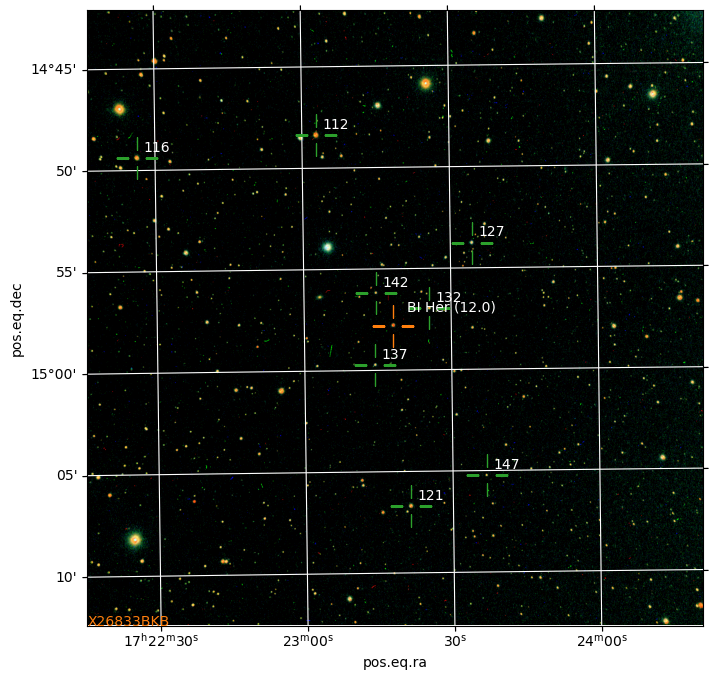

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

J348664:R677223 (BI Her) 31 January 2020 05:25:00 UTC
Filters: R V B
Getting E889A7DD from cache
BI Her seq:X26833BKB (8)


a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


jid 348664: (BI Her)
31 January 2020 05:25:00 UTC
Filters: ('R', 'V', 'B')
Getting E889A7DD from cache
 GCVS  n_GCVS   RAJ2000     DEJ2000   VarType magMax      Period      SpType Exists  VarName  Simbad
                "h:m:s"     "d:m:s"            mag          d                                       
------ ------ ----------- ----------- ------- ------ ---------------- ------ ------ --------- ------
BI Her      x 17 23 18.13 +14 57 47.9       M 12.000   210.0000000000               BI    Her Simbad
['000-BKL-281', '112', '17:23:02.85', 260.76187134, '14:48:22.9', 14.8063612, '12.782 (—)', '11.193 (—)', '1.589 (—)', '10.347 (0.029)']
['000-BKL-282', '116', '17:22:26.27', 260.60946655, '14:49:24.3', 14.82341671, '12.712 (—)', '11.554 (—)', '1.158 (—)', '11.017 (0.029)']
['000-BKL-283', '121', '17:23:21.33', 260.83886719, '15:06:43.0', 15.1119442, '13.124 (0.025)', '12.094 (0.017)', '1.030 (0.030)', '11.514 (0.025)']
['000-BKL-284', '127', '17:23:34.36', 260.89315796, '14:53:46.1', 14.

a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


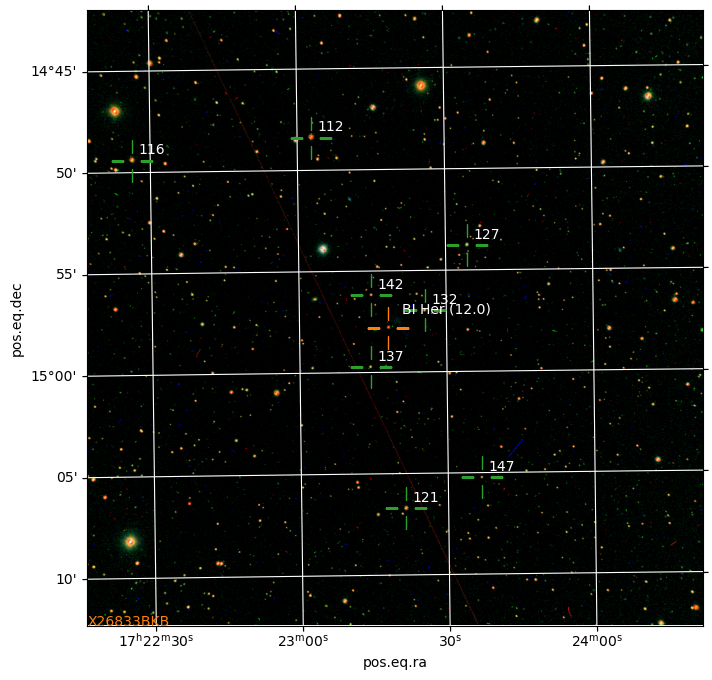

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

J336893:R664339 (BI Her) 19 June 2019 01:15:54 UTC
Filters: R V B
Getting A2DB6EE5 from cache
BI Her seq:X26833BKB (8)


a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


jid 336893: (BI Her)
19 June 2019 01:15:54 UTC
Filters: ('R', 'V', 'B')
Getting A2DB6EE5 from cache
 GCVS  n_GCVS   RAJ2000     DEJ2000   VarType magMax      Period      SpType Exists  VarName  Simbad
                "h:m:s"     "d:m:s"            mag          d                                       
------ ------ ----------- ----------- ------- ------ ---------------- ------ ------ --------- ------
BI Her      x 17 23 18.13 +14 57 47.9       M 12.000   210.0000000000               BI    Her Simbad
['000-BKL-281', '112', '17:23:02.85', 260.76187134, '14:48:22.9', 14.8063612, '12.782 (—)', '11.193 (—)', '1.589 (—)', '10.347 (0.029)']
['000-BKL-282', '116', '17:22:26.27', 260.60946655, '14:49:24.3', 14.82341671, '12.712 (—)', '11.554 (—)', '1.158 (—)', '11.017 (0.029)']
['000-BKL-283', '121', '17:23:21.33', 260.83886719, '15:06:43.0', 15.1119442, '13.124 (0.025)', '12.094 (0.017)', '1.030 (0.030)', '11.514 (0.025)']
['000-BKL-284', '127', '17:23:34.36', 260.89315796, '14:53:46.1', 14.896

a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


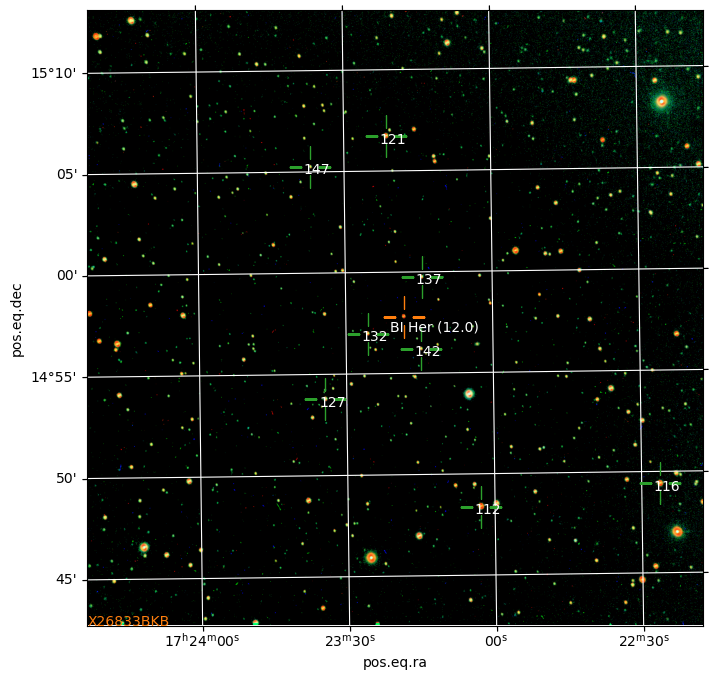

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

J346239:R674661 (BI Her) 10 January 2020 06:48:57 UTC
Filters: R V B
Getting 79A3EDD0 from cache
BI Her seq:X26833BKB (8)


a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


jid 346239: (BI Her)
10 January 2020 06:48:57 UTC
Filters: ('R', 'V', 'B')
Getting 79A3EDD0 from cache
 GCVS  n_GCVS   RAJ2000     DEJ2000   VarType magMax      Period      SpType Exists  VarName  Simbad
                "h:m:s"     "d:m:s"            mag          d                                       
------ ------ ----------- ----------- ------- ------ ---------------- ------ ------ --------- ------
BI Her      x 17 23 18.13 +14 57 47.9       M 12.000   210.0000000000               BI    Her Simbad
['000-BKL-281', '112', '17:23:02.85', 260.76187134, '14:48:22.9', 14.8063612, '12.782 (—)', '11.193 (—)', '1.589 (—)', '10.347 (0.029)']
['000-BKL-282', '116', '17:22:26.27', 260.60946655, '14:49:24.3', 14.82341671, '12.712 (—)', '11.554 (—)', '1.158 (—)', '11.017 (0.029)']
['000-BKL-283', '121', '17:23:21.33', 260.83886719, '15:06:43.0', 15.1119442, '13.124 (0.025)', '12.094 (0.017)', '1.030 (0.030)', '11.514 (0.025)']
['000-BKL-284', '127', '17:23:34.36', 260.89315796, '14:53:46.1', 14.

a floating-point value was expected. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


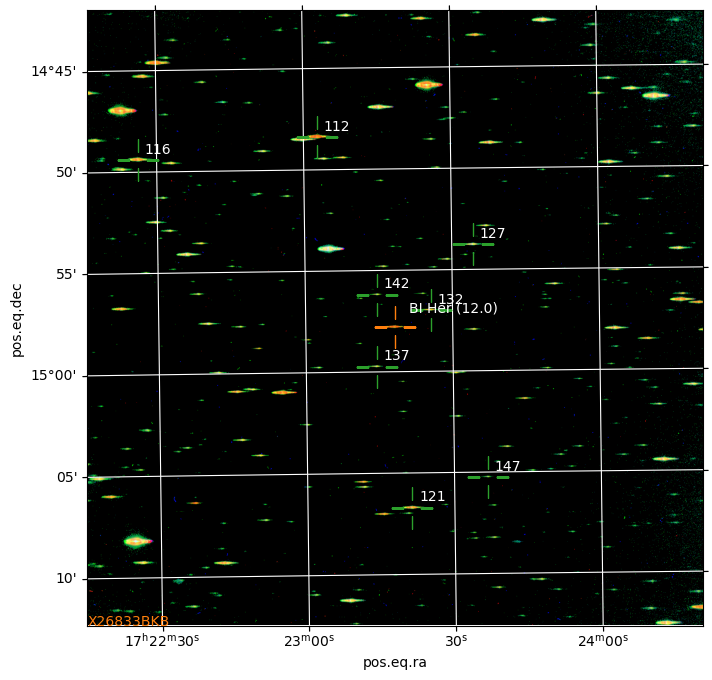

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

In [ ]:
for jid in VSdb['BI Her']['jobs']:
    if jid in problematic:
        print(f'{jid} problematic')
        continue
    analyse_job(jid, reprocess=True)
    plt.figure(figsize=(8,8))
    process_job(jid, reprocess=True, cls=False)
    plt.show()

jid 382519: (BE Vul)
17 August 2021 22:24:30 UTC
Filters: ('R', 'V', 'B')
Getting E0658253 from cache
 GCVS  n_GCVS   RAJ2000     DEJ2000   VarType magMax      Period       SpType Exists  VarName  Simbad
                "h:m:s"     "d:m:s"            mag          d                                        
------ ------ ----------- ----------- ------- ------ ---------------- ------- ------ --------- ------
BE Vul      * 20 25 33.64 +27 22 09.1   EA/SD  9.780     1.5520440000 A3V-A5V        BE    Vul Simbad
f_NSV  NSV  u_NSV n_NSV  RAJ2000    DEJ2000  VarType magMax SpType VarName
                         "h:m:s"    "d:m:s"           mag                 
----- ----- ----- ----- ---------- --------- ------- ------ ------ -------
      13087           * 20 26 23.7 +27 29 09          10.30     A1        


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
a floating-point value was expected. [astropy.wcs.wcs]


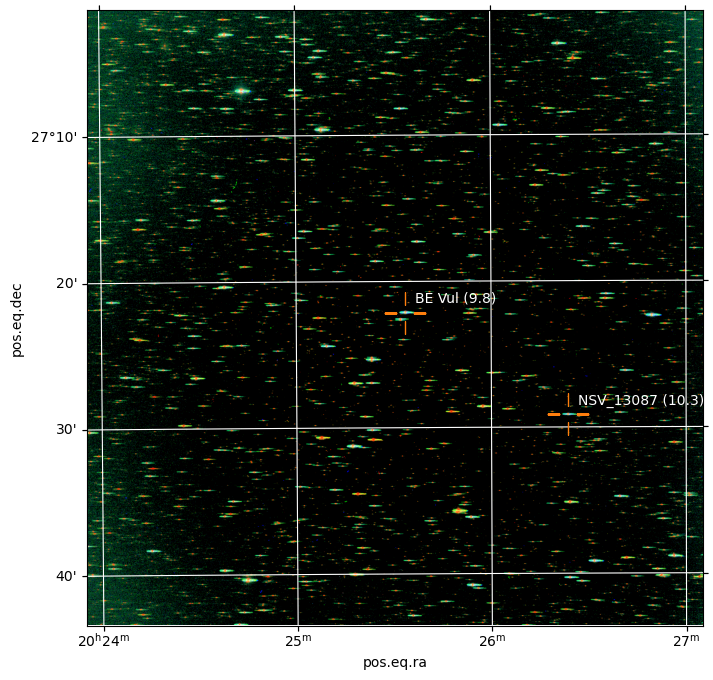

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

In [ ]:
plt.figure(figsize=(8,8))
process_job(382519, reprocess=True, cls=False)

In [ ]:
for name, rec in VSdb.items():
    if 'seq' in rec:
        if rec['seq']:
            continue
        else:
            pass
            print('del')
            del rec['seq']
            VSdb['name']=rec
            # continue
    print(name, VSdb['name'])

del
NSV_02013 {'jobs': {350977, 351236, 369800, 345997, 341902, 341777, 344468, 346658, 344739, 345765, 348458, 343595, 351664, 348210, 347316, 350518, 343995, 345284, 352200, 344268, 345041, 353493, 348894, 352484, 347623, 349800, 343016, 346993, 343159, 349183}}
del
NSV_02014 {'jobs': {350977, 351236, 369800, 345997, 341902, 341777, 344468, 346658, 344739, 345765, 348458, 343595, 351664, 348210, 347316, 350518, 343995, 345284, 352200, 344268, 345041, 353493, 348894, 352484, 347623, 349800, 343016, 346993, 343159, 349183}}
del
NSV_02017 {'jobs': {350977, 351236, 369800, 345997, 341902, 341777, 344468, 346658, 344739, 345765, 348458, 343595, 351664, 348210, 347316, 350518, 343995, 345284, 352200, 344268, 345041, 353493, 348894, 352484, 347623, 349800, 343016, 346993, 343159, 349183}}
del
NSV_02035 {'jobs': {350977, 351236, 369800, 345997, 341902, 341777, 344468, 346658, 344739, 345765, 348458, 343595, 351664, 348210, 347316, 350518, 343995, 345284, 352200, 344268, 345041, 353493, 34889

In [ ]:
DB['problematic'] = problematic
DB['problematic']

{382519, 649135, 649138}

In [ ]:
rec = VSdb['BE Vul']
rec['seq'] = get_VS_sequence('BE Vul', 30, 14)
VSdb['BE Vul'] = rec

In [ ]:
VSdb['BE Vul'] 

{'jobs': {382519, 383109},
 'seq': ('X28196CHE',
  [['000-BMN-703',
    '95',
    '20:25:17.24',
    306.32183838,
    '27:31:17.5',
    27.52152824,
    '9.908 (0.052)',
    '9.504 (0.034)',
    '0.404 (0.062)',
    '—'],
   ['000-BMN-701',
    '99',
    '20:25:23.17',
    306.3465271,
    '27:25:21.7',
    27.42269516,
    '10.488 (0.062)',
    '9.940 (0.038)',
    '0.548 (0.073)',
    '—'],
   ['000-BMN-702',
    '102',
    '20:24:37.87',
    306.1578064,
    '27:20:21.9',
    27.3394165,
    '10.966 (0.162)',
    '10.243 (0.047)',
    '0.723 (0.169)',
    '—'],
   ['000-BMN-704',
    '107',
    '20:26:24.11',
    306.60046387,
    '27:35:09.4',
    27.58594513,
    '11.612 (0.209)',
    '10.714 (0.030)',
    '0.898 (0.211)',
    '10.183 (0.067)']])}

In [ ]:
#| local

userjobs = ((int(OSO.get_request(int(j['id']))['jid'][1:]), int(j['id'])) for j in complete[:3])
for n, (jid, rid) in enumerate(userjobs):
    if jid in (problematic | done):
        continue
    print(f"{n}:R{rid}:J{jid}")
    try :
        if analyse_job(jid, rid, True):
            done |= {jid}
    except ConnectionError:
        print('Unable to finish')

In [ ]:
#| local
DB['done'] = done

In [ ]:
#| local
sdb = DB['sequences']

In [ ]:
#| local
sdb.keys()

dict_keys(['SS Cyg', 'AG Dra', 'EQ Lyr', 'DQ Vul', 'DX Vul', 'BI Her', 'AS Lac', 'EU Cyg', 'V686 Cyg', 'V723 Cas', 'V515 And', 'AZ Cas', 'PQ And', 'DT Ori', 'V2330 Cyg', 'V698 Cyg', 'WX Del', 'V742 Lyr', 'dv dra', 'v725 aql', 'hr lyr', 'KX Aql', 'CZ Her', 'GP Her', 'V393 Her', 'FY Cam', 'll and', 'GM Cam', 'RX Cas', 'OW Gem', 'TU Lyn', 'HX Aur', 'HQ Aur', 'DU Aur', 'BP Tau', 'YY Aur', 'R Sge', 'SY And', 'HO Cam', 'LX Cyg', 'V1223 Sgr', 'CH Cyg', 'TW Cnc', 'V493 Gem', 'v1251 cyg', 'v402 and', 'V1907 Cyg', 'V1904 Cyg', 'V482 CYG', 'V1112 Per', 'TW Vul', 'V718 Per', 'CD And', 'V1177 Cas', 'V1674 Her', 'v1413 aql', 'Z Per', 'UU Aql', 'V884 Her', 'v884 her'])

In [ ]:
#| local
plt.figure(figsize=(10,10))
for n, j in enumerate(complete[:3]):
    if int(j['id']) in (problematic | done):
        continue
    jid = int(OSO.get_request(int(j['id']))['jid'][1:])
    print(f"{n}:R{j['id']}:J{jid}", end='\r')
    if jid not in DB:
        print(f"{n}:R{j['id']}:J{jid}")
        try :
            process_job(jid)
        except TimeoutError:
            problematic |= {int(j['id'])}
            continue
    done |= {int(j['id'])}   

<Figure size 1000x1000 with 0 Axes>

In [ ]:
#| local 
now = datetime.fromtimestamp(time.time())
olst = OSO.get_obs_list(t=datetime(now.year, 
                                   now.month, 
                                   now.day-5, 
                                   16, 0).timestamp())
print(f'Observations: {len(olst)}')

Observations: 113


jid 399041: (V6594 Sgr_dither)
7 September 2022 21:14:21 UTC
Filters: ('R', 'V', 'B')


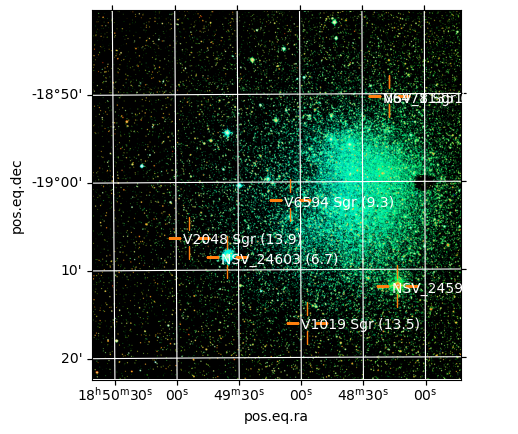

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

In [ ]:
#| local 
plt.figure(figsize=(10,10))
for n, jid in enumerate(olst):
    if jid in (problematic | done):
        continue
    rid=0
    print(f"{n}:R{rid}:J{jid}", end='\r')
    if jid not in DB:
        print(f"{n}:R{rid}:J{jid}")
        try :
            process_job(jid)
        except TimeoutError:
            problematic |= {jid}
            continue
    done |= {jid}   

In [ ]:
#| local 
DB['problematic']=problematic
DB['done']=done
len(done), len(problematic)

In [ ]:
#| local 
jid = 333721
jid = 338617
jid = 327069
jid = 321992
jid = 300678
hdu = fits.open(OSO.get_obs(OSO.get_job(jid), cube=True, verbose=False))[0]
z = OSO.get_obs(OSO.get_job(jid), cube=False, verbose=False)
hdul=[fits.open(BytesIO(z.read(name)))[0] for name in z.namelist()]

In [ ]:
#| local 
DB['sequences']={}

In [ ]:
#| local 
hdu = hdul[0]
data = hdu.data
w = WCS(solver.solve(hdu))
ax = subplot(projection=w)
p = SkyCoord('21:42:42.79 +43:35:09.9', unit=(u.hourangle, u.deg))
imshow(data, norm=simple_norm(data, 'asinh', asinh_a=0.01))
plot(p.ra, p.dec, marker=marker, color='C1', ms=30, transform=ax.get_transform('world'))
plot_sequence('SS Cyg')

In [ ]:
#| local 
figsize(12,12)
process_job(300678, True, False)

In [ ]:
#| local 
VSdb['IP Cyg']

{'jobs': {335764,
  336891,
  337232,
  337834,
  338352,
  338760,
  339379,
  340205,
  340825,
  341408,
  341780,
  343020,
  349589,
  349802,
  350065,
  350521,
  351039,
  351790,
  354078,
  355384,
  369804,
  387640,
  388153,
  388757,
  389365,
  389743,
  389969,
  390330,
  392481,
  392958,
  393511,
  394159,
  394642,
  395787,
  396650,
  397510,
  398766},
 'seq': None}

In [ ]:
#| local 
solver.solve(hdul[0], tout=60)

In [ ]:
#| local 
olst

In [ ]:
#| local 
hud.header['FILTER'], hud.header['TELESCOP']

In [ ]:
#| export
def solve_field_upload(img, crop=((0,-32),(0,-32)), cache='.cache/wcs', 
                       set_center=True, force_solve=False):
    hdu = fits.open(img.name)[0]
    if hdu.verify_datasum()!=1:
        hdu.add_datasum()
    fn = f'{int(hdu.header["DATASUM"]):08X}.wcs'
    fp = os.path.join(cache,fn[0],fn[1],fn)
    if force_solve or not os.path.isfile(fp) :
        print('Solving for ', fp)
        try :
            settings = {'scale_type': 'ul',
                        'scale_units': 'arcsecperpix',
                        'scale_lower': 0.5,
                        'scale_upper': 2,
                       }
            if set_center :
                settings.update({'center_ra': hdu.header['RA']*15,
                                 'center_dec': hdu.header['DEC'],
                                 'radius': 1, 
                                 'parity': 0,
                                })

            wcs_header = ast.solve_from_image(img.name, force_image_upload=True, solve_timeout=120, **settings)
            if wcs_header :
                print('Success')
                wcs_header['NAXIS'] = 2
                wcs_header['NAXIS1'] = wcs_header['IMAGEW']
                wcs_header['NAXIS2'] = wcs_header['IMAGEH']
                try : 
                    os.makedirs(os.path.dirname(fp), exist_ok=True)
                    with open(fp, 'w') as fh:
                        wcs_header.totextfile(fp)
                except TypeError:
                    pass
            else :
                print('No solution')
        except ASTTimeoutError:
            print('Solver timeout')
            wcs_header=None
    else :
        print(f'Getting {fp} from cache')
        wcs_header=None
        from astropy.io.fits import Header
        with open(fp, 'r') as fh:
            wcs_header = Header.fromtextfile(fh)
    return wcs_header    

In [ ]:
#| export
def solve_field_list(hdu, crop=((0,-32),(0,-32)), cache='.cache/wcs', 
                set_center=True, force_solve=False, force_upload=False,
                minsrc=50, maxsrc=500):
    if hdu.verify_datasum()!=1:
        hdu.add_datasum()
    fn = f'{int(hdu.header["DATASUM"]):08X}.wcs'
    fp = os.path.join(cache,fn[0],fn[1],fn)
    if force_solve or not os.path.isfile(fp) :
        print('Solving for ', fp)
        data = hdu.data[crop[0][0]:crop[0][1],crop[1][0]:crop[1][1]]
        mean, median, std = sigma_clipped_stats(data, sigma=3.0)
        sigma = 200
        for n in range(20) :
            daofind = DAOStarFinder(fwhm=8.0, threshold=sigma*std)
            sources = daofind(data - median)
            #print(sigma, sources)
            if sources is None or len(sources) < minsrc:
                sigma /= 2
            elif len(sources) > maxsrc:
                sigma *= 2
            else :
                break
        else :
            print(f'Cannot extract {minsrc} < n < {maxsrc} sources.')
            return None


        sources.sort('flux')
        sources.reverse()


        try :
            settings = {'scale_type': 'ul',
                        'scale_units': 'arcsecperpix',
                        'scale_lower': 0.5,
                        'scale_upper': 2,
                       }
            if set_center :
                settings.update({'center_ra': hdu.header['RA']*15,
                                 'center_dec': hdu.header['DEC'],
                                 'radius': 1, 
                                 'parity': 0,
                                })

            wcs_header = ast.solve_from_source_list(sources['xcentroid'], sources['ycentroid'], 
                                                    data.shape[0], data.shape[1],
                                                    solve_timeout=120,
                                                    **settings)
            if wcs_header :
                print('Success')
                wcs_header['NAXIS'] = 2
                wcs_header['NAXIS1'] = wcs_header['IMAGEW']
                wcs_header['NAXIS2'] = wcs_header['IMAGEH']
                try : 
                    os.makedirs(os.path.dirname(fp), exist_ok=True)
                    with open(fp, 'w') as fh:
                        wcs_header.totextfile(fp)
                except TypeError:
                    pass
            else :
                print('\nNo solution')
        except ASTTimeoutError:
            print('\nSolver timeout')
            wcs_header=None
    else :
        print(f'Getting {fp} from cache')
        wcs_header=None
        from astropy.io.fits import Header
        with open(fp, 'r') as fh:
            wcs_header = Header.fromtextfile(fh)
    return wcs_header

In [ ]:
#| local 
OSO.get_job(olst[0])

In [ ]:
#| local 

figsize(8, 8)
for nj, jid in enumerate(olst):
    #jid = int(OSO.get_request(int(rq['id']))['jid'][1:])
    job = OSO.get_job(jid)
    ctime = job['completion']
    print(f'{nj}:jid {jid} (', OSO.get_request(int(job['rid'].split()[0][1:]))['name'], f'):  {" ".join(ctime)}')
    z = OSO.get_obs(job, cube=False, verbose=False)    
    hdul=[fits.open(BytesIO(z.read(name)))[0] for name in z.namelist()]
    print(f'Filters: {tuple(hdu.header["FILTER"] for hdu in hdul)}')
    if jid in DB :
        print('Done')
        display.clear_output(wait=True);
        continue
    hi = min(1, len(hdul)-1)
    try :
        wcs_head = solve_field_list(hdul[hi])
    except ASTTimeoutError:
        wcs_head = None
#    wcs_head = None
    if not wcs_head:
        try:
            img = OSO.get_obs(job, cube=True, verbose=False)
            wcs_head = solve_field_upload(img)
        except ASTTimeoutError:
            wcs_head = None
    if not wcs_head:
        try :
            wcs_head = solve_field_list(hdul[hi], set_center=False)
        except ASTTimeoutError:
            wcs_head = None
    if not wcs_head:
        try:
            img = OSO.get_obs(job, cube=True, verbose=False)
            wcs_head = solve_field_upload(img, set_center=False)
        except ASTTimeoutError:
            wcs_head = None
    if wcs_head :
        hdul[hi].add_datasum()
        fn = f'{int(hdul[hi].header["DATASUM"]):08X}.wcs'
        fp = os.path.join('.cache/wcs',fn[0],fn[1],fn)
        try : 
            os.makedirs(os.path.dirname(fp), exist_ok=True)
            with open(fp, 'w') as fh:
                wcs_head.totextfile(fp)
        except TypeError:
            pass
    if not wcs_head:
        print('Cannot solve image')
        data = hdul[hi].data[:-32,:-32]
        imshow(data, norm=simple_norm(data, 'asinh', asinh_a=0.01))
        show();
        continue
    w = WCS(wcs_head)
    box = w.calc_footprint()
    c = box.mean(axis=0)
    s = box.max(axis=0) - box.min(axis=0)
    result = Vizier.query_region(catalog='B/gcvs', 
                                 coordinates=SkyCoord(*c, unit='deg', frame='fk5'), 
                                 width=f'{s[0]}deg', height=f'{s[1]}deg')
    for g in result:
        for n, o in enumerate(g):
            if 'Name' in o.keys():
                name = o['Name']
            elif 'GCVS' in o.keys():
                name = ' '.join(o['GCVS'].split())
            elif 'NSV' in o.keys():
                name = f'NSV_{o["NSV"]}'

            #print(f'{name:12} {o["magMax"]:6.2f} {o.keys()}')
#             print(f'{name:12} {o["magMax"]:6.2f}')
    subplot(projection=w)
    grid(color='white', ls='solid')
    ax = gca()
    for g in result:
        #print(g)
        for n, o in enumerate(g):
            if 'Name' in o.keys():
                name = o['Name']
            elif 'GCVS' in o.keys():
                name = ' '.join(o['GCVS'].split())
            elif 'NSV' in o.keys():
                name = f'NSV_{o["NSV"]}'
            else :
                name = f'VS_{n}'
            try : 
                try :
                    radec = SkyCoord(o['RAJ2000'] + o['DEJ2000'], 
                                     frame='fk5', unit=(u.hourangle, u.deg))
                except ValueError:
                    radec = SkyCoord(o['RAJ2000'], o['DEJ2000'], 
                                     frame='fk5', unit=(u.deg, u.deg))
            except KeyError:
                    radec =  SkyCoord(o['_RA.icrs'] + o['_DE.icrs'], 
                                     frame='icrs', unit=(u.hourangle, u.deg))
#                     radec =  SkyCoord(o['RAB1950'] + o['DEB1950'], 
#                                      frame='fk4', unit=(u.hourangle, u.deg))
            ax.scatter(radec.ra.deg, radec.dec.deg, transform=ax.get_transform('icrs'), s=20, edgecolor='red', facecolor='none')
#             ax.text(radec.ra.deg, radec.dec.deg, f'  {name} ({o["magMax"]})', 
#                     transform=ax.get_transform('fk5'), color='red')
    display.clear_output(wait=True)
    print(f'{nj}:jid {jid} (', OSO.get_request(int(job['rid'].split()[0][1:]))['name'], f'):  {" ".join(ctime)}')
    print(f'Filters: {tuple(hdu.header["FILTER"] for hdu in hdul)}')

    try :
        if len(hdul)==3:
            imshow(make_color_image([hdu.data[:-32,:-32] for hdu in hdul]))
        else :
            data = hdul[hi].data[:-32,:-32]
            imshow(data, norm=simple_norm(data, 'asinh', asinh_a=0.01))
    except aa.MaxIterError:
        data = hdul[hi].data[:-32,:-32]
        imshow(data, norm=simple_norm(data, 'asinh', asinh_a=0.01))
    DB[jid]=Job(jid, [int(rid[1:]) for rid in job['rid'].split()], True)
    show()
    display.display(gcf());

In [ ]:
#| local 
jid = 383576
img = OSO.get_obs(OSO.get_job(jid), cube=True, verbose=True)
solve_field_upload(img);

In [ ]:
#| local 
rq = complete[0]
jid = int(OSO.get_request(int(rq['id']))['jid'][1:])

In [ ]:
#| local 
jid = 383310
img = OSO.get_obs(OSO.get_job(jid), cube=True, verbose=True)
z = OSO.get_obs(OSO.get_job(jid), cube=False, verbose=True)

In [ ]:
#| local 
solve_field_upload(img)

In [ ]:
#| local 
hdul = fits.open(img.name)[0]

In [ ]:
#| local 
hdul.fileinfo()

In [ ]:
#| local 
hdul=[fits.open(BytesIO(z.read(name)))[0] for name in z.namelist()]

In [ ]:
#| local 
hdu = hdul[1]
for n, hdu in enumerate(hdul):
    print(n, hdu.header['FILTER'])

In [ ]:
#| local 
w = solve_field(hdu)

In [ ]:
#| local 
r, g, b = (hdu.data[:-32,:-32] for hdu in hdul)

In [ ]:
#| local 
subplot(projection=WCS(w))
imshow(make_color_image([hdu.data[:-32,:-32] for hdu in hdul],
                        black=1.15,
                        stretch=100,
                        Q=5
                       ))
grid(color='white', ls='solid')

In [ ]:
#| local 
imshow(g, norm=simple_norm(g, 'asinh', asinh_a=0.1))

In [ ]:
f'{int(hdu.header["DATASUM"]):08X}'

In [ ]:
aa.register(b, g, detection_sigma=10)

In [ ]:
data = hdu.data[:-32,:-32]
mean, median, std = sigma_clipped_stats(data, sigma=3.0)
norm=simple_norm(data, 'asinh', asinh_a=0.001)
daofind = DAOStarFinder(fwhm=4.0, threshold=200.*std)
sources = daofind(data - median)
sources.sort('flux')
sources.reverse()
len(sources)

In [ ]:
figsize(10,10)
from photutils.aperture import CircularAperture
positions = np.transpose((sources['xcentroid'], sources['ycentroid']))
apertures = CircularAperture(positions, r=5.)
imshow(data, cmap='gray', norm=norm, interpolation='nearest')
apertures.plot(color='yellow', lw=1.5, alpha=0.5);

In [ ]:
wcs_header['NAXIS']=2
wcs = WCS(wcs_header)
box = wcs.calc_footprint(wcs_header, axes=data.shape)
c = box.mean(axis=0)
s = box.max(axis=0) - box.min(axis=0)

In [ ]:
#cats = list(Vizier.find_catalogs('gcvs')) + list(Vizier.find_catalogs('vsx'))
cats = ['B/gcvs', 'B/vsx']
cats = 'B/gcvs'

In [ ]:
result = Vizier.query_region(catalog=cats, coordinates=SkyCoord(*c, unit='deg', frame='fk5'), width=f'{s[0]}deg', height=f'{s[1]}deg')
for g in result:
    for n, o in enumerate(g):
        if 'Name' in o.keys():
            name = o['Name']
        elif 'GCVS' in o.keys():
            name = ' '.join(o['GCVS'].split())
        elif 'NSV' in o.keys():
            name = f'NSV_{o["NSV"]}'

        print(f'{name:12} {o["magMax"]:6.2f}')

In [ ]:
figsize(14,14)
subplot(projection=wcs)
imshow(data, norm=norm)
grid(color='white', ls='solid')
ax = gca()
for g in result:
    for n, o in enumerate(g):
        if 'Name' in o.keys():
            name = o['Name']
        elif 'GCVS' in o.keys():
            name = ' '.join(o['GCVS'].split())
        elif 'NSV' in o.keys():
            name = f'NSV_{o["NSV"]}'
        else :
            name = f'VS_{n}'
        try :
            radec = SkyCoord(o['RAJ2000'] + o['DEJ2000'], frame='fk5', unit=(u.hourangle, u.deg))
        except ValueError:
            radec = SkyCoord(o['RAJ2000'], o['DEJ2000'], frame='fk5', unit=(u.deg, u.deg))
        ax.scatter(radec.ra.deg, radec.dec.deg, transform=ax.get_transform('icrs'), s=20, edgecolor='red', facecolor='none')
        ax.text(radec.ra.deg, radec.dec.deg, f'  {name} ({o["magMax"]:.1f})', 
                transform=ax.get_transform('fk5'), color='red')
    

In [ ]:
figsize(10,10)
imshow((data),aspect='equal', norm=simple_norm(data, 'asinh', asinh_a=0.0005))

In [ ]:
#subplot(projection=wcs)
imshow(make_color_image([hdu.data[:-100,:-100] for hdu in hdul]))
#grid(color='white', ls='solid')

In [ ]:
def searchVS(h, cat='GCVS', caturl=None, maxSearchRadius=5):
    '''
    Search the area of the image in h (hdu, fits) for variable stars
    using the given catalogue. The cat imput parameter denotes the 
    catalogue:
    
    'GCVS' - use the General Catalogue of Variable Stars
    'VSX'  - use the AAVSO Variable Star Index
    'USER' - use the custom url passed in caturl parameter
    
    The maximum search radius is specified by maxSearchRadius (deg).
    
    Returns a list of VS in the circle with the frame inscribed in it.
    '''
    from pyvo import conesearch
    
    if cat=='GCVS' :
        caturl='http://vizier.u-strasbg.fr/viz-bin/votable/-A?-source=B/vsx&amp;'
    elif cat=='VSX' :
        caturl='http://heasarc.gsfc.nasa.gov/cgi-bin/vo/cone/coneGet.pl?table=aavsovsx&amp;'
    else :
        caturl=caturl
    
    w=WCS(h)
    cen=w.all_pix2world(array([[h['NAXIS1'], h['NAXIS2']]])/2,0)[0]
    # Half of the hypotenuse of the frame = radius of the search
    rad=sqrt(sum((real(eigvals(w.wcs.cd))*array([h['NAXIS1'], h['NAXIS2']]))**2))/2
    # Clamp to reasonable size
    rad=min(rad, maxSearchRadius)
    r=conesearch(caturl,pos=list(cen),radius=rad)
    return r

In [ ]:
searchVS(wcs_header)

In [ ]:
wcs_header['NAXIS1']=wcs_header['IMAGEW']
wcs_header['NAXIS2']=wcs_header['IMAGEH']

In [ ]:
def analyseJob(scope, jid, cat='GCVS'):
    obs=scope.get_job(jid)
    if obs['type']!='SSBODY' :
        print jid, obs['filter'], obs['exp'], obs['type'], obs['oid']
        
        z=scope.get_obs(obs,cube=False)
        
        hdul=[fits.open(BytesIO(z.read(name))) for name in z.namelist()]

        for h,f in zip(hdul,obs['filter']):
            h[0].header['FILTER']=f

        shdul=[scope.solveField(h[0],name=str(jid)) for h in hdul]
        for n,h in enumerate(shdul):
            print 'Filter: ',hdul[n][0].header['FILTER'],
            if h is None :
                print 'Unable to solve the field!'
                imshow(sqrt(hdul[n][0].data),aspect='equal')
                continue
            w=wcs.WCS(h[0].header)
            imshow(sqrt(h[0].data),aspect='equal')
            plot(h[0].header['NAXIS1']/2,h[0].header['NAXIS2']/2,'r+',ms=30)
            if obs['type']=='RADEC':
                obj=SkyCoord(obs['oid'], unit=(u.hourangle, u.deg))
            else :
                obj=SkyCoord.from_name(obs['type']+obs['oid'])
            pix=w.all_world2pix(array([[obj.ra.deg,obj.dec.deg]]),0)[0]
            plot(pix[0],pix[1],'r+',ms=20)
            plot(pix[0],pix[1],'ro',fillstyle='none', ms=12)
            r=searchVS(h)
            print "Number of VS:", len(r)
            for s in r:
                vsname='%(Name)-25s' % s
                # filter out NSV and VSX hits (leave just GCVS marked stars)
                if vsname.find('NSV')<0 and vsname.find('VSX')<0 :
                    pix=w.all_world2pix(array([[s.ra,s.dec]]),0)[0]
                    # reject out of frame stars
                    if 0 < pix[0] < h[0].header['NAXIS1'] and 0 < pix[1] < h[0].header['NAXIS2'] :
                        plot(pix[0],pix[1],'ro',fillstyle='none')
                        annotate(vsname, pix, xytext=(5,-7), textcoords='offset points', color='y')
                        print '%(Name)25s %(Period)12.6f %(min)6.2f - %(max)6.2f ' % s
            xlim(0,h[0].header['NAXIS1'])
            ylim(0,h[0].header['NAXIS2'])
            show()
        print
    

In [ ]:
len(list(DB.keys()))

1737

In [ ]:
DB['sequences']

{}